# Preparation

## Setting Jupyter's parameters

In [19]:
# change code cells width
from IPython.display import display, HTML
display(
HTML(data = """
<style>
  div#notebook-container {width: 75%;}
  div#menubar-container {width: 65%;}
  div#maintoolbar-container {width: 55%;}
</style>
"""))


# display all outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'



# pandas DataFrame displayed output size
import pandas as pd
pd.options.display.max_rows = 500
pd.options.display.max_columns = 40

# turning off scientific format for number in pandas DataFrames
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# size of plot made by plotnine
import plotnine
plotnine.options.figure_size = (20, 10) # width, hight

## Packages and functions

In [2]:
import os

# import modules.data_analysis_tools
# import modules.F_classification
# import modules.grid_search

%run "modules/data_analysis_tools.py"
%run "modules/F_classification.py"
%run "modules/grid_search.py"



## Global variables

In [3]:
# list of available models
models_base = {  'rf' :RandomForestClassifier(n_estimators=10, max_depth=6)
                ,'gb' :GradientBoostingClassifier(n_estimators=10, max_depth = 6)
                ,'cat':CatBoostClassifier(iterations=10,  random_seed=123)
                ,'ab' :AdaBoostClassifier(n_estimators = 30)
                ,'knn':skl.neighbors.KNeighborsClassifier(n_neighbors=5, weights='uniform', algorithm='auto', leaf_size=10, p=2, metric='minkowski')
                ,'nb' :skl.naive_bayes.GaussianNB(priors=None, var_smoothing=1e-09)
                ,'lgbm':LGBMClassifier(n_estimators = 50, n_jobs = 5, learning_rate = 0.1, max_depth = 7)
#                 ,'xgb':XGBClassifier(n_estimators = 50, leanring_rate = 0.1, max_depth = 7, n_jobs = 5)
                }

# main target variable
var_y = 'target'

# date varaibles (useful for quick filtering date variables)
var_date = ['date']

path_results = 'F:\\1_Programs_and_programing\\DS_proj\\classification_python\\results\\'

# Data

## Loading and basic statistics

In [4]:
dateparse = lambda x: datetime.datetime.strptime(x, '%Y-%m-%d')
# %Y: Year (4 digits)
# %m: Month
# %d: Day of month
# %H: Hour (24 hour)
# %M: Minutes
# %S: Seconds
# %f: Microseconds

data = pd.read_csv( 'data/diamonds.txt'
                   , sep = ','
                   , decimal = '.'
                   , parse_dates = ['date']
                   , na_values = ''
                   , date_parser = dateparse
                   , encoding = 'windows-1252' # useful encodings: latin1, latin2, utf8, windows-1252
                   , converters = {'z':float})   

# data = data.drop(data.columns[0], axis = 1) # for dropping first column with index if necessary


data['year'] = pd.DatetimeIndex(data['date']).year 
data['month'] = pd.DatetimeIndex(data['date']).month
data['quarter'] = data['date'].dt.quarter
data.loc[data['quarter']<3,'half'] = int(0)
data.loc[data['quarter']>=3,'half'] = int(1)
data['half'] = data['half'].astype(int)
data.loc[data['month'] <  10,'year_month'] = data['year'].astype(str) + '_0' + data['month'].astype(str)
data.loc[data['month'] >= 10,'year_month'] = data['year'].astype(str) + '_' + data['month'].astype(str)
data['year_quarter'] = data['year'].astype(str) + '_' + data['quarter'].astype(str) 
data['year_half'] = data['year'].astype(str) + '_' + data['half'].astype(str) 

h('data size')
data.shape

h('columns type')
data.dtypes

h('variables statistics')
glimpse_data(data, var_cat = list(data.dtypes[data.dtypes=='object'].index) )

(53940, 32)

carat                                float64
cut                                   object
color                                 object
clarity                               object
depth                                float64
table                                float64
price                                  int64
x                                    float64
y                                    float64
z                                    float64
target                                 int64
target_multi_label                     int64
carat_missing                        float64
cut_missing                           object
color_missing                         object
clarity_missing                       object
depth_missing                        float64
table_missing                        float64
price_missing                        float64
x_missing                            float64
y_missing                            float64
z_missing                            float64
target_mis

,half,price,x_missing,y,quarter,x,year,target_multi_label_missing,target,z_missing,depth,z,date,carat,target_missing,table_missing,table,price_missing,depth_missing,carat_missing,target_multi_label,month,y_missing,cut,color,clarity,cut_missing,color_missing,clarity_missing,year_month,year_quarter,year_half
NA,0.000,0.000,5394.000,0.000,0.000,0.000,0.000,5394.000,0.000,5394.000,0.000,0.000,0,0.000,5394.000,5394.000,0.000,5394.000,5394.000,5394.000,0.000,0.000,5394.000,0.0,0.0,0.0,0.1,0.1,0.1,0.0,0.0,0.0
NA_proc,0.000,0.000,0.100,0.000,0.000,0.000,0.000,0.100,0.000,0.100,0.000,0.000,0.0,0.000,0.100,0.100,0.000,0.100,0.100,0.100,0.000,0.000,0.100,0,0,0,5394,5394,5394,0,0,0
min,0.000,326.000,0.000,0.000,1.000,0.000,2019.000,0.000,0.000,0.000,43.000,0.000,2019-11-01 00:00:00,0.200,NaN,43.000,43.000,326.000,43.000,0.200,0.000,1.000,0.000,Ideal (21551),G (11292),SI1 (13065),Ideal (19337),G (10144),SI1 (11739),2020_01 (18135),2019_4 (35207),2019_1 (35207)
q_25,0.000,950.000,4.710,4.720,1.000,4.710,2019.000,0.000,0.000,2.910,61.000,2.910,2019-11-24T00:00:00.000000000,0.400,0.000,56.000,56.000,949.000,61.000,0.400,0.000,1.000,4.720,Premium (13791),E (9797),VS2 (12258),Premium (12413),E (8797),VS2 (11064),2019_12 (17779),2020_1 (18733),2020_0 (18733)
q_50,1.000,2401.000,5.700,5.710,4.000,5.700,2019.000,1.000,0.000,3.520,61.800,3.530,2019-12-17T00:00:00.000000000,0.700,0.000,57.000,57.000,2404.000,61.800,0.700,1.000,11.000,5.710,Very Good (12082),F (9542),SI2 (9194),Very Good (10914),F (8639),SI2 (8281),2019_11 (17428),NaN,NaN
q_75,1.000,5324.250,6.540,6.540,4.000,6.540,2020.000,3.000,1.000,4.030,62.500,4.040,2020-01-09T00:00:00.000000000,1.040,1.000,59.000,59.000,5329.000,62.500,1.040,3.000,12.000,6.530,Good (4906),H (8304),VS1 (8171),Good (4438),H (7458),VS1 (7359),2020_02 (598),NaN,NaN
max,1.000,18823.000,10.740,58.900,4.000,10.740,2020.000,4.000,1.000,31.800,79.000,31.800,2020-02-01 00:00:00,5.010,NaN,95.000,95.000,18823.000,79.000,5.010,4.000,12.000,58.900,Fair (1610),D (6775),VVS2 (5066),Fair (1444),D (6065),VVS2 (4561),NaN,NaN,NaN


In [18]:
import dtale # nice interactive displaying of data

dtale.show(dtale)


ModuleNotFoundError: No module named 'dtale'

## Missing values

In [20]:
group_vars = ['cut','color']
summary_missing_grouped(data, group_vars)


,cut,color,carat,clarity,depth,table,price,x,y,z,target,target_multi_label,carat_missing,cut_missing,color_missing,clarity_missing,depth_missing,table_missing,price_missing,x_missing,y_missing,z_missing,target_missing,target_multi_label_missing,date,year,month,quarter,half,year_month,year_quarter,year_half
0,Fair,D,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.049,0.098,0.123,0.117,0.067,0.067,0.086,0.098,0.117,0.110,0.129,0.086,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,Fair,E,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.071,0.080,0.098,0.125,0.098,0.089,0.067,0.089,0.112,0.112,0.103,0.080,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,Fair,F,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.064,0.125,0.106,0.103,0.103,0.138,0.106,0.099,0.080,0.099,0.090,0.115,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,Fair,G,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.089,0.073,0.096,0.121,0.096,0.096,0.086,0.086,0.089,0.121,0.096,0.092,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
4,Fair,H,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.089,0.112,0.119,0.089,0.112,0.079,0.122,0.076,0.073,0.106,0.099,0.119,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
5,Fair,I,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.091,0.149,0.086,0.069,0.097,0.120,0.126,0.109,0.131,0.131,0.109,0.109,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
6,Fair,J,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.067,0.084,0.118,0.126,0.118,0.101,0.143,0.109,0.101,0.101,0.076,0.109,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
7,Good,D,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.100,0.092,0.107,0.113,0.097,0.086,0.113,0.085,0.100,0.095,0.103,0.095,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
8,Good,E,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.105,0.086,0.101,0.101,0.093,0.101,0.098,0.105,0.109,0.101,0.092,0.109,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
9,Good,F,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.091,0.090,0.088,0.102,0.114,0.092,0.102,0.092,0.099,0.109,0.113,0.092,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000


## More advanced statistics

In [61]:

gl_result = glimpse_data_extended(  data                       # data (usnac daty)
                                  , levels_n_limit = 7         # how many of the most common categories in categorical variables show in results
                                  , levels_n_max=35            # max number of unique values in numerical variable that make it to treat as a categorical variable. 
                                  , copy_to_clipboard = False) # if save results to clipboard (for a example to copy them to Excela)

A_F_correlation_selection(  data = data
                          , y    = var_y
                          , analytical_table_file = gl_result
                          , sheet = None
                          , round = 2)

ratio_not_calculated for cut and target.
ratio_not_calculated for color and target.
ratio_not_calculated for clarity and target.
ratio_not_calculated for cut_missing and target.
ratio_not_calculated for color_missing and target.
ratio_not_calculated for clarity_missing and target.
pearson_not_calculated for date and target.
kendall_not_calculated for date and target.
ratio_not_calculated for year_month and target.


,index,var,nan_proc,rec_type,type,n_levels,0,1,2,3,4,5,6,min,q_10,q_25,q_50,q_75,q_90,max,remove,importance_cat,importance_rand,importatnce_permut,pearson,v_cramer,ratio,kendall,v_cramer_,pearson_,ratio_,kendall_
0,0,carat,0.000,n,float64,273,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,0.31,0.4,0.7,1.04,1.51,5.01,0,1,0,0,1,1,1,1,NaN,-0.260,NaN,-0.240
1,1,cut,0.000,c,object,5,Ideal (40.0),Premium (25.6),Very Good (22.4),Good (9.1),Fair (3.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,1,1,1,0.170,NaN,NaN,NaN
2,2,color,0.000,c,object,7,G (20.9),E (18.2),F (17.7),H (15.4),D (12.6),I (10.1),J (5.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,1,1,1,0.150,NaN,NaN,NaN
3,3,clarity,0.000,c,object,8,SI1 (24.2),VS2 (22.7),SI2 (17.0),VS1 (15.1),VVS2 (9.4),VVS1 (6.8),IF (3.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,1,1,1,1.000,NaN,NaN,NaN
4,4,depth,0.000,n,float64,184,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43.0,60.0,61.0,61.8,62.5,63.3,79.0,0,1,0,0,1,1,1,1,NaN,-0.050,NaN,-0.060
5,5,table,0.000,n,float64,127,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43.0,55.0,56.0,57.0,59.0,60.0,95.0,0,1,0,0,1,1,1,1,NaN,-0.120,NaN,-0.110
6,6,price,0.000,n,int64,11602,NaN,NaN,NaN,NaN,NaN,NaN,NaN,326.0,646.0,950.0,2401.0,5324.25,9821.0,18823.0,0,1,0,0,1,1,1,1,NaN,-0.110,NaN,-0.130
7,7,x,0.000,n,float64,554,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,4.36,4.71,5.7,6.54,7.31,10.74,0,1,0,0,1,1,1,1,NaN,-0.280,NaN,-0.230
8,8,y,0.000,n,float64,552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,4.36,4.72,5.71,6.54,7.3,58.9,0,1,0,0,1,1,1,1,NaN,-0.270,NaN,-0.230
9,9,z,0.000,n,float64,375,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,2.69,2.91,3.53,4.04,4.52,31.8,0,1,0,0,1,1,1,1,NaN,-0.280,NaN,-0.230


# Analysis - individual features

## Target

In [6]:
cross_tab(data, var_1 = 'target', var_2 = None, round = 1, normalize = 'index')

,count,percent
0,35258,65.400
1,18682,34.600


## Categorical

### cut

braki danych: 0.0 %


,count,percent,c(Fair),c(Good),c(Ideal),c(Premium),c(Very Good),p(Fair),p(Good),p(Ideal),p(Premium),p(Very Good)
0,35258,65.400,1345,3715,12097,10086,8015,3.800,10.500,34.300,28.600,22.700
1,18682,34.600,265,1191,9454,3705,4067,1.400,6.400,50.600,19.800,21.800


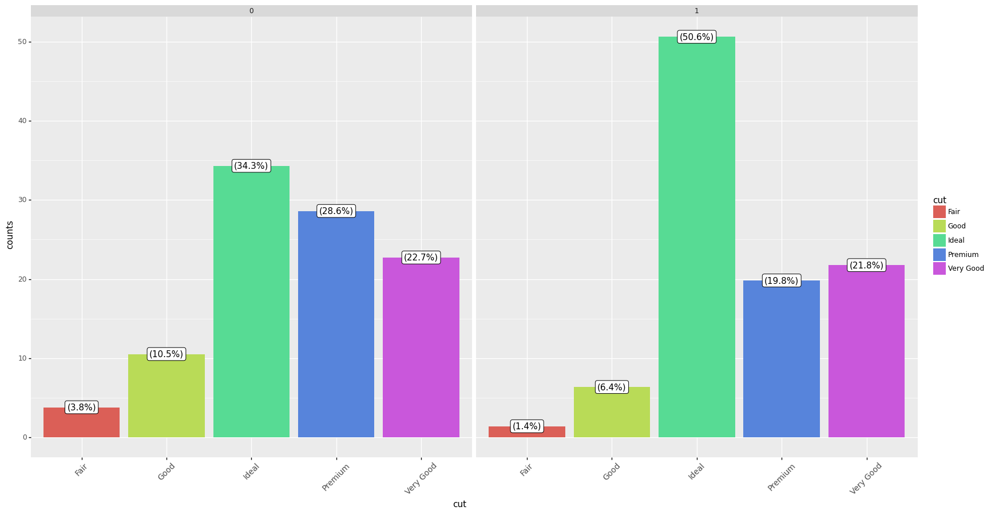

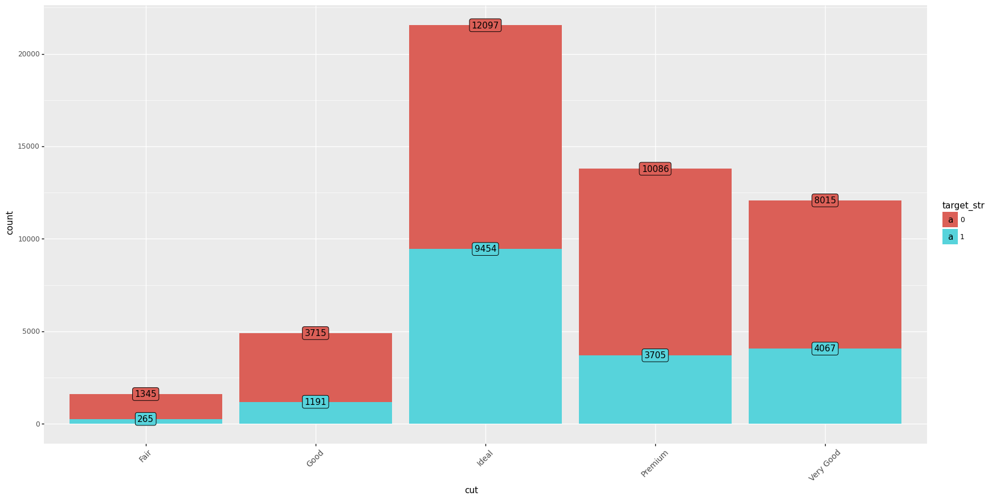

0.17

,cut,cut_woe
0,Ideal,0.389
1,Premium,-0.366
2,Good,-0.502
5,Very Good,-0.043
8,Fair,-0.986


In [7]:
var_x = 'cut'
var_y = 'target'

var_categorical_summary(data=data, var_x=var_x, var_y=var_y, normalize = 'index', x_angle = 45, x_text_size = 10)

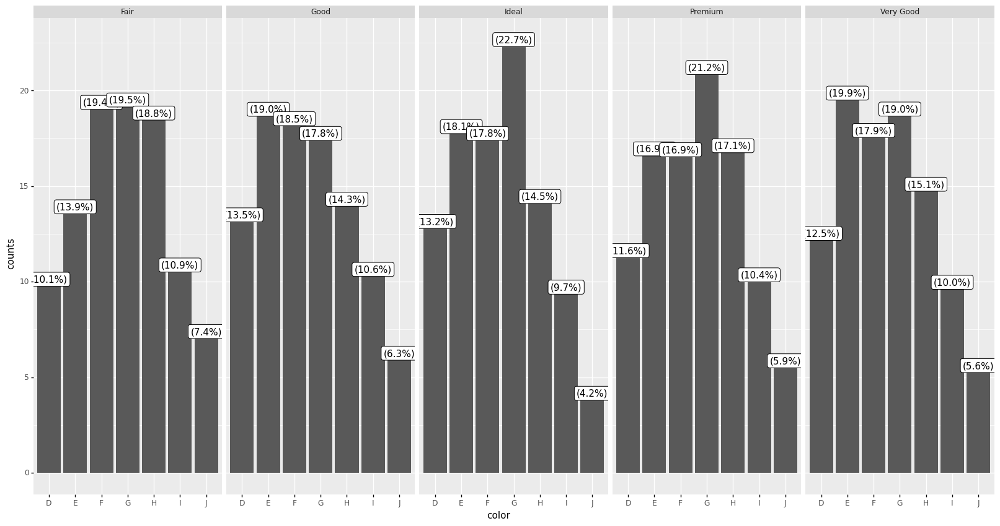

<ggplot: (-9223371890503983932)>

In [8]:


c = data.groupby(["cut","color"]).size()
c = c / c.groupby(level=[0]).transform("sum") * 100
c = c.reset_index(name='counts')
(ggplot(data=c) + geom_bar(aes(x='color', y='counts'), stat='identity') + geom_label(aes(x='color',y='counts', label = 'counts'), format_string='({:.1f}%)') + facet_grid('.~cut'))



braki danych: 0.0 %


,count,percent,c(Fair),c(Good),c(Ideal),c(Premium),c(Very Good),p(Fair),p(Good),p(Ideal),p(Premium),p(Very Good)
0,35258,65.400,1345,3715,12097,10086,8015,3.800,10.500,34.300,28.600,22.700
1,18682,34.600,265,1191,9454,3705,4067,1.400,6.400,50.600,19.800,21.800


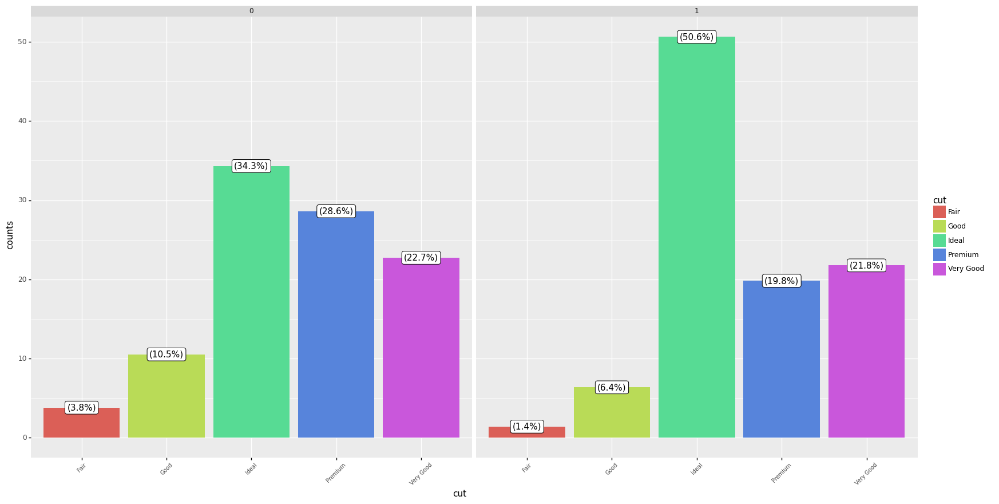

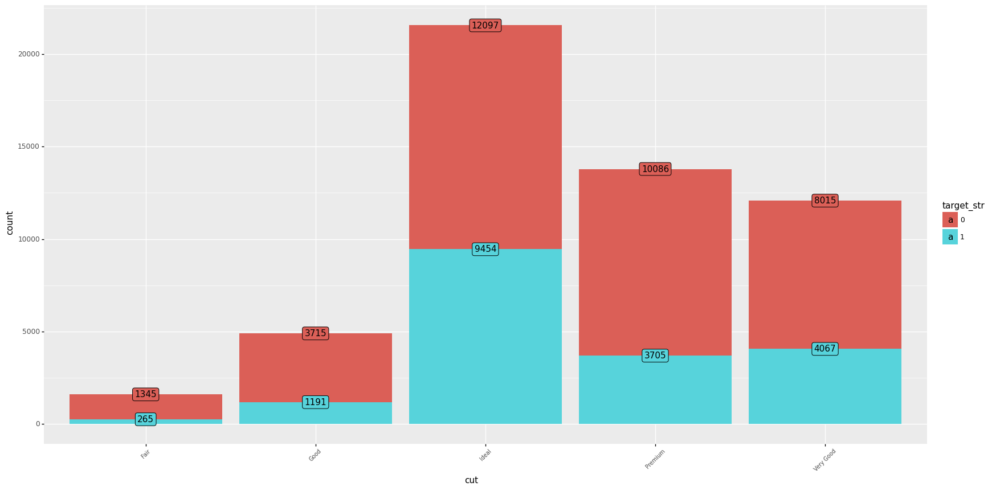

0.17

,cut,cut_woe
0,Ideal,0.389
1,Premium,-0.366
2,Good,-0.502
5,Very Good,-0.043
8,Fair,-0.986


In [9]:
var_x = 'cut'
var_y = 'target'

var_categorical_summary(data=data, var_x=var_x, var_y=var_y, normalize = 'index', x_angle = 45)

## Numerical

### LIST num filter

In [56]:
filters_num = {'price':[2000,3000], 'x':[None,10],'y':[50,None]}

### price

braki danych: 0.0 %


,min,q_05,q_10,q_25,q_50,q_75,q_90,q_95,max
0,326,544.000,646.000,950.000,2401.000,5324.250,9821.000,13107.100,18823


,min_,q_10,q_25,q_50,q_75,q_90,max_
cut,,,,,,,
Fair,337,1114,2050.250,3282.000,5205.500,9133.700,18574
Good,327,603,1145.000,3050.500,5028.000,8736.000,18788
Ideal,326,652,878.000,1810.000,4678.500,9077.000,18806
Premium,326,709,1046.000,3185.000,6296.000,11413.000,18823
Very Good,336,576,912.000,2648.000,5372.750,9680.900,18818


No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

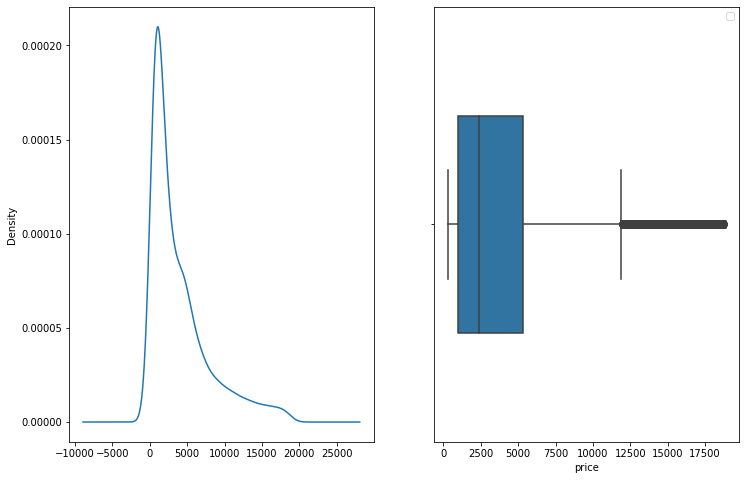

None

<Figure size 432x288 with 0 Axes>

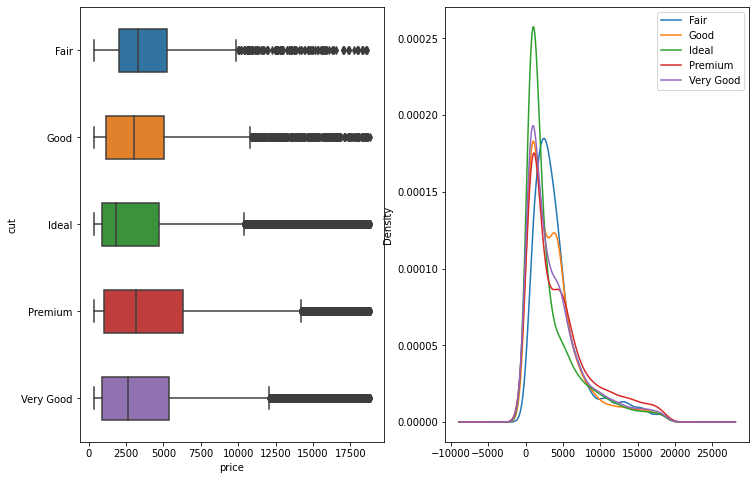

None

,price,target
price,1.000,-0.110
target,-0.110,1.000


,0
0_1,0.234


In [68]:
var_y = 'target'
var_x = 'price'
var_group = 'cut'

var_numerical_summary(data, var_x='price', var_y='target', var_group='cut', filters_num=None)

# Analysis - correlation between features

## Categorical

### V-cramer

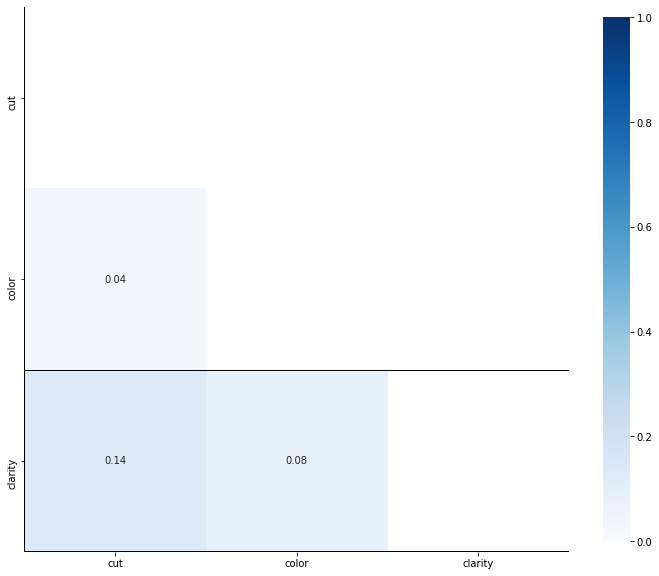

In [375]:
var_x_categorical = ['cut', 'color', 'clarity']

correlation_cramer_v_matrix(  data    = data
                            , vars    = var_x_categorical
                            , heatmap = True
                            , width   = 10
                            , height  = 10
                            , color_threshold = 0.75
                            , round   = 2)

### V-cramer grouped

In [181]:
correlation_v_cramer_grouped(data, var_main = 'z', var_other=['x','y'], var_group='target')

,category,x,y
0,0,0.37,0.37
0,1,0.36,0.35


## Numerical

### pearson

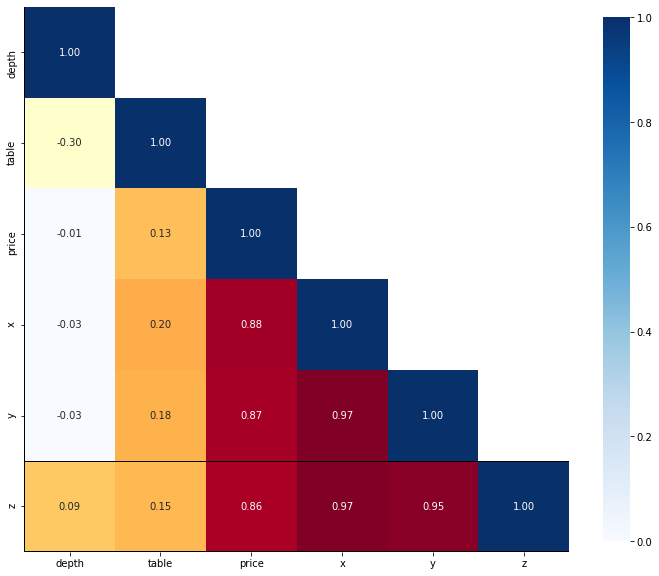

In [376]:
var_x_numeric = ['depth', 'table', 'price', 'x', 'y', 'z']

correlation_pearson(  data    = data
                    , vars    = var_x_numeric
                    , heatmap = True
                    , width   = 10
                    , height  = 10
                    , round   = 2)

In [173]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.graphics.mosaicplot import mosaic

In [2]:
import dabl

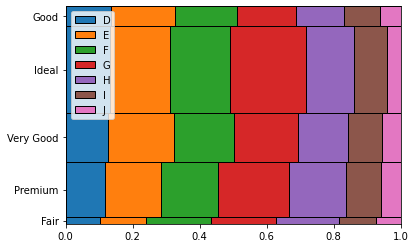

In [9]:

import matplotlib.pyplot as plt
from dabl.datasets import load_titanic
from dabl.plot import mosaic_plot



# Mosaic plot for frequencies of Titanic passengers grouped
# by gender and survival status

mosaic_plot(data, 'cut', 'color')
plt.show()


### pearson group

In [60]:
correlation_pearson_grouped(  data, var_main='x'
                            , var_other=['y','z']
                            , var_group='cut'
                            , method = 'pearson'
                            , round = 3)

,category,y,z
0,Fair,0.994,0.937
0,Good,0.998,0.967
0,Ideal,0.984,0.995
0,Premium,0.938,0.981
0,Very Good,0.999,0.927


### Correlation plot

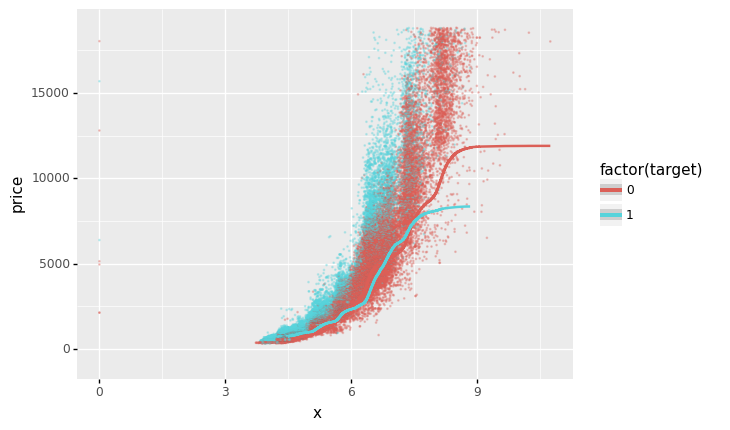

<ggplot: (-9223371890474858916)>

In [50]:
plotnine.options.figure_size = (6.4, 4.8)
(ggplot(data, aes(x='x', y='price', color = 'factor(target)')) +
        geom_point(alpha = 0.3, size = 0.1) +
        geom_smooth(se=True, method="mavg", ymin = None, ymax = None)
)

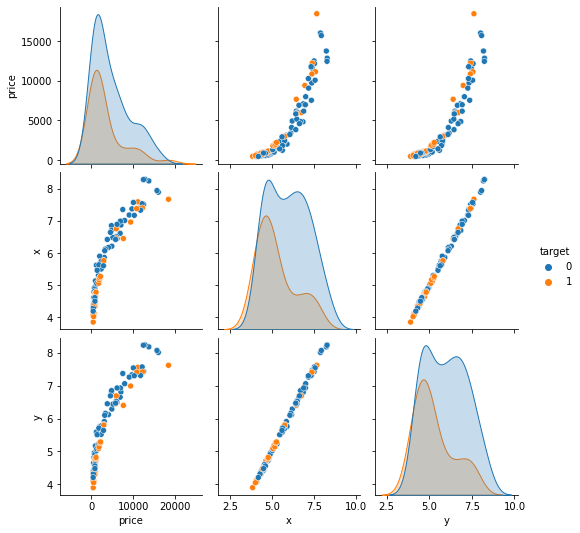

In [63]:
num_vars = ['price','x','target','y']
sns.pairplot(data[num_vars].sample(n=100), hue='target')

## Numerical vs categorical

### ratio

In [10]:
var_x_categorical = ['cut','color','clarity']
var_x_numeric     = ['price','table','depth','x','y','z']

correlation_ratio_matrix(  data     = data
                         , vars_cat = var_x_categorical
                         , vars_num = var_x_numeric
                         , heatmap  = False # currently function with 'True' does not work !
                         , width    = 10
                         , height   = 10
                         , round    = 2)

,price,table,depth,x,y,z
cut,0.11,0.57,0.35,0.19,0.17,0.19
color,0.18,0.06,0.05,0.28,0.28,0.28
clarity,0.16,0.16,0.10,0.38,0.37,0.38


### ratio grouped

In [332]:
correlation_ratio_grouped(data, var_main='x', var_other=['color','clarity','target'], var_group='cut', is_var_main_num = True, round = 4)

,category,color,clarity,target
0,Fair,0.30,0.37,0.22
0,Good,0.23,0.32,0.23
0,Ideal,0.28,0.38,0.26
0,Premium,0.30,0.35,0.24
0,Very Good,0.28,0.39,0.30


### swarm plot

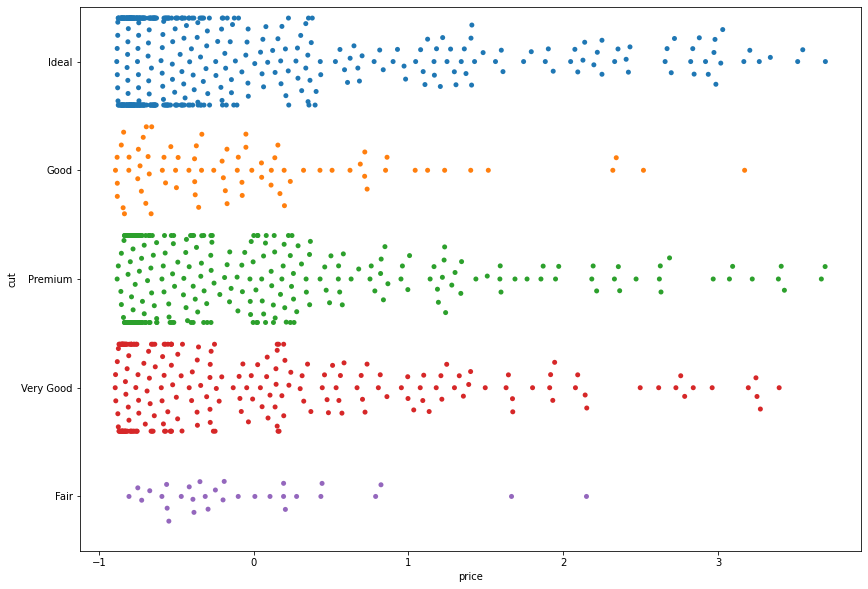

In [293]:
g = sns.swarmplot(y = "cut",
              x = 'price',
              data = data.sample(n=1000),
              size = 5) # Decrease the size of the points to avoid crowding
g.figure.set_size_inches(14,10)

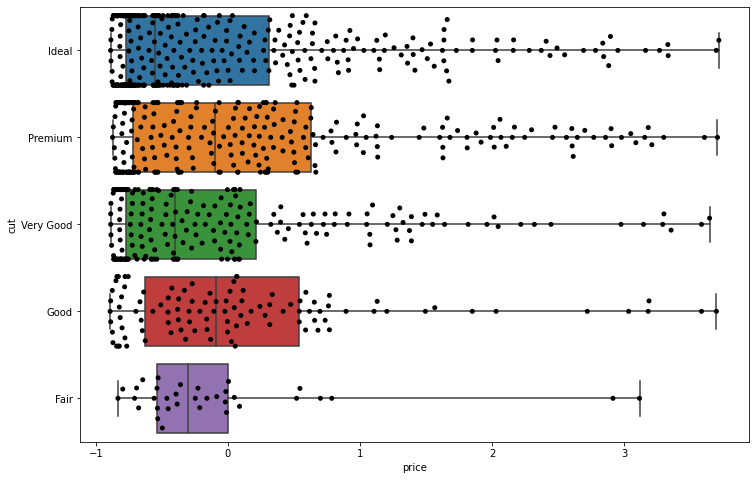

In [294]:
data_sampled = data.sample(n=1000)
num_var = 'price'
cat_vat = 'cut'

g = sns.boxplot(y = cat_vat ,
              x = num_var,
              data = data_sampled
             , whis=np.inf)
g = sns.swarmplot(y = cat_vat ,
              x = num_var,
              data = data_sampled,
              size = 5,color = 'black')
g.figure.set_size_inches(12,8)

## Parallel plot

### Numerical data

In [56]:
import plotly.express as px

# DataFrame of numeric variables
df = data[['price', 'x', 'y', 'z','target']]

# Create the chart:
fig = px.parallel_coordinates(
    df,
    color="target",
    color_continuous_midpoint=2)
fig.show()
#fig.update_layout(coloraxis_showscale=True)

### Categorical data

In [44]:
import plotly.express as px


df = data[['cut', 'color','target']]

fig = px.parallel_categories(df)

fig.show()

## Dimentionality reduction 

### Correspondence analysis for 2 variables

<AxesSubplot:title={'center':'Principal coordinates'}, xlabel='Component 0 (58.36% inertia)', ylabel='Component 1 (35.67% inertia)'>

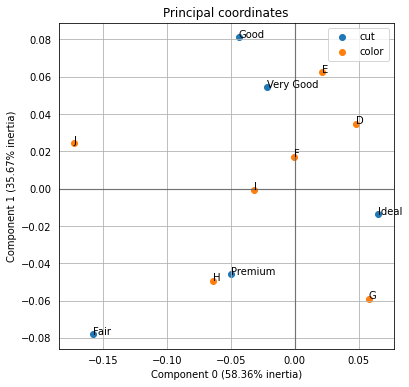

In [84]:
import prince

data_cat = data[['cut', 'color']]





ca = prince.CA(
     n_components = 2,
     n_iter = 3,
     copy = True,
     check_input = True,
     engine = 'auto',
     random_state = 42
)


cross_tab = pd.crosstab(data_cat['cut'], data_cat['color'])
ca = ca.fit(cross_tab)



ca.plot_coordinates(
     X=cross_tab,
     ax=None,
     figsize=(6, 6),
     x_component=0,
     y_component=1,
     show_row_labels=True,
     show_col_labels=True
)

### Correspondence analysis for many variables

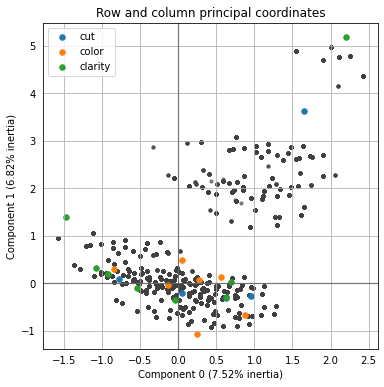

In [88]:
import prince

data_cat = data[['cut','color','clarity']]

mca = prince.MCA(
     n_components=2,
     n_iter=3,
     copy=True,
     check_input=True,
     engine='auto',
     random_state=42
)
mca = mca.fit(data_cat)


ax = mca.plot_coordinates(
     X=data_cat,
     ax=None,
     figsize=(6, 6),
     show_row_points=True,
     row_points_size=10,
     show_row_labels=False,
     show_column_points=True,
     column_points_size=30,
     show_column_labels=False,
     legend_n_cols=1
)

# Analysis - correlation between target and features

## Feature importance (catboost)

In [13]:
vax_y = 'target'
var_x = ['cut', 'color', 'clarity', 'x', 'y', 'z', 'price', 'table']
var_x_categorical = ['cut', 'color', 'clarity']

train_x = data[var_x]
train_y = data[var_y]


feature_importance_class_CB( iterations     = 30
                            , learning_rate = 0.1
                            , depth         = 5
                            , cat_features  = var_x_categorical
                            , x_train       = train_x
                            , y_train       = train_y)



You should provide test set for use best model. use_best_model parameter has been switched to false value.


,Feature Id,Importances
0,clarity,99.898
1,z,0.026
2,price,0.024
3,table,0.020
4,y,0.016
5,x,0.015
6,cut,0.000
7,color,0.000


# Outliers

## Isolation Forest

In [14]:
# categorical variables target encoding
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)

outlieres_IF(  n_estimators = 20
             , x_train = data_recoded[['price','x','cut','clarity','color']])

,carat,cut,color,clarity,depth,table,price,x,y,z,target,target_multi_label,cut_new_encoding,anomaly
0,0.23,0.439,0.315,0.0,61.5,55.0,326,3.95,3.98,2.43,0,0,0,1
1,0.21,0.269,0.315,0.0,59.8,61.0,326,3.89,3.84,2.31,0,1,1,-1
2,0.23,0.243,0.315,1.0,56.9,65.0,327,4.05,4.07,2.31,1,2,2,-1
3,0.29,0.269,0.337,0.0,62.4,58.0,334,4.20,4.23,2.63,0,1,1,1
4,0.31,0.243,0.284,0.0,63.3,58.0,335,4.34,4.35,2.75,0,2,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53935,0.72,0.439,0.234,0.0,60.8,57.0,2757,5.75,5.76,3.50,0,0,0,1
53936,0.72,0.243,0.234,0.0,63.1,55.0,2757,5.69,5.75,3.61,0,2,2,1
53937,0.70,0.337,0.234,0.0,62.8,60.0,2757,5.66,5.68,3.56,0,3,3,1
53938,0.86,0.269,0.320,0.0,61.0,58.0,2757,6.15,6.12,3.74,0,1,1,1


## COPOD  (Copula Based Outlier Detector)

COPOD(contamination=0.1)

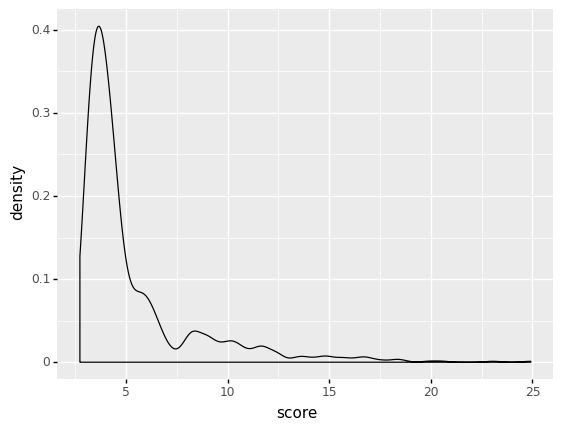

<ggplot: (-9223371897838046656)>

In [295]:
# https://towardsdatascience.com/anomaly-detection-for-dummies-15f148e559c1
# https://h1ros.github.io/posts/anomaly-detection-by-auto-encoder-deep-learning-in-pyod/

from pyod.models.copod import COPOD

clf_name = 'COPOD'
percentage_of_outlieres = 0.1
clf = COPOD(contamination = percentage_of_outlieres)

num_vars = ['price', 'x', 'y', 'z']

x_train = data.iloc[1:1000,:][num_vars]
x_test = data.iloc[1000:2000,:][num_vars]

clf.fit(x_train)

# get the prediction labels and outlier scores of the training data
y_train_pred = clf.labels_  # binary labels (0: inliers, 1: outliers)
y_train_scores = clf.decision_scores_  # raw outlier scores

outliers = pd.DataFrame({'if_outlier':y_train_pred, 'score':y_train_scores})

(ggplot(outliers) + geom_density(aes(x='score')))

# Missing Values

<AxesSubplot:>

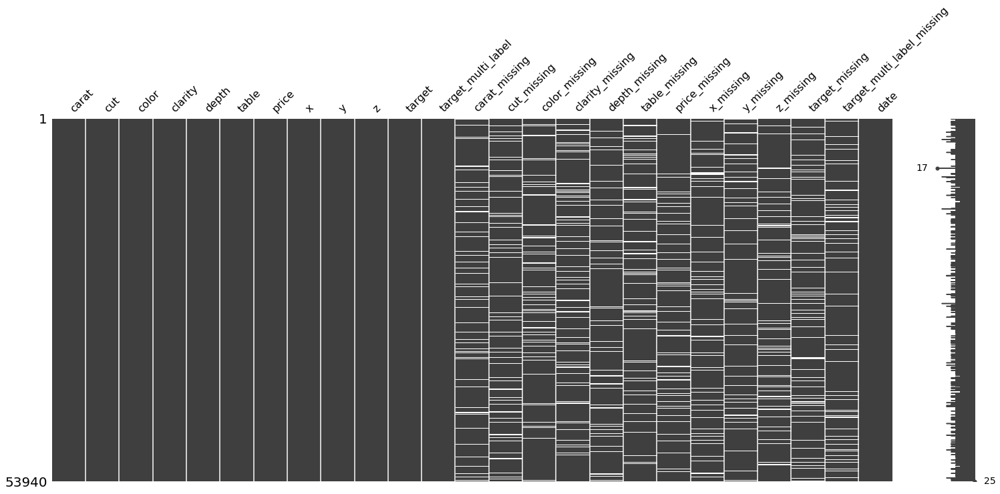

In [97]:
import missingno as msno

msno.matrix(data)

## Univariate

In [117]:
from sklearn.compose import ColumnTransformer
# numeric variables
num_vars = ['x_missing','y_missing']

# categorical variables
cat_vars = ['cut_missing','color_missing']

# imputer for numeric variables
imp_num = SimpleImputer(missing_values=np.nan, strategy='mean') # other stategies: median

# imputer for categorical variables
imp_cat = SimpleImputer(missing_values=np.nan, strategy='most_frequent')

# creating transformer
ct = ColumnTransformer(transformers = [('num', imp_num, num_vars), ('cat', imp_cat, cat_vars)])

# fitting data
data[num_vars + cat_vars] = ct.fit_transform(data[num_vars + cat_vars])



## Multivatiate

In [138]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

num_vars = ['price_missing','x_missing', 'y_missing']

imp = IterativeImputer(max_iter=10, random_state=0) # currently works only for numerical data 

imp.fit(data[num_vars])

data[num_vars] = imp.transform(data[num_vars])


IterativeImputer(random_state=0)

In [170]:
# https://medium.com/@kyawsawhtoon/a-guide-to-knn-imputation-95e2dc496e
from sklearn.preprocessing import StandardScaler

num_vars = ['price_missing','x_missing', 'y_missing']

scaler_x_mean_std = StandardScaler()

ct = ColumnTransformer(transformers = [('scaler', scaler_x_mean_std, num_vars)])
ct.fit(data[num_vars])
data[num_vars] = ct.transform(data[num_vars])


ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                 ['price_missing', 'x_missing', 'y_missing'])])

# IML

## Shapley

  0%|          | 0/100 [00:00<?, ?it/s]

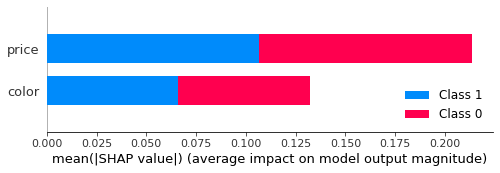

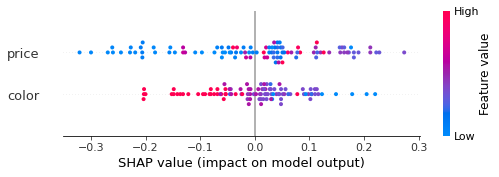

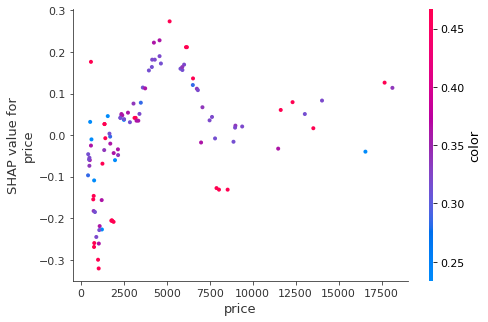

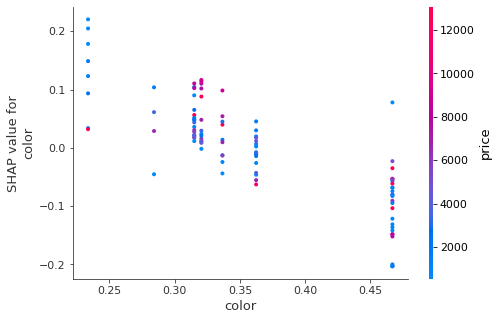

In [113]:
# categorical variables target encoding
shap.initjs()
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)


x_train = data_recoded[['price', 'color']]
y_train = data_recoded['target']

sample_size = 1000
model = RandomForestClassifier(  max_depth    = 6
                               , random_state = 0
                               , n_estimators = 10)
  

shapley_value(  model       = model
              , x_train     = x_train
              , y_train     = y_train
              , sample_size = 100)


## Partial Dependence Plot

### numerical variables

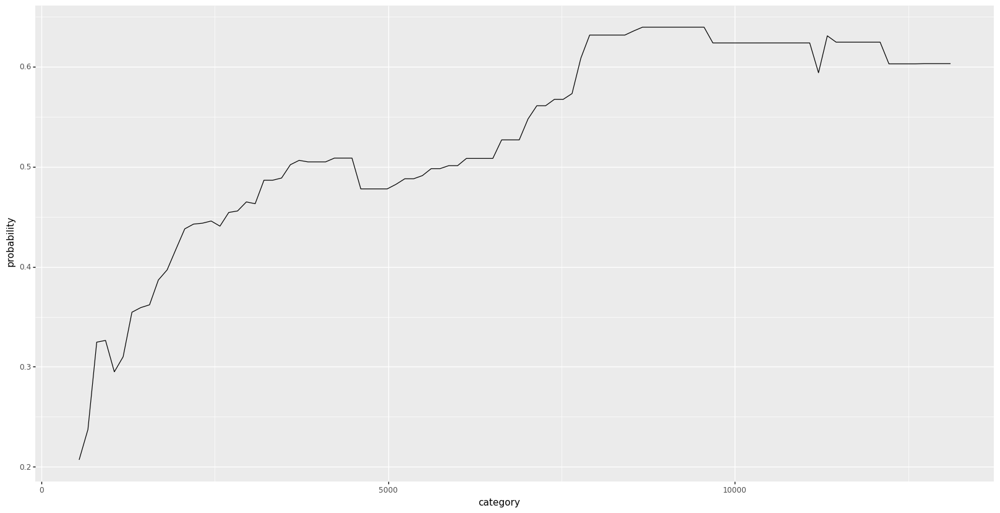

<ggplot: (114428081044)>

In [70]:
x_train = data_recoded[['price', 'x', 'y']]
y_train = data_recoded['target']
model = RandomForestClassifier(  max_depth = 6
                               , random_state = 0
                               , n_estimators = 10)
var = 'price'


PDP_plot_RF(  model   = model
            , x_train = x_train
            , y_train = y_train
            , var     = var)



### categorical variables

In [21]:

def PDP_plot_RF(model, x_train, y_train, var, labels = None):
    """
    Purpose:
    Partial Dependence Plot base on RandomForest
    """
    var_index = x_train.columns.get_loc(var)
    
    from sklearn.inspection import plot_partial_dependence
    from sklearn.inspection import partial_dependence
    
    model.fit(x_train, y_train)

    t1 = model.predict_proba(X=x_train)

    pdp, axes = partial_dependence(model, x_train, features = [var_index])

    pdp_df = pd.DataFrame({'probability':pdp[0], 'category':axes[0]})

    if labels is not None:
        pdp_df = pd.merge(pdp_df, labels, left_on = 'category', right_on='encoded_value')
        pdp_df = pdp_df.rename(columns = {'category_y':'category'})
        pdp_df = pdp_df.drop(columns='category_x')
    if labels is None:
        display(ggplot(pdp_df) + geom_line(aes(x='category', y='probability')))
    else:
        display(ggplot(pdp_df) + geom_line(aes(x='category', y='probability', group=1)))





'\nPurpose:\nPartial Dependence Plot base on RandomForest\n'

RandomForestClassifier(max_depth=6, n_estimators=10, random_state=0)

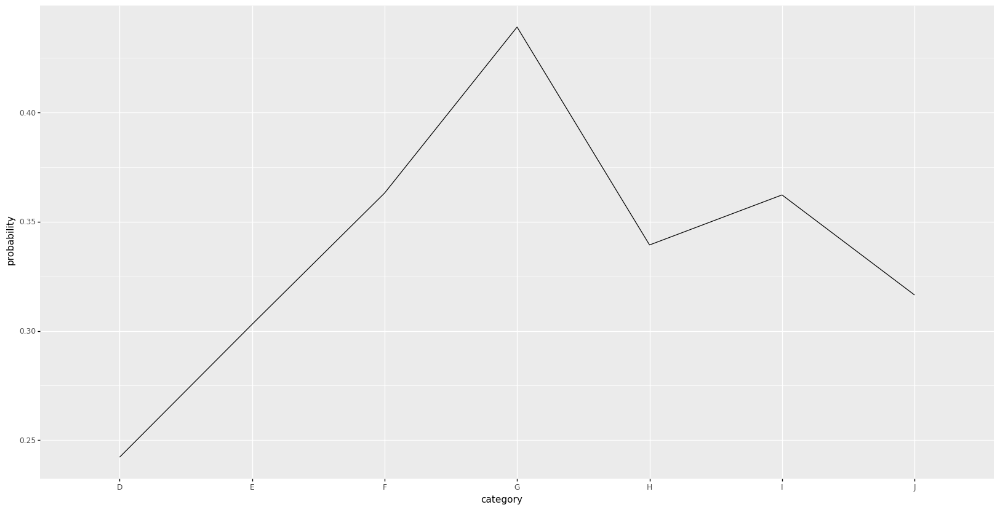

<ggplot: (154078494666)>

In [40]:

data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)

x_train = data_recoded[['price', 'color']]
y_train = data_recoded['target']
model = RandomForestClassifier(  max_depth = 6
                               , random_state = 0
                               , n_estimators = 10)
var = 'color'

labels = pd.concat([data_recoded['color'], data['color']], axis = 1).drop_duplicates()
labels.columns = ['encoded_value','category']



#####

"""
Purpose:
Partial Dependence Plot base on RandomForest
"""
var_index = x_train.columns.get_loc(var)

from sklearn.inspection import plot_partial_dependence
from sklearn.inspection import partial_dependence

model.fit(x_train, y_train)

t1 = model.predict_proba(X=x_train)

pdp, axes = partial_dependence(model, x_train, features = [var_index])

pdp_df = pd.DataFrame({'probability':pdp[0], 'category':axes[0]})

pdp_df = pd.merge(pdp_df, labels, left_on = 'category', right_on='encoded_value')
pdp_df = pdp_df.rename(columns = {'category_y':'category'})
pdp_df = pdp_df.drop(columns='category_x')

(ggplot(pdp_df) + geom_line(aes(x='category', y='probability', group=1)))

In [32]:
pdp_df

,probability,category_x,encoded_value,category_y
0,0.242,0.234,0.234,D
1,0.316,0.284,0.284,J
2,0.303,0.315,0.315,E
3,0.339,0.320,0.320,H
4,0.362,0.337,0.337,I
5,0.363,0.362,0.362,F
6,0.439,0.467,0.467,G


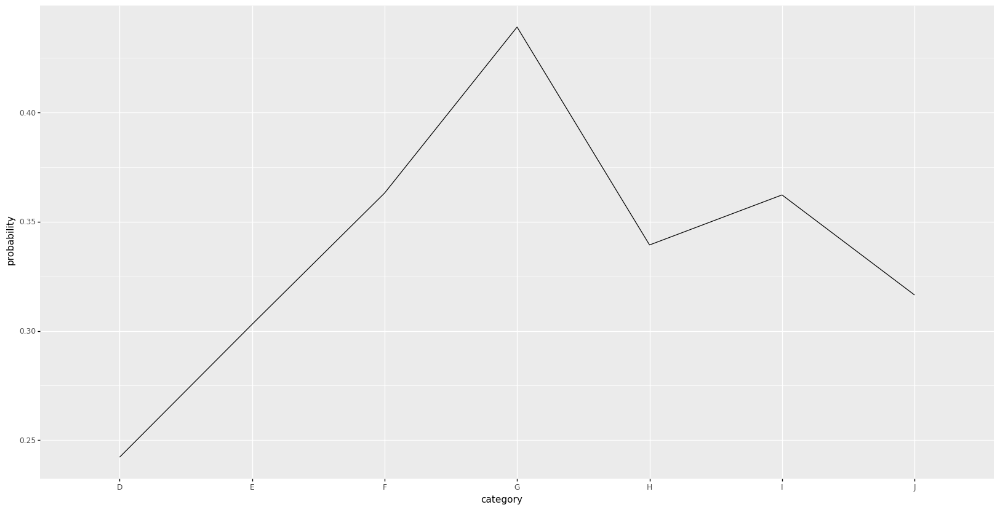

<ggplot: (154076551048)>

In [22]:
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)

x_train = data_recoded[['price', 'color']]
y_train = data_recoded['target']
model = RandomForestClassifier(  max_depth = 6
                               , random_state = 0
                               , n_estimators = 10)
var = 'color'

labels = pd.concat([data_recoded['color'], data['color']], axis = 1).drop_duplicates()
labels.columns = ['encoded_value','category']

PDP_plot_RF(  model   = model
            , x_train = x_train
            , y_train = y_train
            , var     = var
            , labels  = labels)



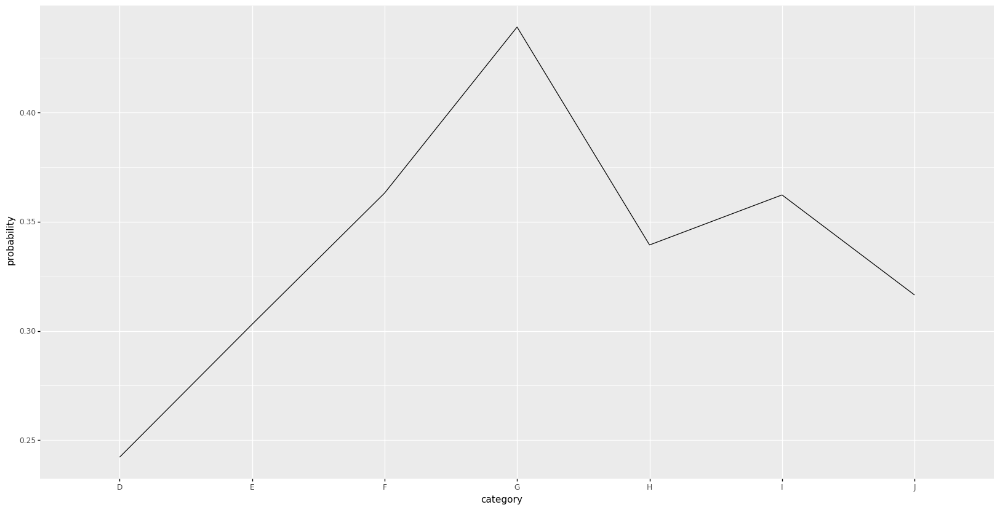

<ggplot: (114429732970)>

In [71]:
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)

x_train = data_recoded[['price', 'color']]
y_train = data_recoded['target']
model = RandomForestClassifier(  max_depth = 6
                               , random_state = 0
                               , n_estimators = 10)
var = 'color'

labels = pd.concat([data_recoded['color'], data['color']], axis = 1).drop_duplicates()
labels.columns = ['encoded_value','category']

PDP_plot_RF(  model   = model
            , x_train = x_train
            , y_train = y_train
            , var     = var
            , labels  = labels)



In [44]:
pdp_df

,probability,category
0,0.242,0.234
1,0.316,0.284
2,0.303,0.315
3,0.339,0.320
4,0.362,0.337
5,0.363,0.362
6,0.439,0.467


In [46]:
labels

,encoded_value,category
0,0.315,E
3,0.337,I
4,0.284,J
7,0.320,H
12,0.362,F
25,0.467,G
28,0.234,D


In [48]:
var_index = x_train.columns.get_loc(var)

from sklearn.inspection import plot_partial_dependence
from sklearn.inspection import partial_dependence

model.fit(x_train, y_train)

t1 = model.predict_proba(X=x_train)

pdp, axes = partial_dependence(model, x_train, features = [var_index])

pdp_df = pd.DataFrame({'probability':pdp[0], 'category':axes[0]})



RandomForestClassifier(max_depth=6, n_estimators=10, random_state=0)

In [49]:
pdp_df 

,probability,category
0,0.242,0.234
1,0.316,0.284
2,0.303,0.315
3,0.339,0.320
4,0.362,0.337
5,0.363,0.362
6,0.439,0.467


In [50]:
labels

,encoded_value,category
0,0.315,E
3,0.337,I
4,0.284,J
7,0.320,H
12,0.362,F
25,0.467,G
28,0.234,D


,probability,encoded_value,category
0,0.242,0.234,D
1,0.316,0.284,J
2,0.303,0.315,E
3,0.339,0.320,H
4,0.362,0.337,I
5,0.363,0.362,F
6,0.439,0.467,G


## ICE

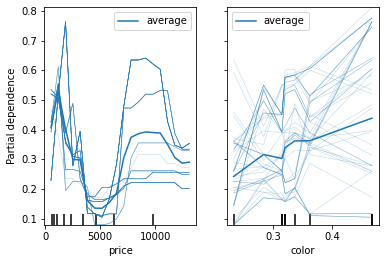

In [104]:
plot_partial_dependence(
       model, x_train, ['price','color'], kind="both", subsample=50,
       n_jobs=3, grid_resolution=20, random_state=0
)

# Model - BINARY target

## train valide test

In [383]:
# sampled (only train and valid)
data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1 = data1.sample(frac = 1)
data1 = data1.reset_index(drop=True)

# splitting data set into train and test
data_x_train, data_x_test, data_y_train, data_y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

In [15]:
# sampled (train, valid (I call it test for algoritm internall structure) and test (real test data) )
(data_x_train, data_y_train), (data_x_test, data_y_test), (data_x_rtest, data_y_rtest) = train_test_val_split(  data.drop(columns=var_y)
                                                                                                          , data[var_y]
                                                                                                          , split=(0.2, 0.1) # valid and test size. train size = 1-(valid_size+test_size)
                                                                                                          , shuffle=True)    # random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)

In [111]:
# by date
date_var = 'date'

data_x_train = data.loc[data[date_var] <= pd.Timestamp(2020,1,1)].drop(columns=var_y) 
data_y_train = data.loc[data[date_var] <= pd.Timestamp(2020,1,1), var_y]

data_x_test = data.loc[(data[date_var] > pd.Timestamp(2020,1,1)) & (data[date_var] <= pd.Timestamp(2020,1,2))].drop(columns=var_y) 
data_y_test = data.loc[(data[date_var] > pd.Timestamp(2020,1,1)) & (data[date_var] <= pd.Timestamp(2020,1,2)), var_y]

data_x_rtest = data.loc[(data[date_var] > pd.Timestamp(2020,1,2))].drop(columns=var_y) 
data_y_rtest = data.loc[(data[date_var] > pd.Timestamp(2020,1,2)), var_y]


## Model 1

### Variables and data sets

In [16]:
# variables
y_var     = [var_y]                   # target
x_var_num = ['price', 'x', 'y', 'z']  # numerical features
x_var_cat = ['color','cut']           # categorical features
x_var     = x_var_num + x_var_cat     # all features


train_set = pd.concat([data_x_train[x_var], data_y_train], axis = 1)
test_set  = pd.concat([data_x_test[x_var],  data_y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)


### Learning and performance

(37757, 7)
(14564, 7)


You should provide test set for use best model. use_best_model parameter has been switched to false value.


,simulation_name,description,x_n,y_name,y_labels,x_num,x_cat,cat_encoding,balancing,calibration,simulation_start,simulation_end,pos_label,priori,threshold,performance start,performance end,threshold_priori_id
0,symulacja_1,pierwszy model na wszyskich zmiennych,5,target,"0, 1","price, x, y, z",color,target,under,None,2021-06-23 22:46:20,2021-06-23 22:46:58,1,NaN,NaN,2021-06-23 22:47:30,2021-06-23 22:48:03,p2


,price,x,y,z,color
price,1.000,0.880,0.880,0.860,0.030
x,0.880,1.000,0.990,0.970,0.000
y,0.880,0.990,1.000,0.960,0.000
z,0.860,0.970,0.960,1.000,-0.000
color,0.030,0.000,0.000,-0.000,1.000
,price,x,y,z,color
price,1.000,0.830,0.830,0.820,0.030
x,0.830,1.000,0.970,0.910,0.020
y,0.830,0.970,1.000,0.910,0.020
z,0.820,0.910,0.910,1.000,0.020


None

,index,target,proc
0,0,24580,65.100
1,1,13177,34.900
,index,target,proc
0,0,9603,65.940
1,1,4961,34.060


,0,1,_sum_,_correctness_
0,0,13177,13177,0
1,0,13177,13177,100
_sum_,0,26354,0,0
_correctness_,0,50,0,0
,0,1,_sum_,_correctness_
0,0,13177,13177,0
1,0,13177,13177,100
_sum_,0,26354,0,0
_correctness_,0,50,0,0
,0,1,_sum_,_correctness_


,0,1,_sum_,_correctness_
0,0,9603,9603,0
1,0,4961,4961,100
_sum_,0,14564,0,0
_correctness_,0,34,0,0
,0,1,_sum_,_correctness_
0,0,9603,9603,0
1,0,4961,4961,100
_sum_,0,14564,0,0
_correctness_,0,34,0,0
,0,1,_sum_,_correctness_


,Feature,Importance,Importance_abs,l1
0,x,-3.100,3.100,0.1
1,price,1.670,1.670,0.1
2,y,1.650,1.650,0.1
3,z,-0.800,0.800,0.1
4,color,0.460,0.460,0.1
5,NOISE_uniform,0.000,0.000,0.1
6,NOISE_normal,0.000,0.000,0.1
7,x,-3.470,3.470,0.5
8,y,1.790,1.790,0.5
9,price,1.750,1.750,0.5


[None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

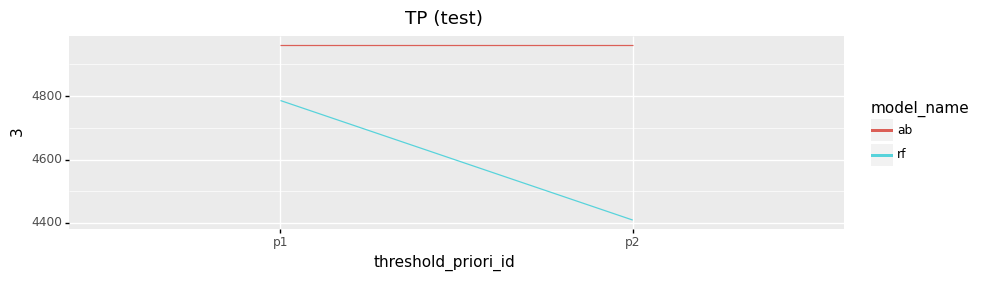

<ggplot: (-9223371863931336864)>

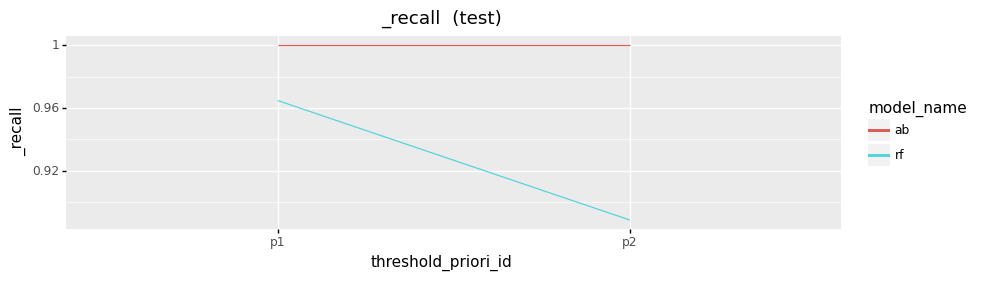

<ggplot: (-9223371863927627460)>

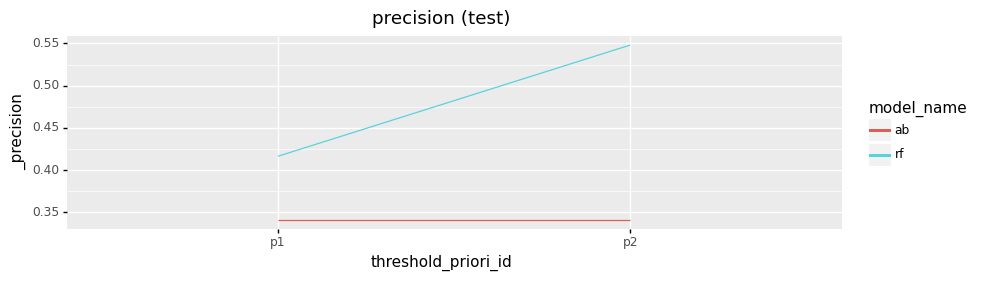

<ggplot: (-9223371863927639500)>

,model_name,set_type,threshold_priori_id,0,1,2,3,_accuracy,_balanced_accuracy,_f1,_precision,_recall
0,ab,test,p1,0,9603,0,4961,0.341,0.500,0.508,0.341,1.000
1,ab,train,p1,0,13177,0,13177,0.500,0.500,0.667,0.500,1.000
2,rf,test,p1,2892,6711,175,4786,0.527,0.633,0.582,0.416,0.965
3,rf,train,p1,4011,9166,407,12770,0.637,0.637,0.727,0.582,0.969
4,ab,test,p2,0,9603,0,4961,0.341,0.500,0.508,0.341,1.000
5,ab,train,p2,0,13177,0,13177,0.500,0.500,0.667,0.500,1.000
6,rf,test,p2,5968,3635,552,4409,0.713,0.755,0.678,0.548,0.889
7,rf,train,p2,8351,4826,1321,11856,0.767,0.767,0.794,0.711,0.900


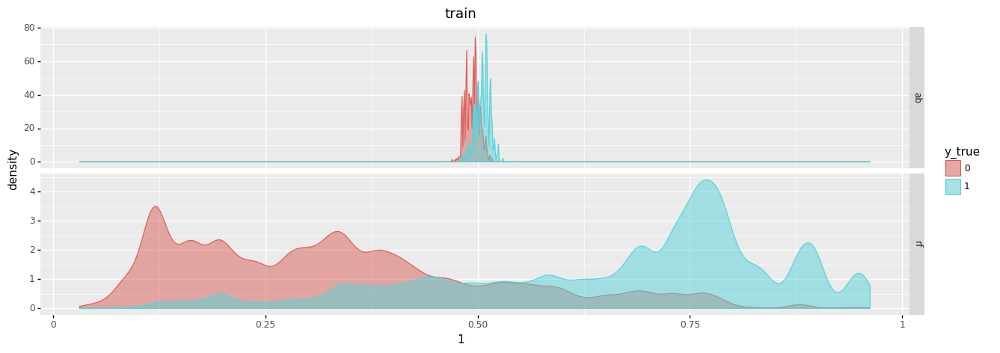

<ggplot: (-9223371863927661560)>

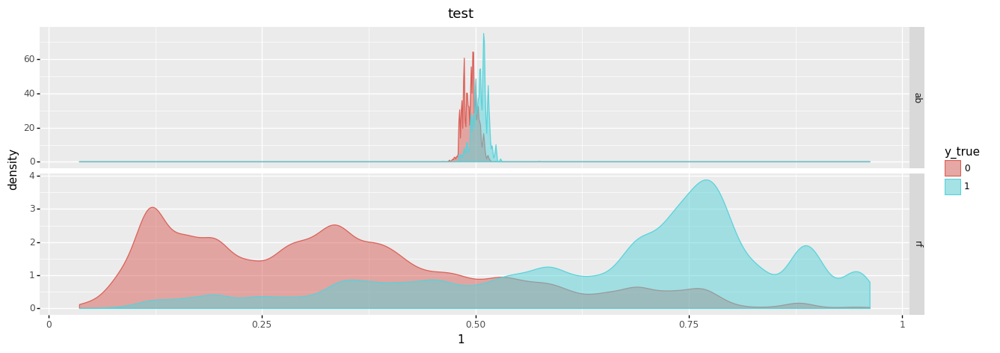

<ggplot: (-9223371863927664372)>

None

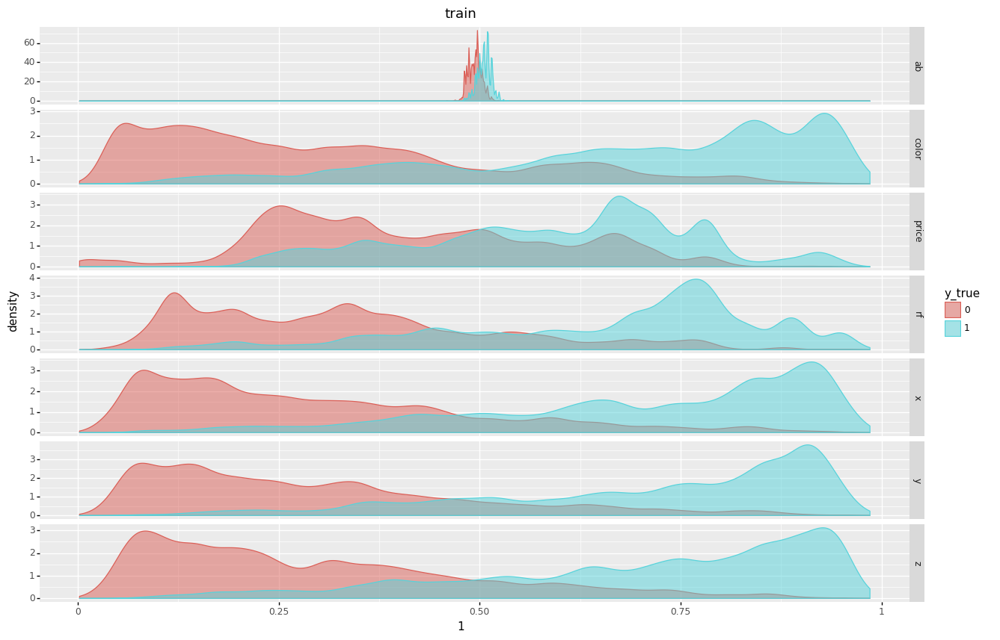

<ggplot: (-9223371863928811224)>

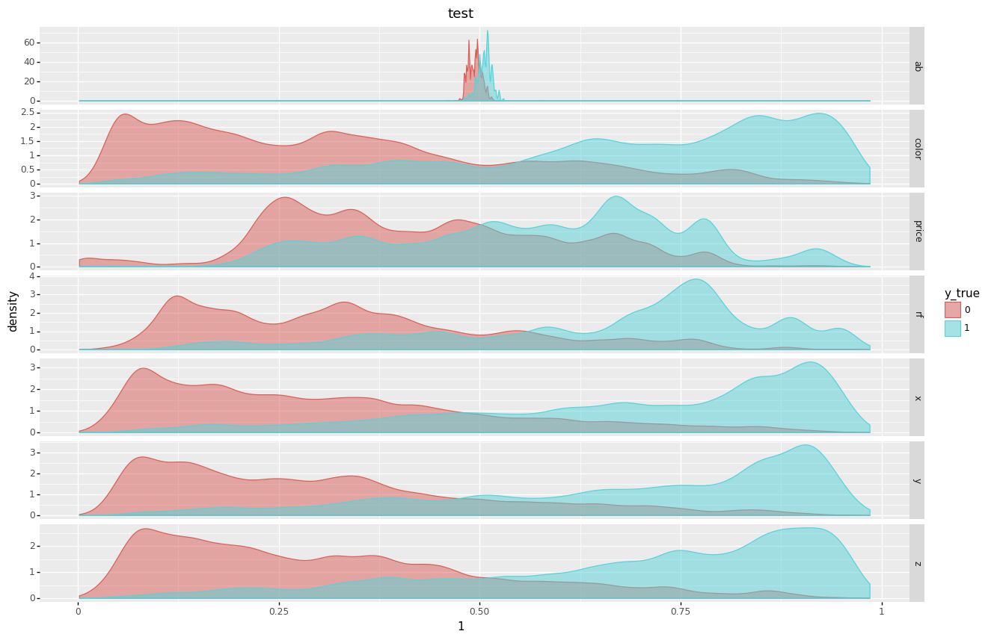

<ggplot: (-9223371863928814580)>

None

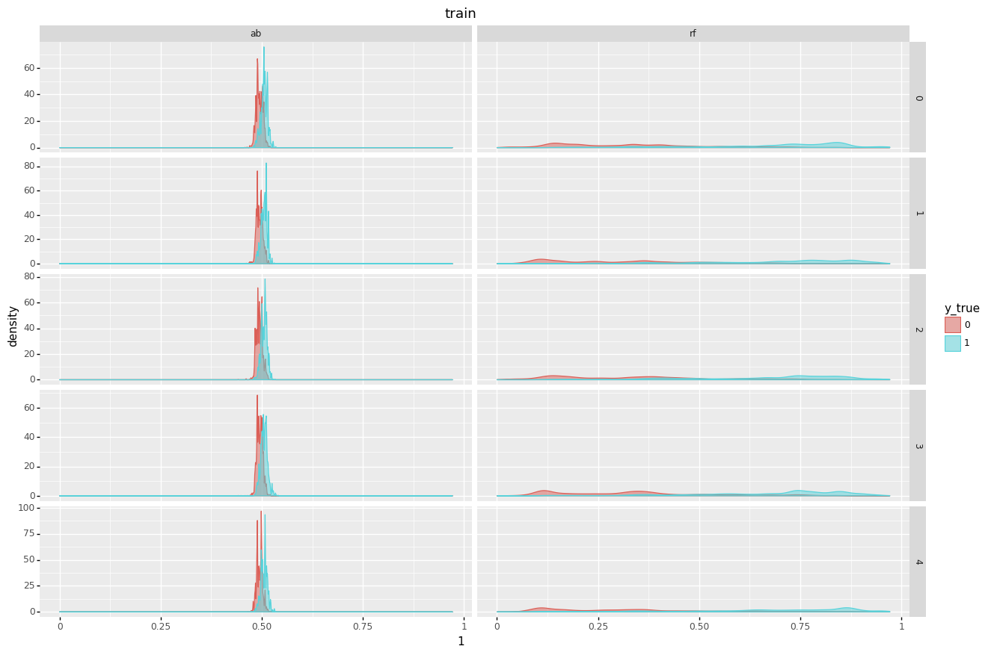

<ggplot: (-9223371863931117836)>

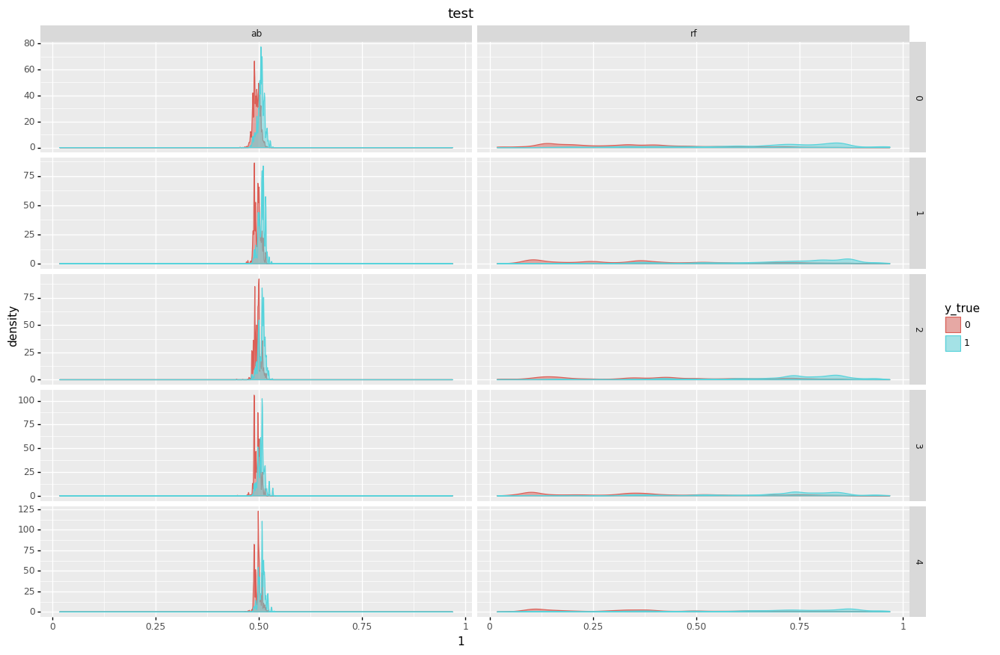

<ggplot: (-9223371863925275424)>

None

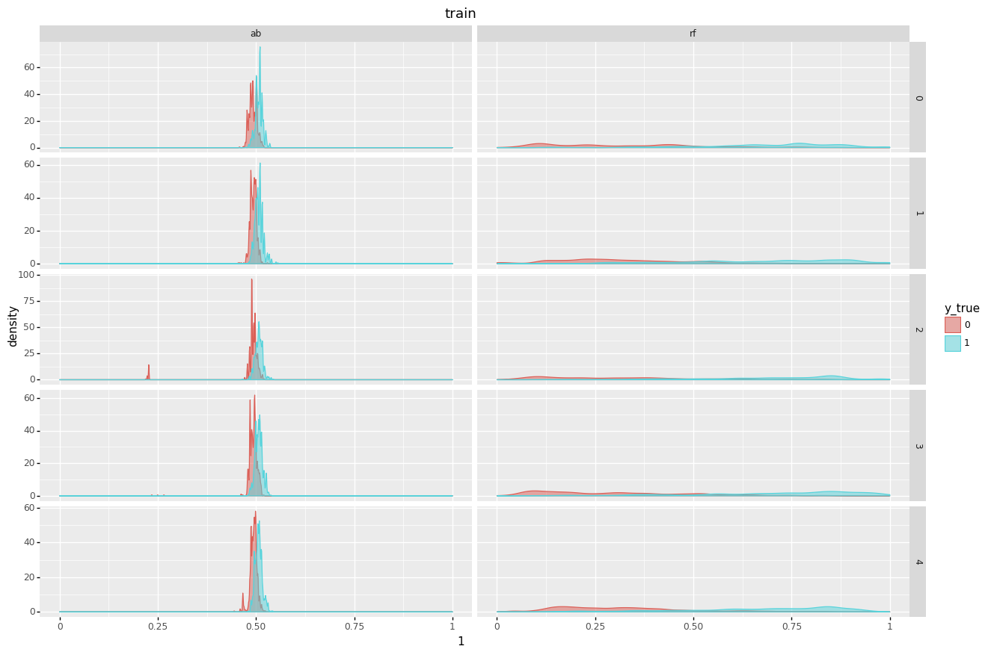

<ggplot: (-9223371863918076432)>

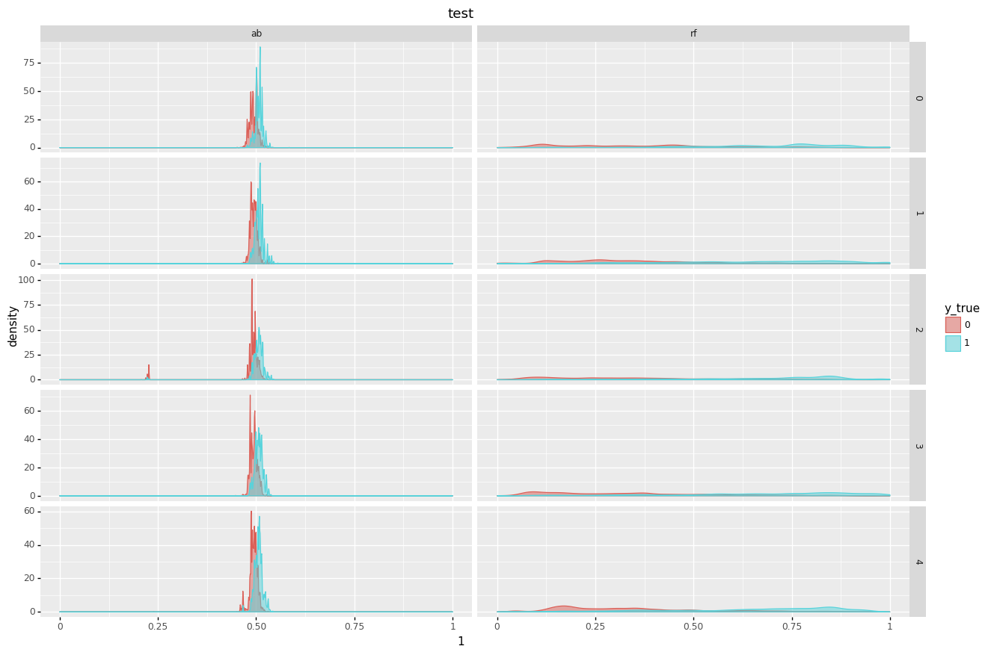

<ggplot: (-9223371863918070284)>

None

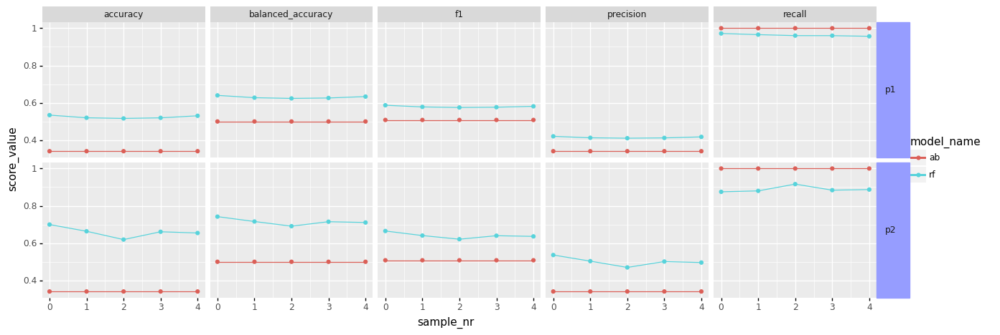

<ggplot: (-9223371863930994440)>

None

,model_name,set_type,sample_type,threshold_priori_id,score_name,max,min,mean,std
0,ab,test,cv,p1,accuracy,0.341,0.341,0.341,0.000
1,ab,test,cv,p1,balanced_accuracy,0.500,0.500,0.500,0.000
2,ab,test,cv,p1,f1,0.508,0.508,0.508,0.000
3,ab,test,cv,p1,precision,0.341,0.341,0.341,0.000
4,ab,test,cv,p1,recall,1.000,1.000,1.000,0.000
5,ab,test,cv,p2,accuracy,0.341,0.341,0.341,0.000
6,ab,test,cv,p2,balanced_accuracy,0.500,0.500,0.500,0.000
7,ab,test,cv,p2,f1,0.508,0.508,0.508,0.000
8,ab,test,cv,p2,precision,0.341,0.341,0.341,0.000
9,ab,test,cv,p2,recall,1.000,1.000,1.000,0.000


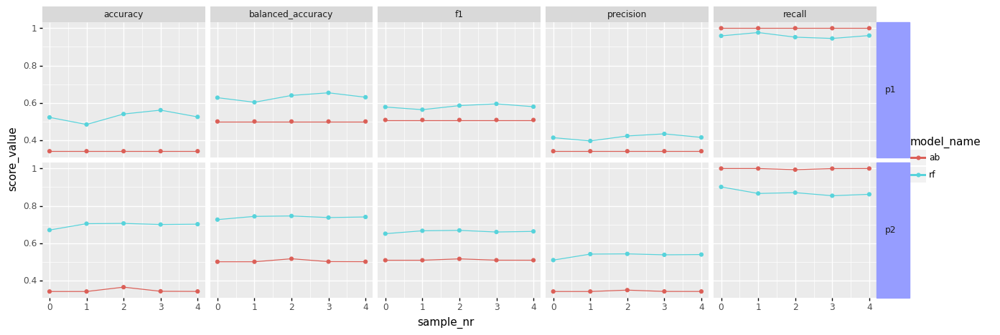

<ggplot: (-9223371863918073324)>

None

,model_name,set_type,sample_type,threshold_priori_id,score_name,max,min,mean,std
0,ab,test,hold,p1,accuracy,0.341,0.341,0.341,0.000
1,ab,test,hold,p1,balanced_accuracy,0.500,0.500,0.500,0.000
2,ab,test,hold,p1,f1,0.508,0.508,0.508,0.000
3,ab,test,hold,p1,precision,0.341,0.341,0.341,0.000
4,ab,test,hold,p1,recall,1.000,1.000,1.000,0.000
5,ab,test,hold,p2,accuracy,0.364,0.341,0.346,0.009
6,ab,test,hold,p2,balanced_accuracy,0.516,0.500,0.503,0.006
7,ab,test,hold,p2,f1,0.516,0.508,0.510,0.003
8,ab,test,hold,p2,precision,0.348,0.341,0.342,0.003
9,ab,test,hold,p2,recall,1.000,0.994,0.999,0.002


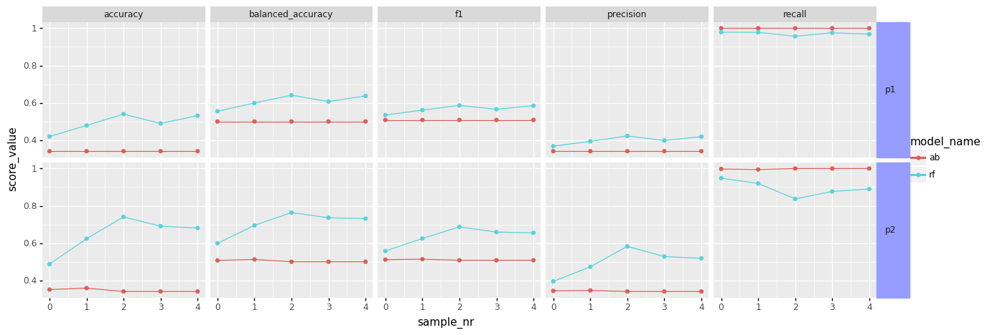

<ggplot: (-9223371863925261780)>

None

,model_name,set_type,sample_type,threshold_priori_id,score_name,max,min,mean,std
0,ab,test,by_var,p1,accuracy,0.341,0.341,0.341,0.000
1,ab,test,by_var,p1,balanced_accuracy,0.500,0.500,0.500,0.000
2,ab,test,by_var,p1,f1,0.508,0.508,0.508,0.000
3,ab,test,by_var,p1,precision,0.341,0.341,0.341,0.000
4,ab,test,by_var,p1,recall,1.000,1.000,1.000,0.000
5,ab,test,by_var,p2,accuracy,0.359,0.341,0.346,0.007
6,ab,test,by_var,p2,balanced_accuracy,0.512,0.500,0.504,0.005
7,ab,test,by_var,p2,f1,0.514,0.508,0.510,0.002
8,ab,test,by_var,p2,precision,0.346,0.341,0.342,0.002
9,ab,test,by_var,p2,recall,1.000,0.995,0.998,0.002


rf
ab


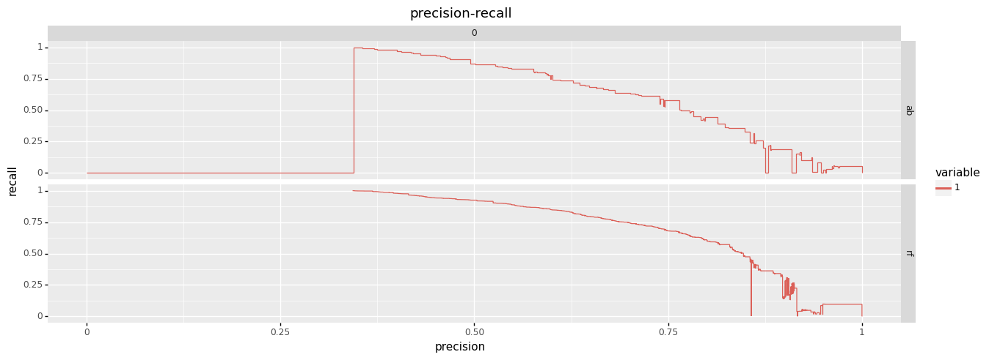

<ggplot: (-9223371863924620512)>

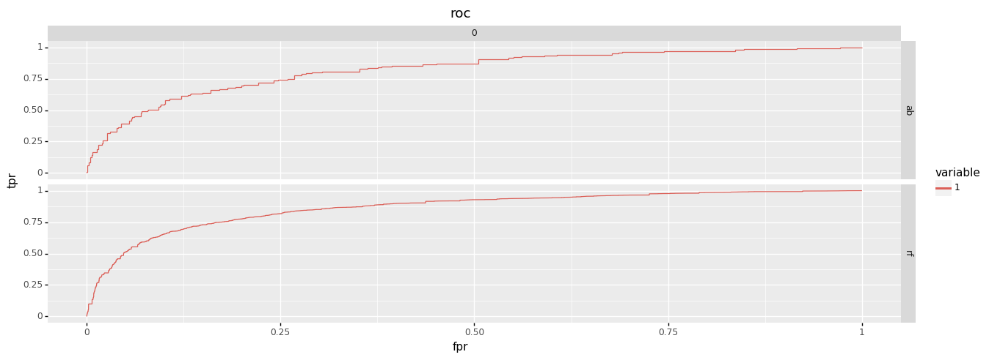

<ggplot: (-9223371863918534148)>

roc_auc
  model sample label  roc_auc
0   rf      0      1    0.865
1   ab      0      1    0.828
average_precision
  model sample label  average_precision
0   rf      0      1              0.782
1   ab      0      1              0.730
roc_auc stability
  model  mean  median   std
1   rf  0.865   0.865 0.000
0   ab  0.828   0.828 0.000
average precision stability
  model  mean  median   std
1   rf  0.782   0.782 0.000
0   ab  0.730   0.730 0.000


None

rf
ab
price
x
y
z
color


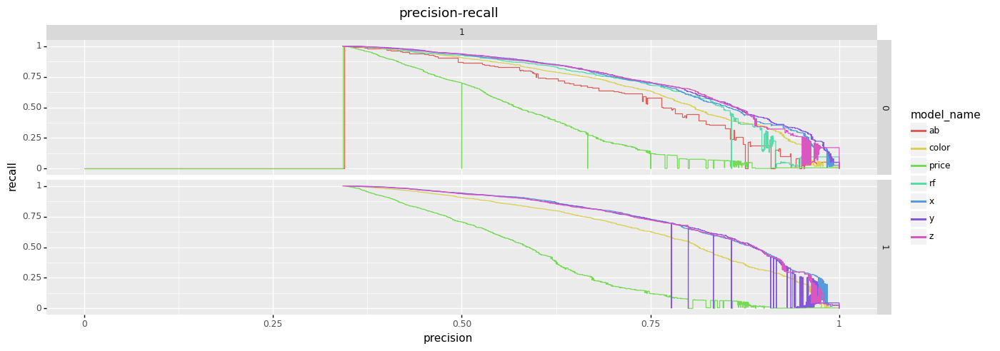

<ggplot: (-9223371863927643600)>

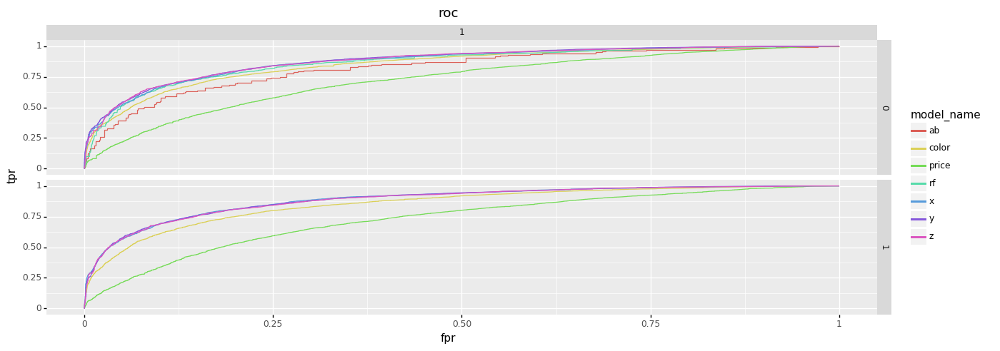

<ggplot: (-9223371863927662956)>

roc_auc
     model sample label  roc_auc
0      rf      0      1    0.865
1      ab      0      1    0.828
2   price      0      1    0.725
3   price      1      1    0.729
4       x      0      1    0.875
5       x      1      1    0.888
6       y      0      1    0.879
7       y      1      1    0.887
8       z      0      1    0.877
9       z      1      1    0.886
10  color      0      1    0.852
11  color      1      1    0.853
average_precision
     model sample label  average_precision
0      rf      0      1              0.782
1      ab      0      1              0.730
2   price      0      1              0.585
3   price      1      1              0.586
4       x      0      1              0.810
5       x      1      1              0.828
6       y      0      1              0.818
7       y      1      1              0.823
8       z      0      1              0.809
9       z      1      1              0.824
10  color      0      1              0.776
11  color      1      1      

None

rf
ab


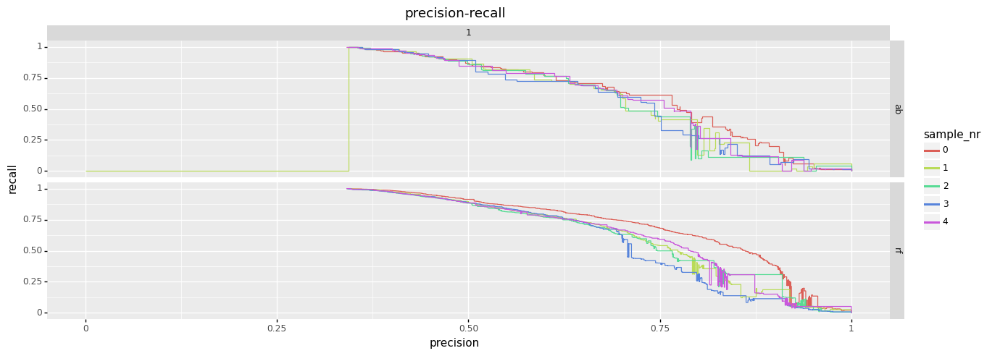

<ggplot: (-9223371863931037956)>

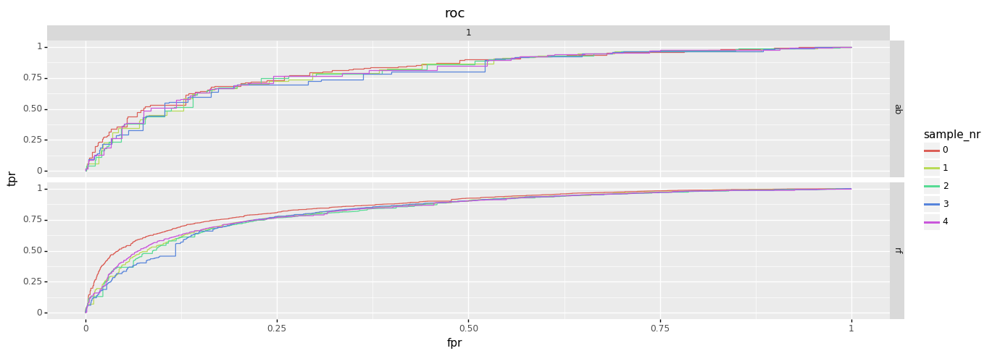

<ggplot: (-9223371863918096356)>

roc_auc
  model sample label  roc_auc
0   rf      0      1    0.864
1   rf      1      1    0.833
2   rf      2      1    0.827
3   rf      3      1    0.825
4   rf      4      1    0.833
5   ab      0      1    0.825
6   ab      1      1    0.814
7   ab      2      1    0.813
8   ab      3      1    0.805
9   ab      4      1    0.815
average_precision
  model sample label  average_precision
0   rf      0      1              0.791
1   rf      1      1              0.726
2   rf      2      1              0.720
3   rf      3      1              0.703
4   rf      4      1              0.732
5   ab      0      1              0.724
6   ab      1      1              0.689
7   ab      2      1              0.682
8   ab      3      1              0.683
9   ab      4      1              0.696
roc_auc stability
  model  mean  median   std
1   rf  0.836   0.833 0.014
0   ab  0.814   0.814 0.006
average precision stability
  model  mean  median   std
1   rf  0.734   0.726 0.030
0   ab  0.695   0.

None

rf
ab


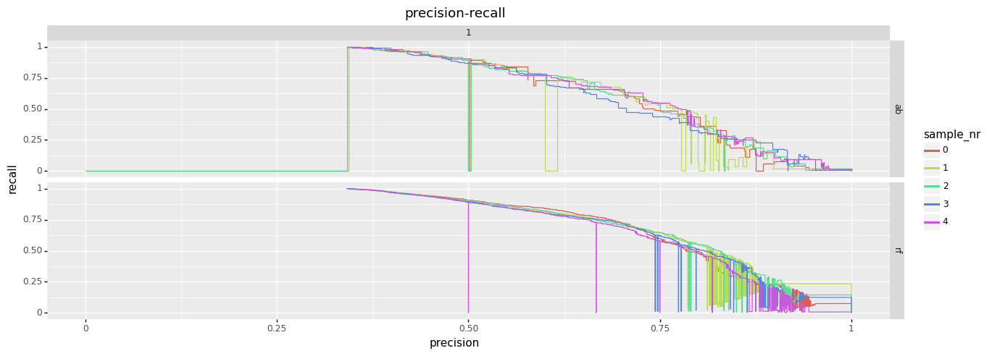

<ggplot: (-9223371863918089488)>

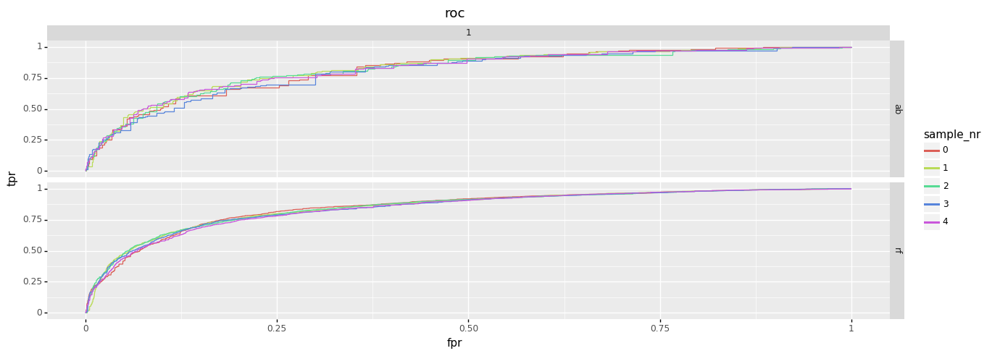

<ggplot: (-9223371863931644668)>

roc_auc
  model sample label  roc_auc
0   rf      0      1    0.850
1   rf      1      1    0.850
2   rf      2      1    0.850
3   rf      3      1    0.845
4   rf      4      1    0.841
5   ab      0      1    0.823
6   ab      1      1    0.832
7   ab      2      1    0.824
8   ab      3      1    0.813
9   ab      4      1    0.825
average_precision
  model sample label  average_precision
0   rf      0      1              0.757
1   rf      1      1              0.748
2   rf      2      1              0.761
3   rf      3      1              0.754
4   rf      4      1              0.746
5   ab      0      1              0.707
6   ab      1      1              0.715
7   ab      2      1              0.717
8   ab      3      1              0.702
9   ab      4      1              0.722
roc_auc stability
  model  mean  median   std
1   rf  0.847   0.850 0.003
0   ab  0.823   0.824 0.006
average precision stability
  model  mean  median   std
1   rf  0.753   0.754 0.006
0   ab  0.713   0.

None

In [17]:
%run "modules/F_classification.py"
# PARAMETERS FOR 'LEARNING THE MODEL'
simulation_name        = 'symulacja_1' # unique simulation name
simulation_description = 'pierwszy model na wszyskich zmiennych' # simulation description
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # dictionary with model we want to use. Elements selected from variable 'model_base'
cv_n                   = 5     # cross validation: number of k-folds ('None' if not to use)
hold_n                 = 5     # holdout validation: number of samples ('None' if not to use)
hold_train_sample_size = 0.1   # holdout validation: size of train set sample in percentage
hold_test_sample_size  = 0.1   # holdout validation: size of test set sample in percentage
fip_n                  = 2  # feature importatnce permutation validation:  number of samples ('None' if not to use. If we want to use it, it is recommended to provide value 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # feature importatnce permutation validation: prividing the model
by_var                 = 'cut' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var ('None' if not to use ). Uwaga: ta zmienna nie będzie uwgdlęniona w statystykach (np. w korelacjach)
pos_label              = '1'   # which target lable use as a 'positive'
balancing_method       = 'under'  # class balancing method (currently available: 'over', 'under', 'None'). Warning: 'over' (over sampling) cause that we will loose data indicies information in train set.
calibration_method     = None # probability calibartion method (currently available: 'isotonic', 'None')
cat_encoding_method    = 'target' # features encoding algorithm (currently available: 'target', 'None')

# PARAMETERS FOR'PERFORMANCE'
thresholds_priori_list ={  'p1':[{'0':0.5, '1':0.5},{'0':0.2, '1':0.8}]
                         , 'p2':[{'0':0.3, '1':0.7},{'0':0.2, '1':0.8}]} # thresholds and priori probability for each target class (it we provide 'None' then instead of thresholds formula 'max(pd)' is used to assign the class)


# INITIALIZATION of new object for simulation (needed only in the first simulation - next simulation carry out with the same object to store all results in one place)
c1 = classification_model()

# MODEL LEARNING (determining only probabilities)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, fip_type = fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (using threshold we determine scores, confusion matrix etc.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

 
# SAVING results on disk
# c1.save_results(path = r'C:\Users\memy\OneDrive\Pulpit\1_Programs_and_programing\DS_proj\classification_python\results\symulacja_1', override = True)

# LOADING results from disk (into empty object)
# c1.load_results(path = '...')

# RESULTS VISUALISATION
c1.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

# Model - MULTICLASS target


## Variables and data sets

In [46]:

# variables
y_var     = ['target_multi_label']    # target (multiclass)
x_var_num = ['price', 'x', 'y', 'z']  # numerical features
x_var_cat = ['color','clarity']       # categorical features
x_var     = x_var_num + x_var_cat     # all features

data1 = data.iloc[1:5000,:] 

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1 = data1.sample(frac = 1)
data1 = data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)


## Learning and performance

(3349, 7)
(1650, 7)
remove
remove
remove
remove
remove


,simulation_name,description,x_n,y_name,y_labels,x_num,x_cat,cat_encoding,balancing,calibration,simulation_start,simulation_end,pos_label,priori,threshold,performance start,performance end,threshold_priori_id
0,symulacja_1,pierwszy model na wszyskich zmiennych,5,target_multi_label,"0, 1, 2, 3, 4","price, x, y, z",color,target,None,None,2021-06-11 23:41:49,2021-06-11 23:41:54,1,NaN,NaN,2021-06-11 23:41:58,2021-06-11 23:42:01,p2


,price,x,y,z
price,1.000,0.880,0.890,0.850
x,0.880,1.000,1.000,0.930
y,0.890,1.000,1.000,0.930
z,0.850,0.930,0.930,1.000
,price,x,y,z
price,1.000,0.410,0.430,0.410
x,0.410,1.000,0.910,0.740
y,0.430,0.910,1.000,0.730
z,0.410,0.740,0.730,1.000
,price,x,y,z


None

,index,target_multi_label,proc
0,0,1236,36.910
1,3,798,23.830
2,1,733,21.890
3,2,401,11.970
4,4,181,5.400
,index,target_multi_label,proc
0,0,608,36.850
1,3,401,24.300
2,1,361,21.880
3,2,186,11.270


,0,1,2,3,4,_sum_,_correctness_
0,1040,65,9,83,39,1236,84
1,362,189,29,80,73,733,25
2,161,55,62,88,35,401,15
3,490,72,37,162,37,798,20
4,27,21,21,3,109,181,60
_sum_,2080,402,158,416,293,0,0
_correctness_,50,47,39,38,37,0,0
,0,1,2,3,4,_sum_,_correctness_
0,0,1236,0,0,0,1236,0
1,0,733,0,0,0,733,100


,0,1,2,3,4,_sum_,_correctness_
0,495,33,8,43,29,608,81
1,173,95,17,43,33,361,26
2,84,19,28,36,19,186,15
3,252,45,21,61,22,401,15
4,22,6,12,4,50,94,53
_sum_,1026,198,86,187,153,0,0
_correctness_,48,47,32,32,32,0,0
,0,1,2,3,4,_sum_,_correctness_
0,0,608,0,0,0,608,0
1,0,358,3,0,0,361,99


[None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

,model_name,set_type,threshold_priori_id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,_accuracy,_balanced_accuracy,_f1,_precision,_recall
0,ab,test,p1,495,33,8,43,29,173,95,17,43,33,84,19,28,36,19,252,45,21,61,22,22,6,12,4,50,0.442,0.382,0.394,0.417,0.442
1,ab,train,p1,1040,65,9,83,39,362,189,29,80,73,161,55,62,88,35,490,72,37,162,37,27,21,21,3,109,0.466,0.412,0.419,0.447,0.466
2,rf,test,p1,465,93,0,50,0,136,170,10,43,2,42,26,59,48,11,181,69,23,128,0,4,11,11,8,60,0.535,0.502,0.519,0.531,0.535
3,rf,train,p1,1006,140,2,88,0,245,429,3,55,1,81,59,158,100,3,324,120,30,324,0,2,20,6,10,143,0.615,0.598,0.604,0.628,0.615
4,ab,test,p2,0,608,0,0,0,0,358,3,0,0,0,185,1,0,0,0,401,0,0,0,0,93,1,0,0,0.218,0.199,0.079,0.070,0.218
5,ab,train,p2,0,1236,0,0,0,0,733,0,0,0,0,397,4,0,0,0,798,0,0,0,0,181,0,0,0,0.220,0.202,0.081,0.168,0.220
6,rf,test,p2,303,231,0,74,0,47,265,5,42,2,12,56,51,57,10,91,148,20,142,0,1,18,9,6,60,0.498,0.500,0.497,0.549,0.498
7,rf,train,p2,657,415,1,163,0,61,628,1,43,0,29,124,138,108,2,136,281,28,353,0,0,27,5,8,141,0.572,0.591,0.572,0.641,0.572


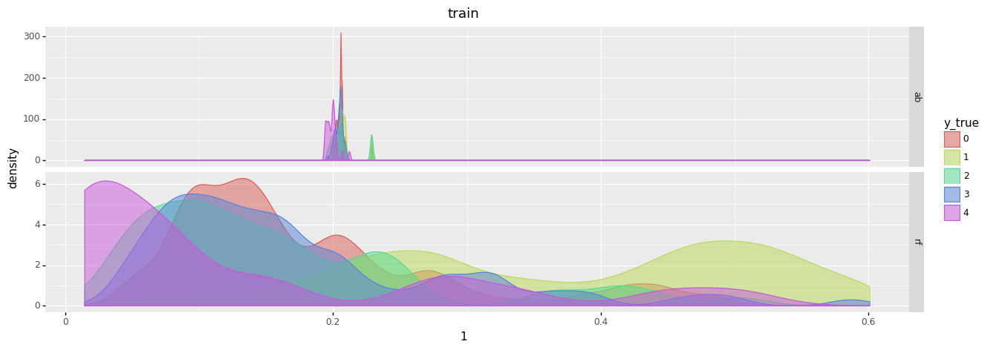

<ggplot: (-9223371912966103660)>

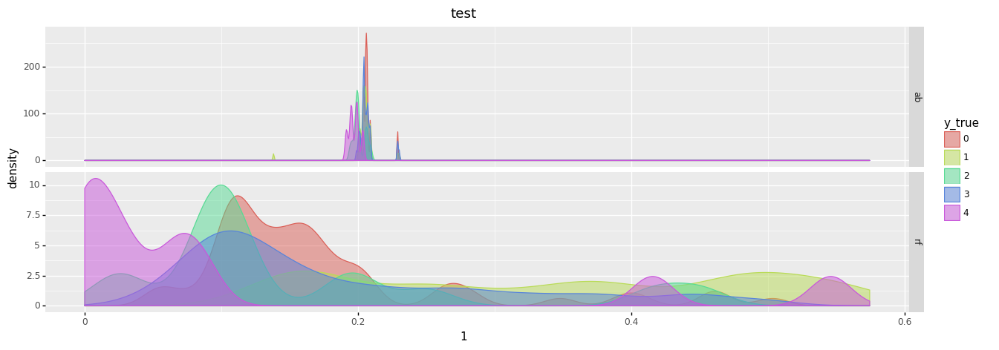

<ggplot: (-9223371912963584372)>

None

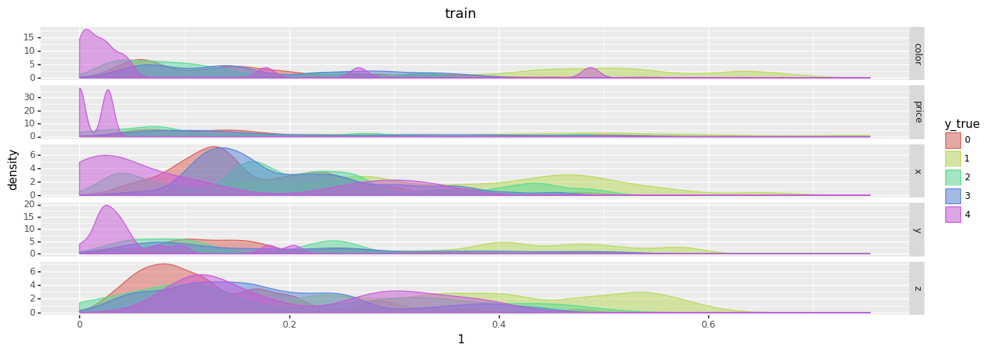

<ggplot: (-9223371912966197648)>

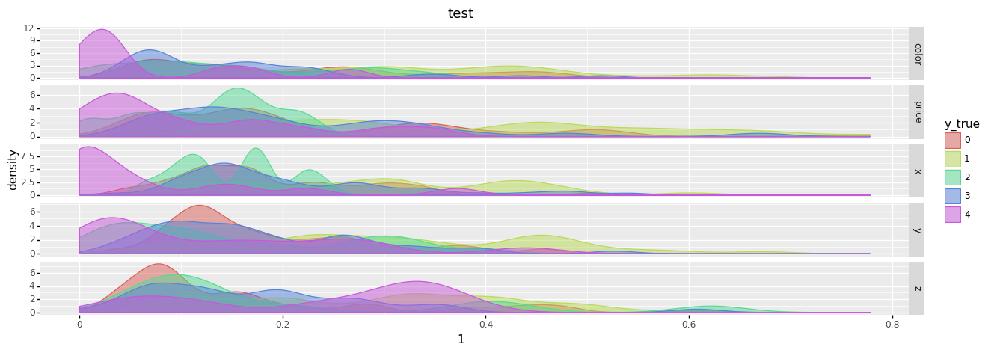

<ggplot: (-9223371912970743448)>

None

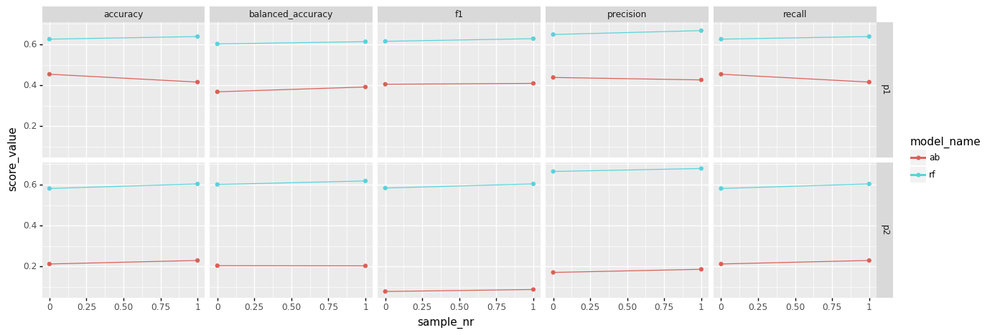

<ggplot: (-9223371912970457860)>

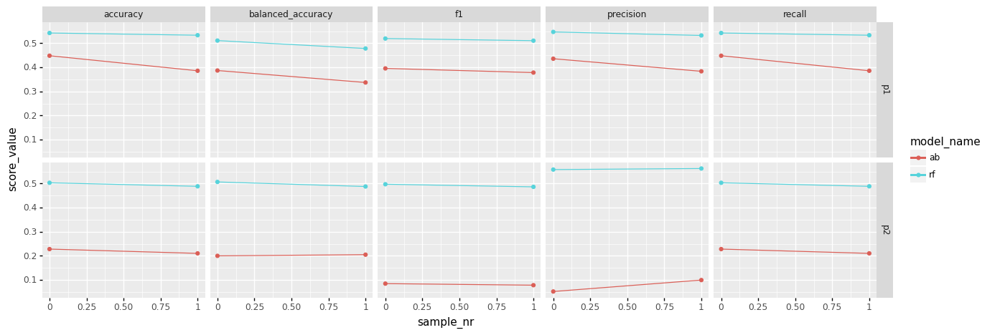

<ggplot: (-9223371912970665516)>

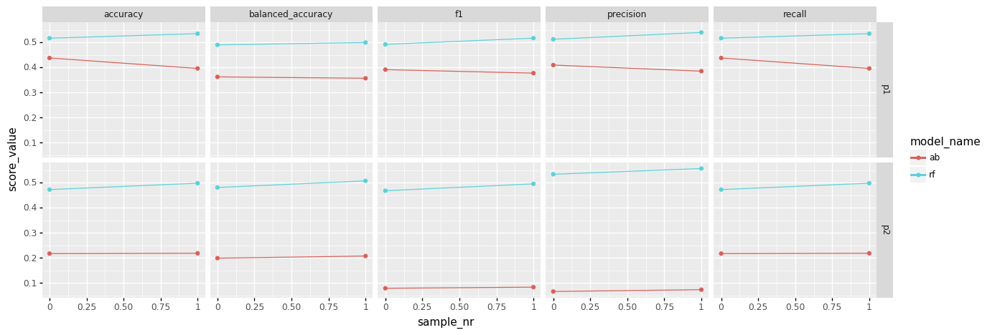

<ggplot: (-9223371912970462664)>

None

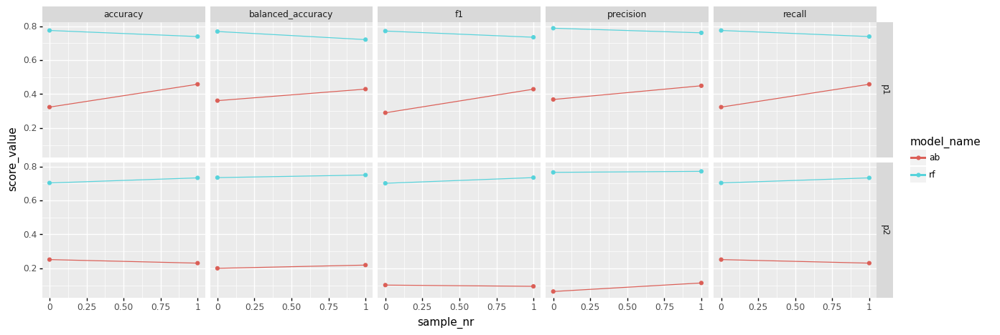

<ggplot: (-9223371912968957680)>

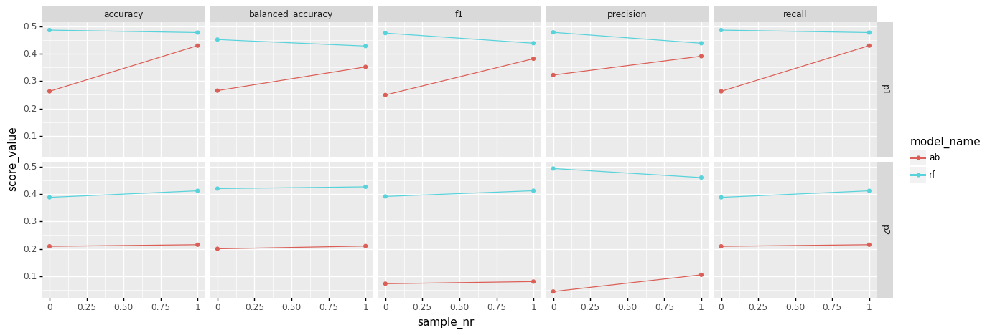

<ggplot: (-9223371912969505292)>

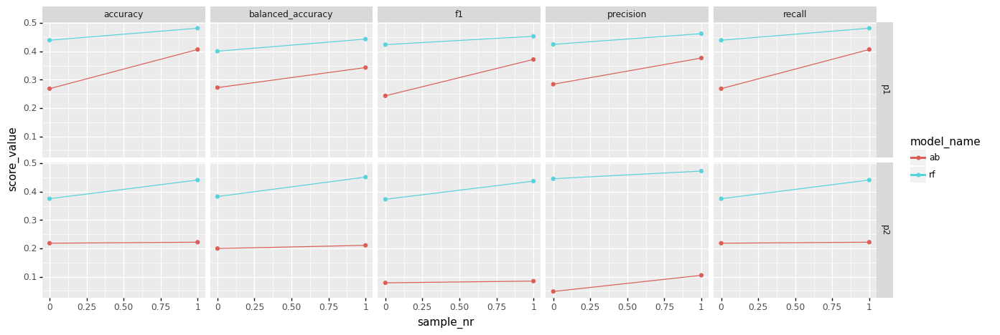

<ggplot: (-9223371912965016468)>

None

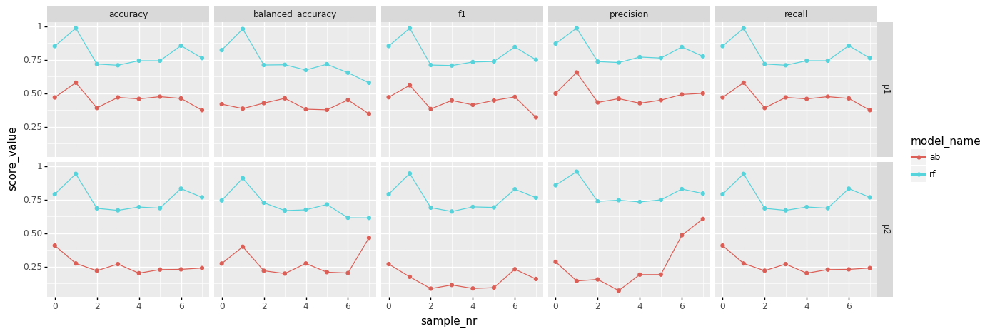

<ggplot: (-9223371912970876156)>

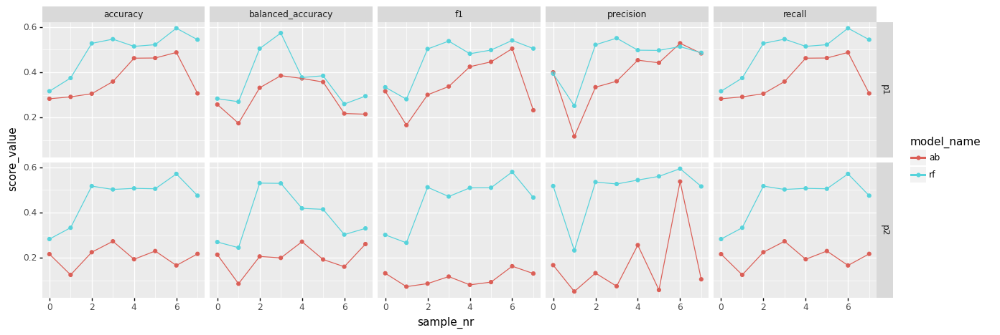

<ggplot: (-9223371912970435160)>

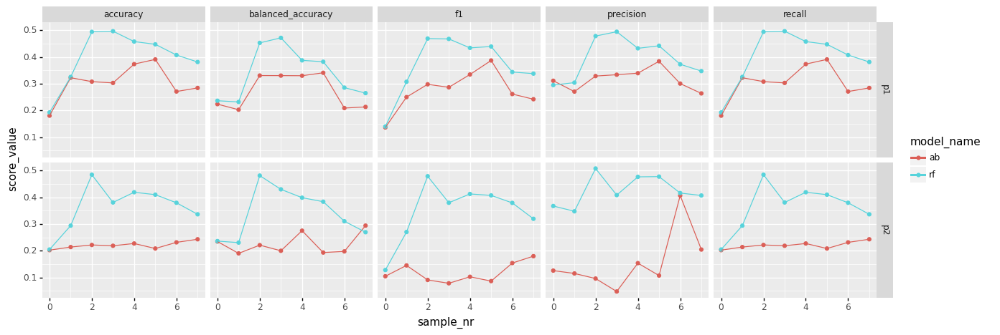

<ggplot: (-9223371912966085140)>

None

rf
ab


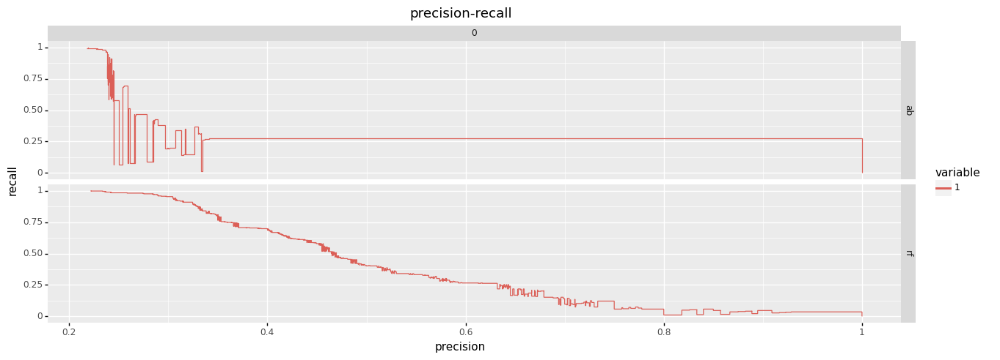

<ggplot: (-9223371912966227008)>

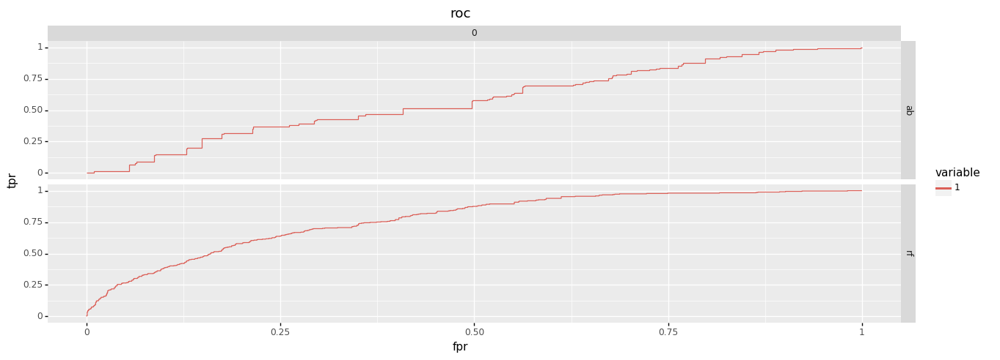

<ggplot: (-9223371912970308240)>

            average_precision
rf - 0 - 1              0.501
ab - 0 - 1              0.271
            roc_auc
rf - 0 - 1    0.776
ab - 0 - 1    0.588


None

rf
ab
price
x
y
z
color


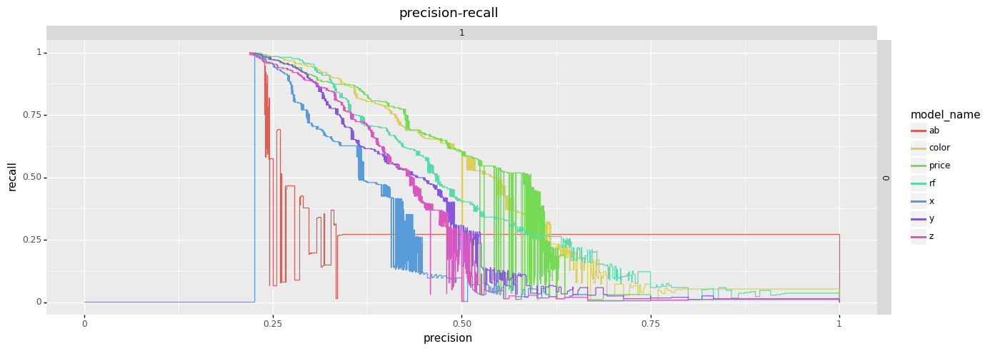

<ggplot: (-9223371912970352092)>

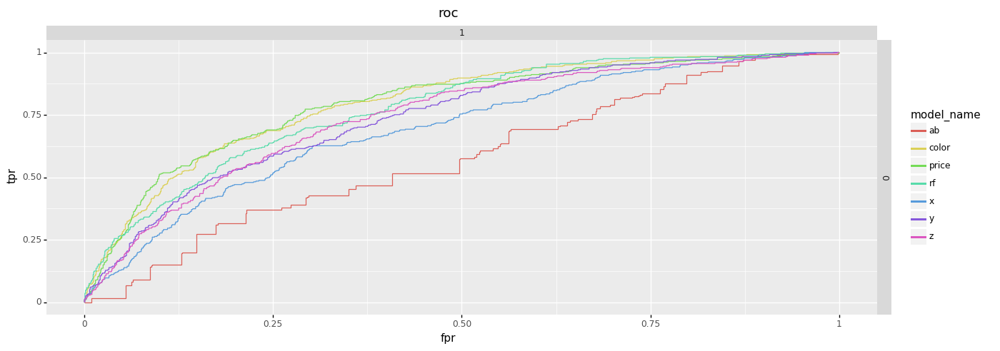

<ggplot: (-9223371912971080964)>

               average_precision
color - 0 - 1              0.517
price - 0 - 1              0.511
rf - 0 - 1                 0.501
y - 0 - 1                  0.436
z - 0 - 1                  0.421
x - 0 - 1                  0.378
ab - 0 - 1                 0.271
               roc_auc
color - 0 - 1    0.798
price - 0 - 1    0.796
rf - 0 - 1       0.776
y - 0 - 1        0.741
z - 0 - 1        0.741
x - 0 - 1        0.694
ab - 0 - 1       0.588


None

In [47]:
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_1' # unikalna nazwa symulacji
simulation_description = 'pierwszy model na wszyskich zmiennych' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 2     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 2     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = 'clarity' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # dla modeli wieloklasowych niedostepne
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# PARAMETRY DLA 'PERFORMANCE' (dla zagadnienie wialostanowego nie ma thresholdow. Jest tylko wazenie priori gdzie wagu sumuja sie do wartosci 1)
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# INICJALIZACJA nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, fip_type = fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# ZAPISANIE wynikow na dysk
# c1.save_results(path = r'C:\Users\memy\OneDrive\Pulpit\1_Programs_and_programing\DS_proj\classification_python\results\symulacja_1', override = True)

# LADOWANIE z dysku do zainicjowanego wczeniej pustego obiektu
# c1.load_results(path = '...')

# WIZUALIZACJA
c1.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

# Models aggregations

## Results aggregation

Zakładam że mam dwa różne modele na rozłączych zbiorach danych i chce uzyskać dla nich zagregowaną macierz pomysłek i scory

### Model 1

In [53]:
# variables
y_var     = ['target_multi_label']  # target
x_var_num = ['y', 'z']              # numerical features
x_var_cat = ['color','clarity']     # categorical features
x_var     = x_var_num + x_var_cat   # all features

# data set for the first model
data_model_1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data_model_1=data_model_1.sample(frac = 1)
data_model_1=data_model_1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data_model_1[x_var], data_model_1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [54]:
%run "modules/F_classification.py"
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_1_do_agreg' # unikalna nazwa symulacji
simulation_description = 'symulacja pierwsza do agregacji' # opis symulacji
models_list            = {'rf':models_base['rf'], 'cat':models_base['cat']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = None     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = None     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = None     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# PARAMETRY DLA PERFORMANCE
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, fip_type=fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 5)
(1650, 5)


You should provide test set for use best model. use_best_model parameter has been switched to false value.


### Model 2

In [28]:
# variables
y_var     = ['target_multi_label']     # target
x_var_num = ['price', 'x']             # numerical features
x_var_cat = ['color','clarity','cut']  # categorical features
x_var     = x_var_num + x_var_cat      # all features

# date set for the second model
data_model_2 = data.iloc[10000:20000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data_model_2=data_model_2.sample(frac = 1)
data_model_2=data_model_2.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data_model_2[x_var], data_model_2[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [31]:
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_2_do_agreg' # unikalna nazwa symulacji
simulation_description = 'symulacja druga do agregacji' # opis symulacji
models_list            = {'rf':models_base['rf'], 'cat':models_base['cat']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = None     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = None     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = None     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# PARAMETRY DLA 'PERFORMANCE'
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]} # thresholdy i priori dla kazdej kategorii (jezeli damy 'None' dla thresholdow przypisywanie odbywa sie poprzez max(pd))


# INICJALIZACJA nowego obiektu do symulacji : NIE JEST WYKONYWANA. PRACJEMY DALEJ NA OBIEKCIE Z POPRZEDNIEJ SYMULACJI


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, fip_type = fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# ZAPISANIE wynikow na dysk
c1.save_results(path = path = path_results + 'symulacja_1', override = True)


(6700, 6)
(3300, 6)


You should provide test set for use best model. use_best_model parameter has been switched to false value.


### Agregating results of model 1 and model 2

In [55]:
c1.scores_cf_agg_full(simulation_params = [['symulacja_1_do_agreg','cat','p1'], ['symulacja_2_do_agreg','rf','p2']], if_automatic=0, pos_label = pos_label)

# nazwa nowgo polaczonego performance
simulation_new_name = '_' + 'symulacja_1_do_agreg' + '_' +  'symulacja_2_do_agreg'

# najwazniejsze statyski dla zagregowanych modeli
h('target distribution, confussion matrix, scores and feature importance')
c1.fast_conf_matrix_scores(simulation_name = simulation_new_name)


,index,target_multi_label,proc
,index,target_multi_label,proc


,0,1,2,3,4,_sum_,_correctness_
0,1044,98,1,103,3,1249,83
1,371,234,13,133,1,752,31
2,129,79,76,93,7,384,19
3,416,127,23,212,1,779,27
4,11,16,33,14,111,185,60
_sum_,1971,554,146,555,123,0,0
_correctness_,52,42,52,38,90,0,0


,0,1,2,3,4,_sum_,_correctness_
0,499,41,3,51,1,595,83
1,182,98,6,56,0,342,28
2,56,59,30,54,4,203,14
3,229,76,16,99,0,420,23
4,6,13,22,3,46,90,51
_sum_,972,287,77,263,51,0,0
_correctness_,51,34,38,37,90,0,0


[None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

## Probability averaging

Jezeli usredniam miedzy roznymi symulacjami to zakladam ze byly one zbudowane na zbiorach z tymi samymi obserwacjami ktore byly tak samo posortowane

### Model 1

In [15]:
# variables
y_var     = ['target_multi_label']    # target
x_var_num = ['price', 'table']        # numerical features
x_var_cat = ['color','clarity','cut'] # categorical features
x_var     = x_var_num + x_var_cat     # all features

# data set for the first model
data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)


# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [18]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja_1_do_usredn' # unikalna nazwa symulacji
simulation_description = 'symulacja pierwsza do usredniania' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = 'cut' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# parematry dla PERFORMANCE
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 6)
(1650, 6)


### Model 2 

In [36]:
# variables
y_var     = ['target_multi_label']    # target
x_var_num = ['y', 'z']                # numerical features
x_var_cat = ['color','clarity','cut'] # categorical features
x_var     = x_var_num + x_var_cat     # all features


# data set for the second model (the same observations as for the first model !!!)
data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [ ]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja_2_do_usredn' # unikalna nazwa symulacji
simulation_description = 'symulacja druga do usredniania' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = 'cut' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# parematry dla PERFORMANCE
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# inicjalizacja nowego obiektu do symulacji : NIE JEST WYKONYWANA. PRACJEMY DALEJ NA OBIEKCIE W POPRZEDNIEJ SYMULACJI


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


### Averaging

In [38]:
# lista z parami : (1) nazwa_symulacji - (2) model
list_to_stack = [['symulacja_1_do_usredn','rf'], ['symulacja_2_do_usredn','ab']]

# nazwa nowej usrednione symulacji
new_simulation_name = 'sim_new'

# usrednienie prawdopodobienstw
c1.stacking_between_sim(simulation_new_name = new_simulation_name, simulation_params = list_to_stack, method = 'mean')


# parematry dla PERFORMANCE
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]} 

# nowe przeliczenie performance
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = new_simulation_name, pos_label = '1' )



### Results visualisation

,index,target_multi_label,proc
,index,target_multi_label,proc


,0,1,2,3,4,_sum_,_correctness_
0,1153,55,0,20,0,1228,93
1,95,578,17,35,0,725,79
2,112,166,98,21,0,397,24
3,330,323,25,139,1,818,16
4,70,73,9,11,18,181,9
_sum_,1760,1195,149,226,19,0,0
_correctness_,65,48,65,61,94,0,0
,0,1,2,3,4,_sum_,_correctness_
0,879,182,6,157,4,1228,71
1,53,660,0,12,0,725,91


,0,1,2,3,4,_sum_,_correctness_
0,581,27,2,6,0,616,94
1,56,263,14,35,1,369,71
2,67,67,36,20,0,190,18
3,161,159,11,49,1,381,12
4,35,41,10,3,5,94,5
_sum_,900,557,73,113,7,0,0
_correctness_,64,47,49,43,71,0,0
,0,1,2,3,4,_sum_,_correctness_
0,425,93,1,94,3,616,68
1,28,321,1,17,2,369,86


,model_name,set_type,threshold_priori_id,score_value
0,model_stack,test,p1,0.566
1,model_stack,train,p1,0.593
2,model_stack,test,p2,0.499
3,model_stack,train,p2,0.532
,model_name,set_type,threshold_priori_id,score_value
0,model_stack,test,p1,0.405
1,model_stack,train,p1,0.450
2,model_stack,test,p2,0.368
3,model_stack,train,p2,0.421
,model_name,set_type,threshold_priori_id,score_value


[None,
 None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

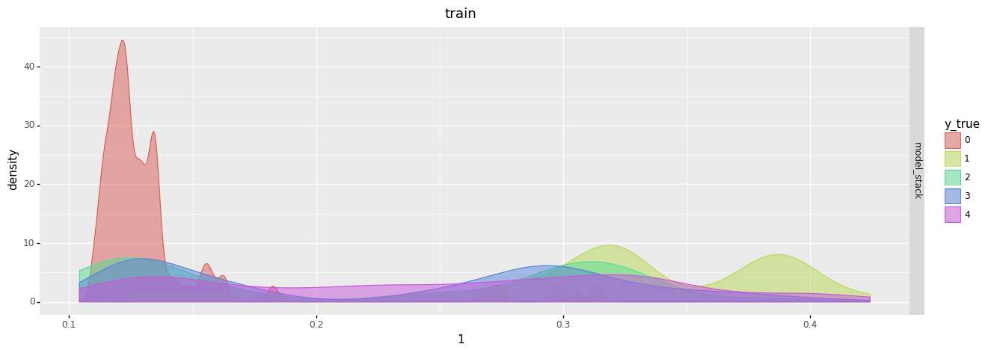

<ggplot: (-9223371899430566008)>

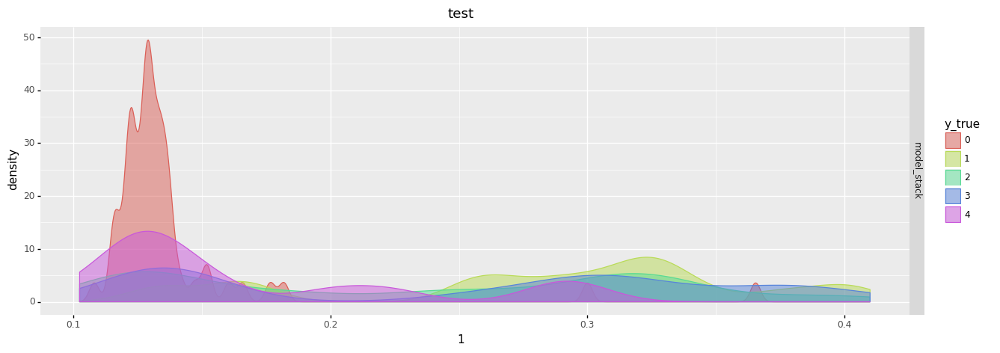

<ggplot: (-9223371899425653848)>

In [39]:
# wizualizacja wynikow (bez obliczec symulacyjnych np. walidacji krzyzowej)
simulation_name = 'sim_new'
h('target distribution, confussion matrix, scores and feature importance')
c1.fast_conf_matrix_scores(simulation_name = simulation_name)
h('density plots')
c1.fast_dens_plot(simulation_name=simulation_name, sample_type = ['full'])


## Stacking

### Models

In [40]:
# variables
y_var     = ['target_multi_label']    # variables
x_var_num = ['price', 'table']        # numerical features
x_var_cat = ['color','clarity','cut'] # categorical features
x_var     = x_var_num + x_var_cat     # all features


data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [41]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja_stack' # unikalna nazwa symulacji
simulation_description = 'symulacja do stackingu' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = 'cut' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# parematry dla PERFORMANCE
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]} 


# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 6)
(1650, 6)


### Stack

In [42]:
# budowanie nowego zbioru danych

labels = ['0', '1']


var_m1_names = ['0_m1', '1_m1']
var_m2_names = ['0_m2', '1_m2']

# prawdopodobienstwa model 1
pb_model_1_train = c1.probabilities.loc[(c1.probabilities['simulation_name'] == 'symulacja_stack') &
                                  (c1.probabilities['model_name']  == 'rf') &
                                  (c1.probabilities['sample_type'] == 'full') & 
                                  (c1.probabilities['set_type']    == 'train'), labels].reset_index(drop = True)

pb_model_1_train = pb_model_1_train.rename(columns={'0':var_m1_names[0], '1':var_m1_names[1]})

pb_model_1_test = c1.probabilities.loc[(c1.probabilities['simulation_name'] == 'symulacja_stack') &
                                  (c1.probabilities['model_name']  == 'rf') &
                                  (c1.probabilities['sample_type'] == 'full') & 
                                  (c1.probabilities['set_type']    == 'test'), labels].reset_index(drop = True)

pb_model_1_test = pb_model_1_test.rename(columns={'0':var_m1_names[0], '1':var_m1_names[1]})



# prawdopodobienstwa model 2
pb_model_2_train = c1.probabilities.loc[(c1.probabilities['simulation_name'] == 'symulacja_stack') &
                                  (c1.probabilities['model_name']  == 'ab') &
                                  (c1.probabilities['sample_type'] == 'full') & 
                                  (c1.probabilities['set_type']    == 'train'), labels].reset_index(drop = True)

pb_model_2_train = pb_model_2_train.rename(columns={'0':var_m2_names[0], '1':var_m2_names[1]})


pb_model_2_test = c1.probabilities.loc[(c1.probabilities['simulation_name'] == 'symulacja_stack') &
                                  (c1.probabilities['model_name']  == 'ab') &
                                  (c1.probabilities['sample_type'] == 'full') & 
                                  (c1.probabilities['set_type']    == 'test'), labels].reset_index(drop = True)

pb_model_2_test = pb_model_2_test.rename(columns={'0':var_m2_names[0], '1':var_m2_names[1]})



y_train = c1.probabilities.loc[(c1.probabilities['simulation_name'] == 'symulacja_stack') &
                               (c1.probabilities['model_name']  == 'rf') &
                               (c1.probabilities['sample_type'] == 'full') & 
                               (c1.probabilities['set_type']    == 'train'), 'y_true'].reset_index(drop = True)


y_test = c1.probabilities.loc[(c1.probabilities['simulation_name'] == 'symulacja_stack') &
                               (c1.probabilities['model_name']  == 'rf') &
                               (c1.probabilities['sample_type'] == 'full') & 
                               (c1.probabilities['set_type']    == 'test'), 'y_true'].reset_index(drop = True)


y_var = ['y_true']
x_var_num = var_m1_names + var_m2_names
x_var_cat = []
x_var = x_var_num + x_var_cat

train_set = pd.concat([pb_model_1_train, pb_model_2_train, y_train], axis  = 1 )
test_set  = pd.concat([pb_model_1_test,  pb_model_2_test,  y_test], axis  = 1 )



In [45]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja pelny stacking' # unikalna nazwa symulacji
simulation_description = 'symulacja pelny stacking' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# parematry dla PERFORMANCE
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
                         , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c2 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c2.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c2.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# zapisanie wynikow na dysk
c2.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 5)
(1650, 5)


,simulation_name,description,x_n,y_name,y_labels,x_num,x_cat,cat_encoding,balancing,calibration,simulation_start,simulation_end,pos_label,priori,threshold,performance start,performance end,threshold_priori_id
0,symulacja pelny stacking,symulacja pelny stacking,4,y_true,"0, 1, 2, 3, 4","0_m1, 1_m1, 0_m2, 1_m2",,target,None,None,2021-04-12 12:08:53,2021-04-12 12:08:56,1,NaN,NaN,2021-04-12 12:08:59,2021-04-12 12:09:02,p2


,0_m1,1_m1,0_m2,1_m2
0_m1,1.000,-0.870,0.580,-0.590
1_m1,-0.870,1.000,-0.320,0.490
0_m2,0.580,-0.320,1.000,-0.660
1_m2,-0.590,0.490,-0.660,1.000
,0_m1,1_m1,0_m2,1_m2
0_m1,1.000,-0.670,0.660,-0.470
1_m1,-0.670,1.000,-0.490,0.380
0_m2,0.660,-0.490,1.000,-0.310
1_m2,-0.470,0.380,-0.310,1.000
,0_m1,1_m1,0_m2,1_m2


None

,index,y_true,proc
0,0,1194,35.650
1,3,809,24.160
2,1,761,22.720
3,2,390,11.650
4,4,195,5.820
,index,y_true,proc
0,0,650,39.390
1,3,390,23.640
2,1,333,20.180
3,2,197,11.940


,0,1,2,3,4,_sum_,_correctness_
0,1094,27,1,63,9,1194,91
1,98,378,0,258,27,761,49
2,102,74,1,186,27,390,0
3,295,200,1,255,58,809,31
4,48,38,0,68,41,195,21
_sum_,1637,717,3,830,162,0,0
_correctness_,66,52,33,30,25,0,0
,0,1,2,3,4,_sum_,_correctness_
0,0,1194,0,0,0,1194,0
1,0,761,0,0,0,761,100


,0,1,2,3,4,_sum_,_correctness_
0,567,22,1,45,15,650,87
1,33,172,1,111,16,333,51
2,51,36,0,94,16,197,0
3,147,105,0,118,20,390,30
4,28,16,0,23,13,80,16
_sum_,826,351,2,391,80,0,0
_correctness_,68,49,0,30,16,0,0
,0,1,2,3,4,_sum_,_correctness_
0,0,650,0,0,0,650,0
1,0,333,0,0,0,333,100


,model_name,set_type,threshold_priori_id,score_value
0,ab,test,p1,0.527
1,ab,train,p1,0.528
2,rf,test,p1,0.556
3,rf,train,p1,0.613
4,ab,test,p2,0.204
5,ab,train,p2,0.229
6,rf,test,p2,0.537
7,rf,train,p2,0.604
,model_name,set_type,threshold_priori_id,score_value
0,ab,test,p1,0.371


[None,
 None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

,model_name,set_type,threshold_priori_id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,ab,test,p1,567,22,1,45,15,33,172,1,111,16,51,36,0,94,16,147,105,0,118,20,28,16,0,23,13
0,ab,train,p1,1094,27,1,63,9,98,378,0,258,27,102,74,1,186,27,295,200,1,255,58,48,38,0,68,41
0,rf,test,p1,573,19,2,56,0,33,215,14,71,0,51,82,34,29,1,142,132,29,87,0,29,33,4,5,9
0,rf,train,p1,1111,34,0,49,0,92,547,18,103,1,101,132,111,46,0,281,219,49,260,0,57,67,18,28,25
0,ab,test,p2,0,650,0,0,0,0,333,0,0,0,0,197,0,0,0,0,390,0,0,0,0,76,0,0,4
0,ab,train,p2,0,1194,0,0,0,0,761,0,0,0,0,390,0,0,0,0,809,0,0,0,0,189,0,0,6
0,rf,test,p2,505,47,6,92,0,28,270,10,25,0,42,93,33,28,1,115,179,27,69,0,26,34,4,7,9
0,rf,train,p2,1022,77,2,91,2,67,647,16,31,0,80,150,113,47,0,212,335,46,216,0,38,82,15,36,24


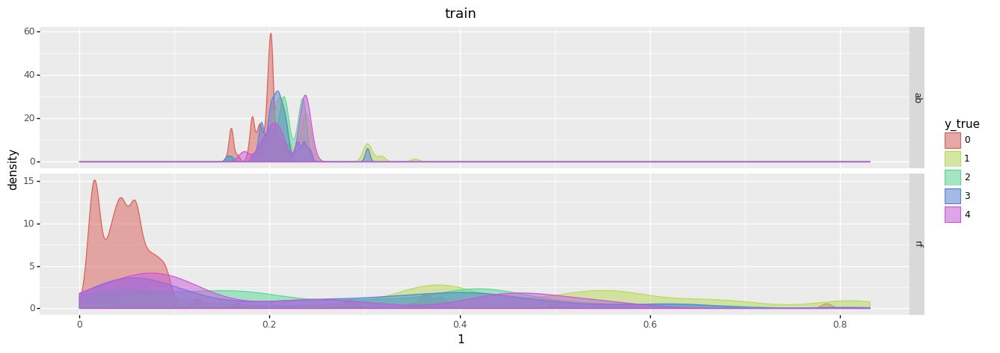

<ggplot: (-9223371899425252192)>

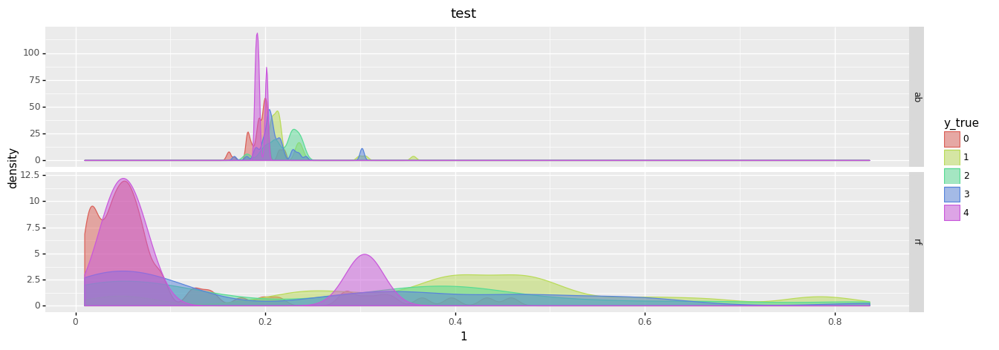

<ggplot: (-9223371899424786624)>

None

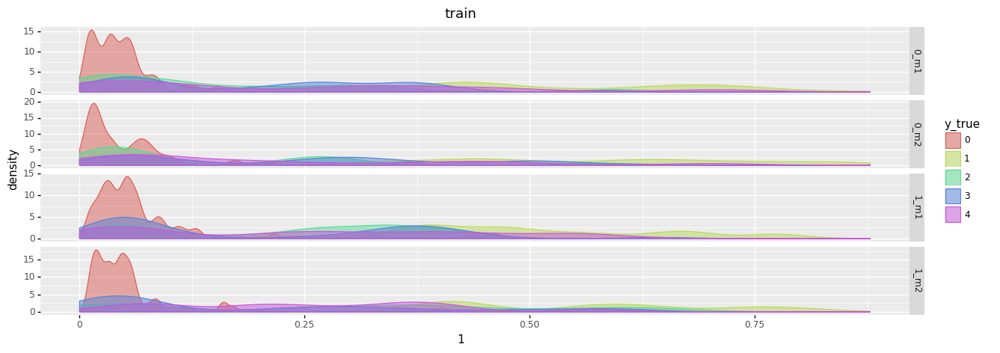

<ggplot: (-9223371899425673996)>

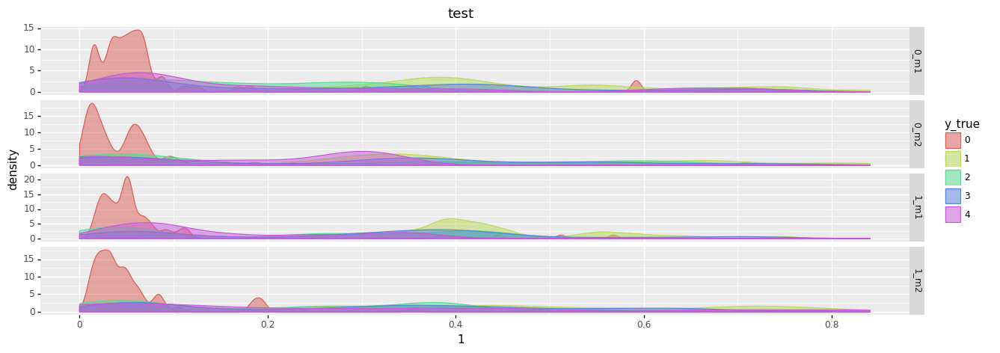

<ggplot: (-9223371899425676048)>

None

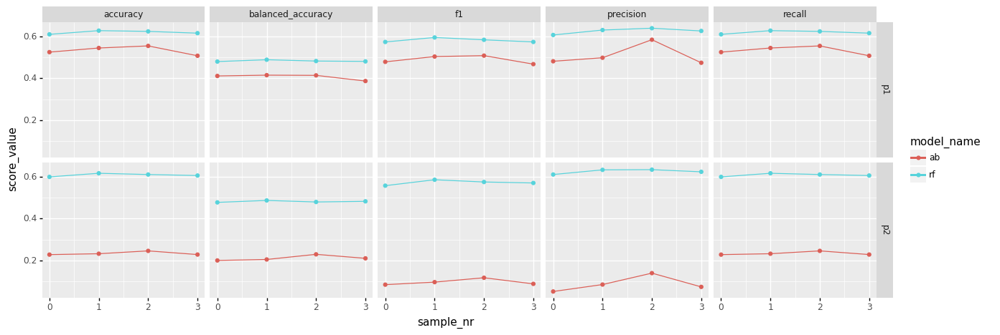

<ggplot: (-9223371899426749192)>

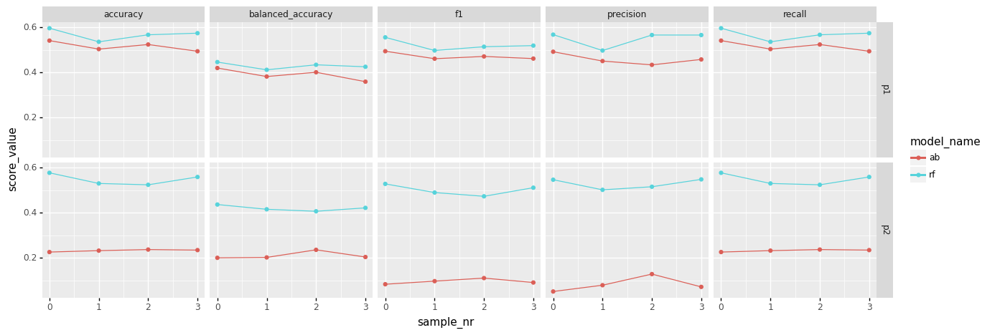

<ggplot: (-9223371899425193392)>

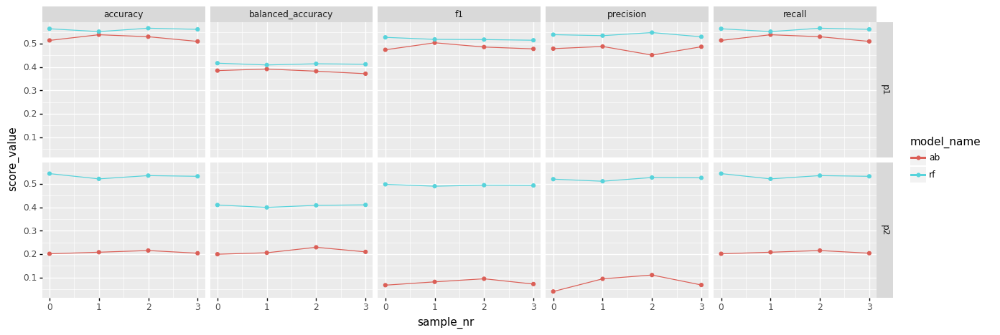

<ggplot: (-9223371899426740232)>

None

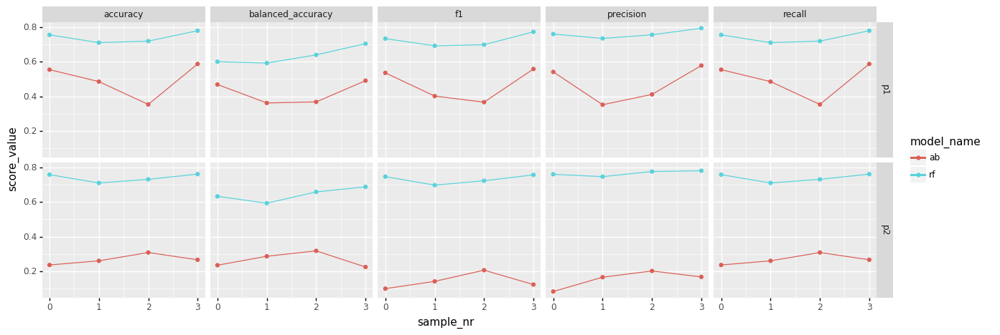

<ggplot: (-9223371899425177092)>

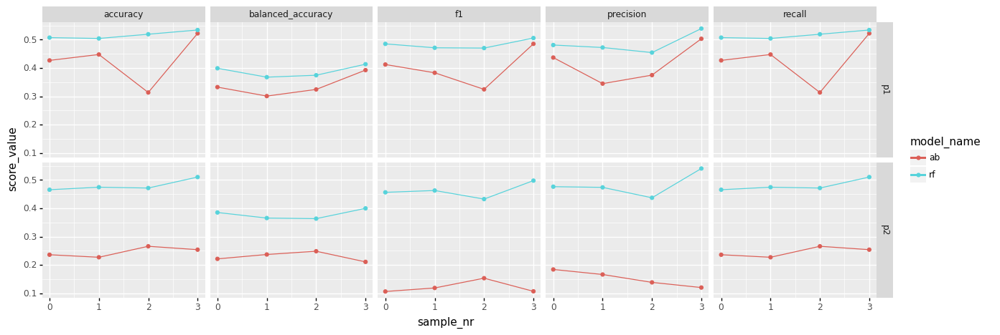

<ggplot: (-9223371899423744560)>

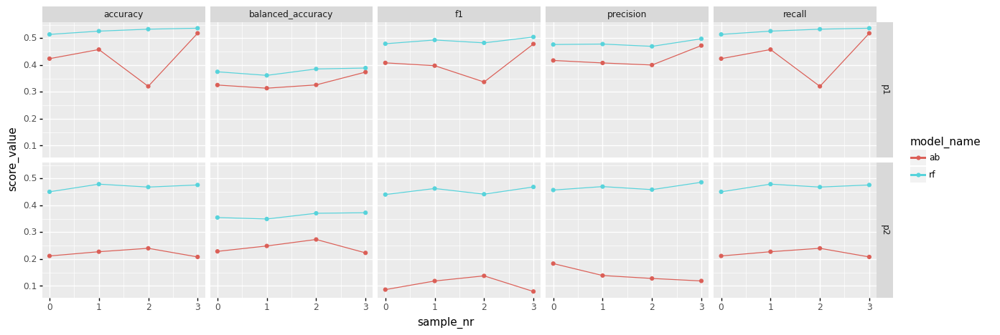

<ggplot: (-9223371899423355396)>

None

rf
ab


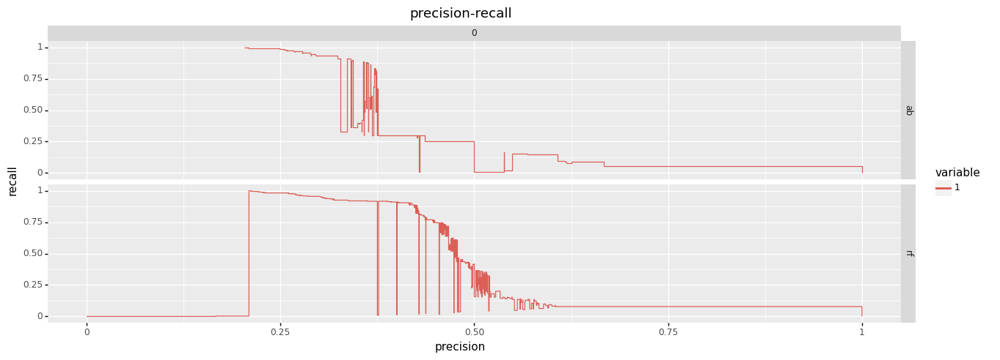

<ggplot: (-9223371899549534980)>

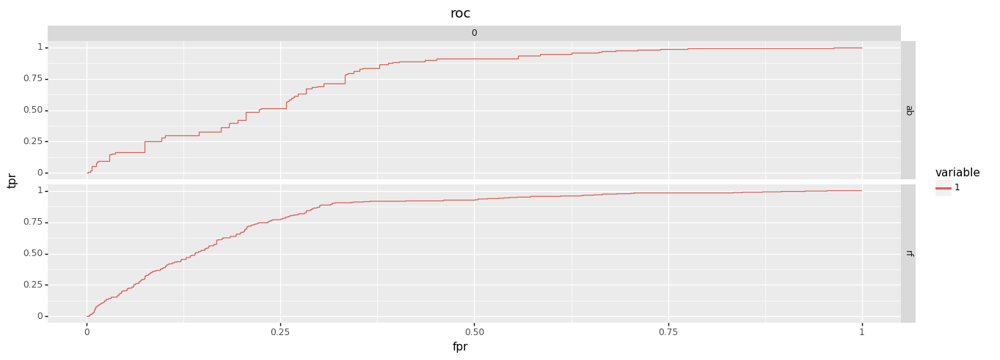

<ggplot: (-9223371899547939076)>

            average_precision
rf - 0 - 1              0.468
ab - 0 - 1              0.405
            roc_auc
rf - 0 - 1    0.823
ab - 0 - 1    0.767


None

rf
ab
0_m1
1_m1
0_m2
1_m2


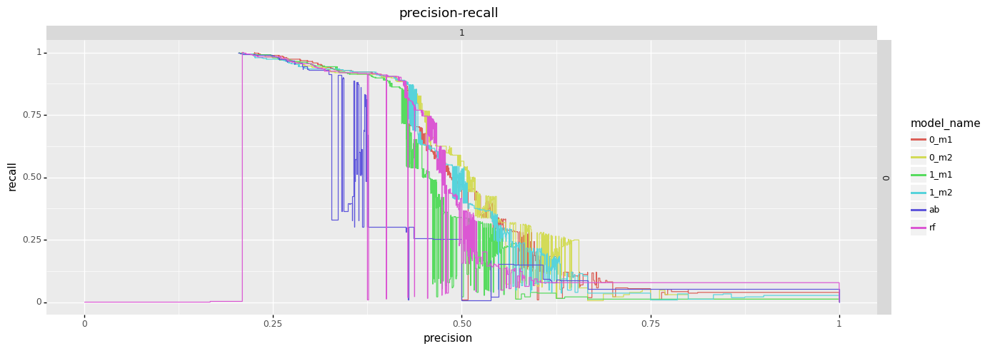

<ggplot: (-9223371899547848200)>

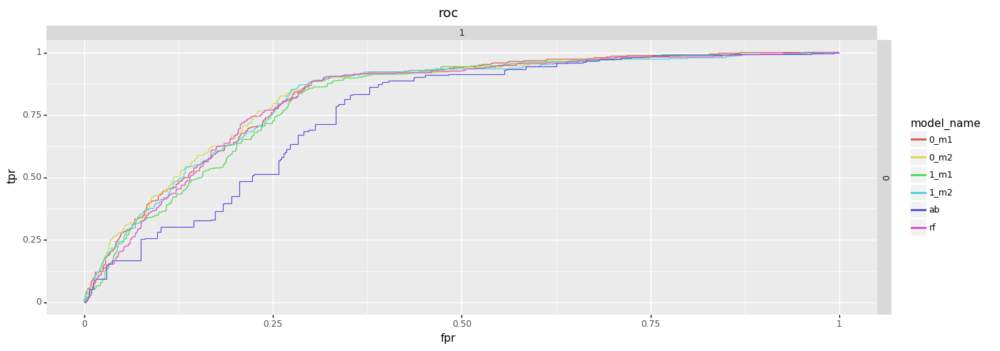

<ggplot: (-9223371899547272708)>

              average_precision
0_m2 - 0 - 1              0.514
0_m1 - 0 - 1              0.508
1_m2 - 0 - 1              0.503
rf - 0 - 1                0.468
1_m1 - 0 - 1              0.464
ab - 0 - 1                0.405
              roc_auc
0_m2 - 0 - 1    0.831
0_m1 - 0 - 1    0.830
1_m2 - 0 - 1    0.824
rf - 0 - 1      0.823
1_m1 - 0 - 1    0.814
ab - 0 - 1      0.767


None

In [46]:
c2.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

# Model dynamic cut off

## Variables and data set

In [392]:
# variables
y_var     = ['target']                # target
x_var_num = ['price', 'x', 'y', 'z']  # numerical features
x_var_cat = ['color','cut']           # categorical features
x_var     = x_var_num + x_var_cat     # all features


train_set = pd.concat([data_x_train[x_var], data_y_train], axis = 1)
test_set  = pd.concat([data_x_test[x_var],  data_y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)


## Learning and performance

(3349, 7)
(1650, 7)


You should provide test set for use best model. use_best_model parameter has been switched to false value.


,simulation_name,description,x_n,y_name,y_labels,x_num,x_cat,cat_encoding,balancing,calibration,simulation_start,simulation_end,pos_label,priori,threshold,performance start,performance end,threshold_priori_id
0,symulacja_1,pierwszy model na wszyskich zmiennych,6,target,"0, 1","price, x, y, z","color, cut",target,under,None,2021-06-17 16:04:21,2021-06-17 16:04:26,1,NaN,NaN,2021-06-17 16:04:33,2021-06-17 16:04:35,q_0.8


,price,x,y,z,color,cut
price,1.000,0.870,0.890,0.840,0.000,-0.050
x,0.870,1.000,0.990,0.930,-0.040,-0.200
y,0.890,0.990,1.000,0.930,-0.040,-0.170
z,0.840,0.930,0.930,1.000,-0.050,-0.220
color,0.000,-0.040,-0.040,-0.050,1.000,0.060
cut,-0.050,-0.200,-0.170,-0.220,0.060,1.000
,price,x,y,z,color,cut
price,1.000,0.400,0.420,0.400,-0.010,-0.030
x,0.400,1.000,0.910,0.740,-0.040,-0.220
y,0.420,0.910,1.000,0.730,-0.040,-0.190


None

,index,target,proc
0,0,2331,69.600
1,1,1018,30.400
,index,target,proc
0,0,1163,70.480
1,1,487,29.520


,0,1,_sum_,_correctness_
0,500,518,1018,49
1,8,1010,1018,99
_sum_,508,1528,0,0
_correctness_,98,66,0,0
,0,1,_sum_,_correctness_
0,723,295,1018,71
1,52,966,1018,94
_sum_,775,1261,0,0
_correctness_,93,76,0,0
,0,1,_sum_,_correctness_


,0,1,_sum_,_correctness_
0,516,647,1163,44
1,17,470,487,96
_sum_,533,1117,0,0
_correctness_,96,42,0,0
,0,1,_sum_,_correctness_
0,739,424,1163,63
1,41,446,487,91
_sum_,780,870,0,0
_correctness_,94,51,0,0
,0,1,_sum_,_correctness_


,Feature,Importance,Importance_abs,l1
0,price,3.220,3.220,0.1
1,z,-2.080,2.080,0.1
2,x,-1.620,1.620,0.1
3,y,-0.880,0.880,0.1
4,color,0.060,0.060,0.1
5,cut,0.000,0.000,0.1
6,NOISE_uniform,0.000,0.000,0.1
7,NOISE_normal,0.000,0.000,0.1
8,price,3.280,3.280,0.5
9,z,-2.080,2.080,0.5


[None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

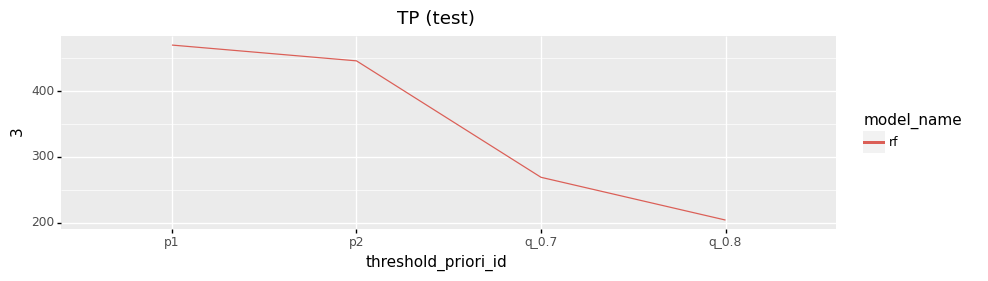

<ggplot: (-9223371917233231756)>

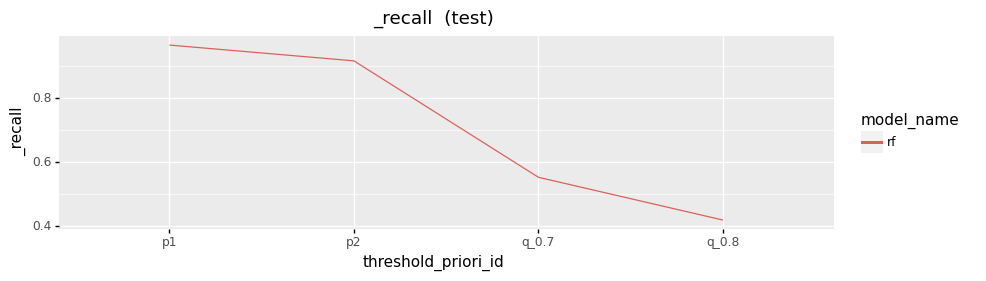

<ggplot: (-9223371917245763604)>

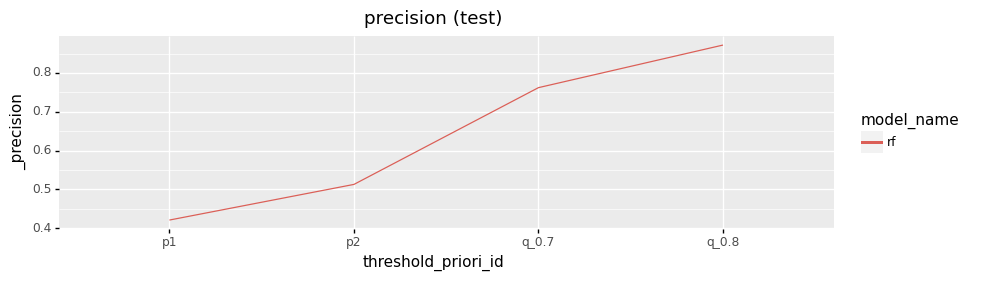

<ggplot: (-9223371917163641584)>

,model_name,set_type,threshold_priori_id,0,1,2,3,_accuracy,_balanced_accuracy,_f1,_precision,_recall
0,rf,test,p1,516,647,17,470,0.598,0.704,0.586,0.421,0.965
1,rf,train,p1,500,518,8,1010,0.742,0.742,0.793,0.661,0.992
2,rf,test,p2,739,424,41,446,0.718,0.776,0.657,0.513,0.916
3,rf,train,p2,723,295,52,966,0.830,0.830,0.848,0.766,0.949
4,rf,test,q_0.7,1079,84,218,269,0.817,0.740,0.640,0.762,0.552
5,rf,train,q_0.7,969,49,371,647,0.794,0.794,0.755,0.930,0.636
6,rf,test,q_0.8,1133,30,283,204,0.810,0.697,0.566,0.872,0.419
7,rf,train,q_0.8,998,20,560,458,0.715,0.715,0.612,0.958,0.450


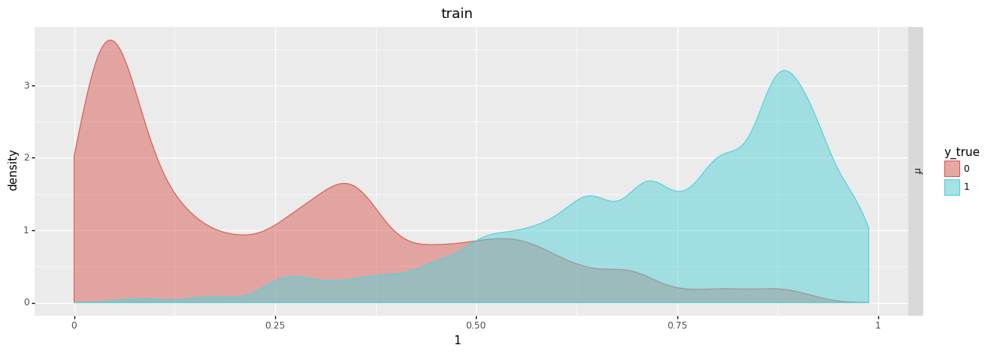

<ggplot: (-9223371917141520192)>

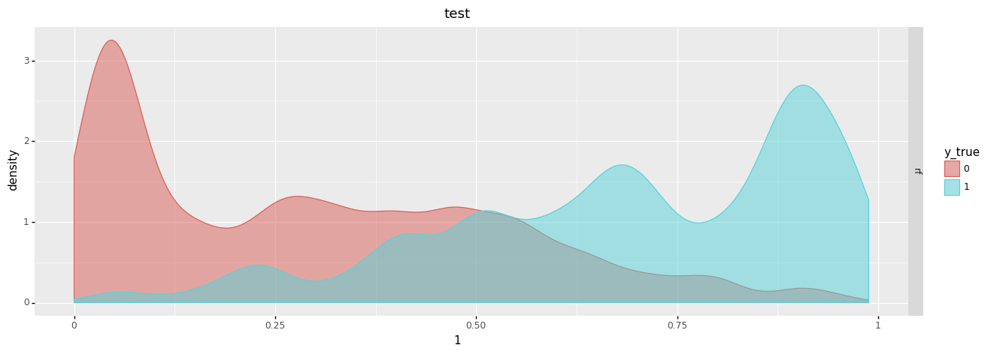

<ggplot: (-9223371917164730588)>

None

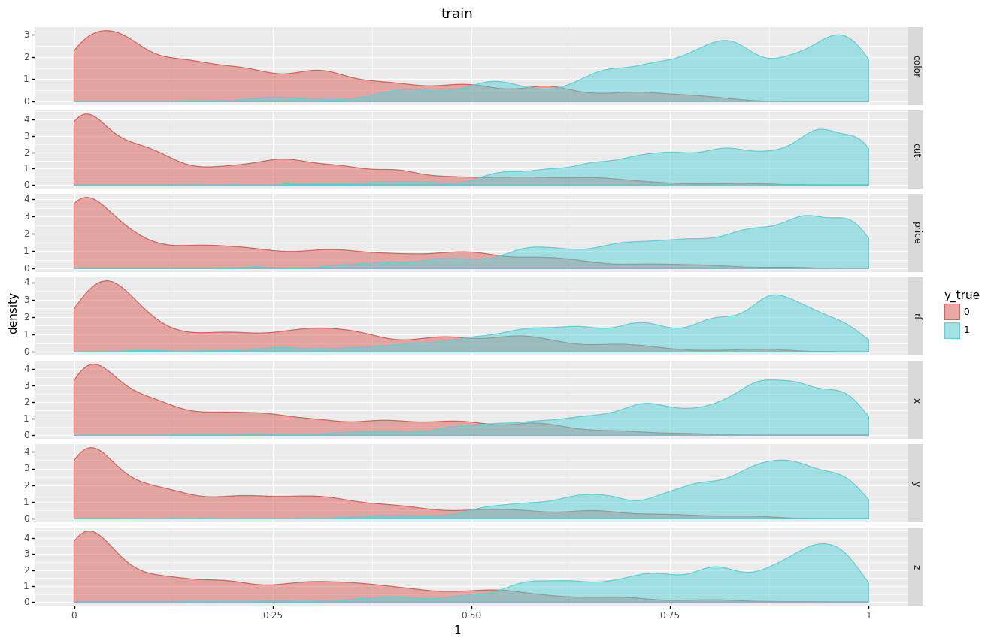

<ggplot: (-9223371917141547252)>

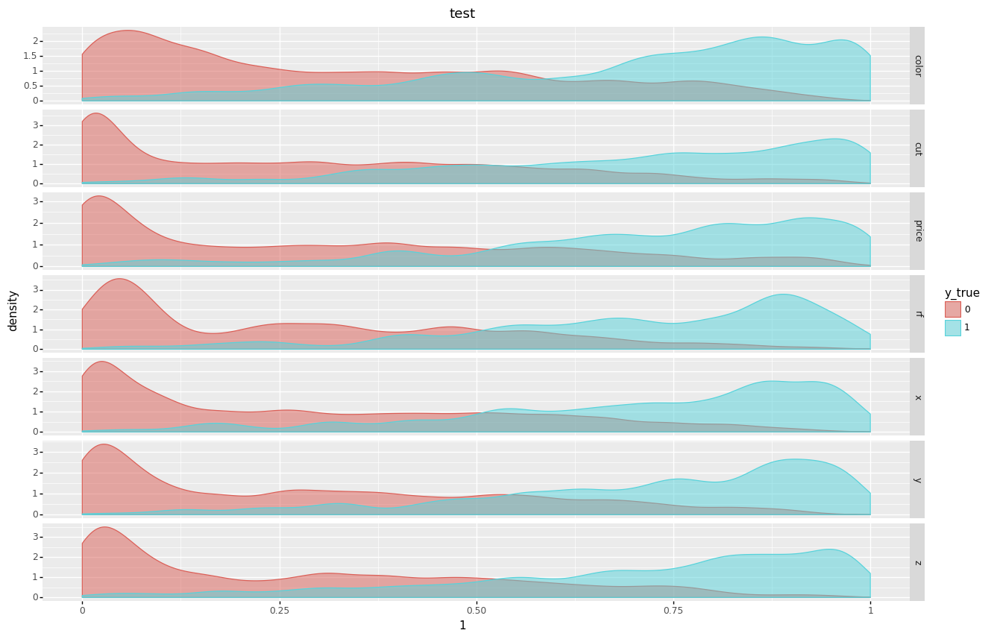

<ggplot: (-9223371917141526084)>

None

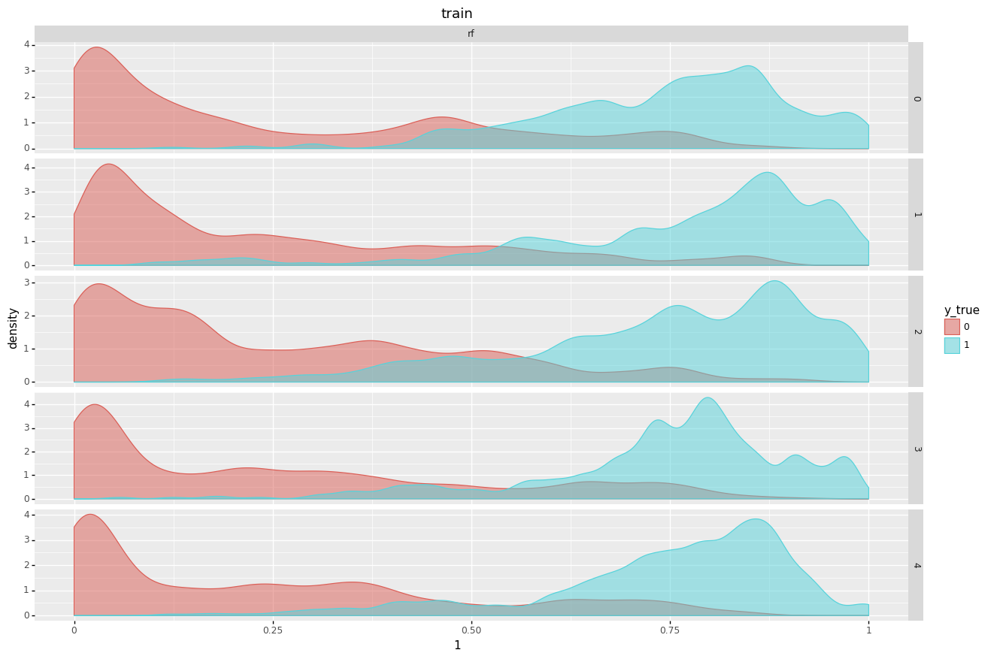

<ggplot: (-9223371917141437196)>

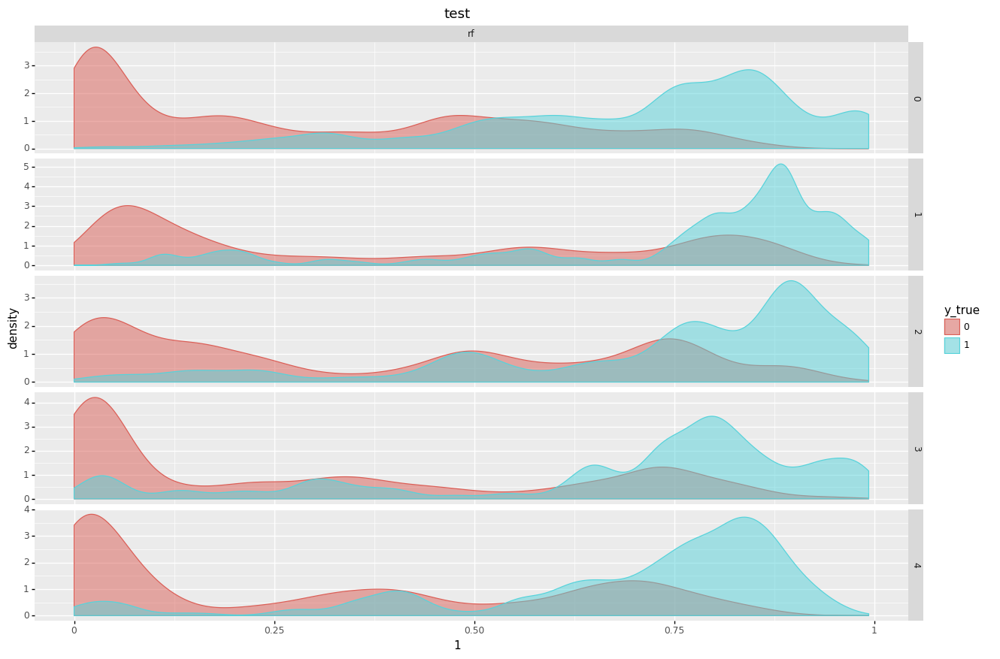

<ggplot: (-9223371917164684968)>

None

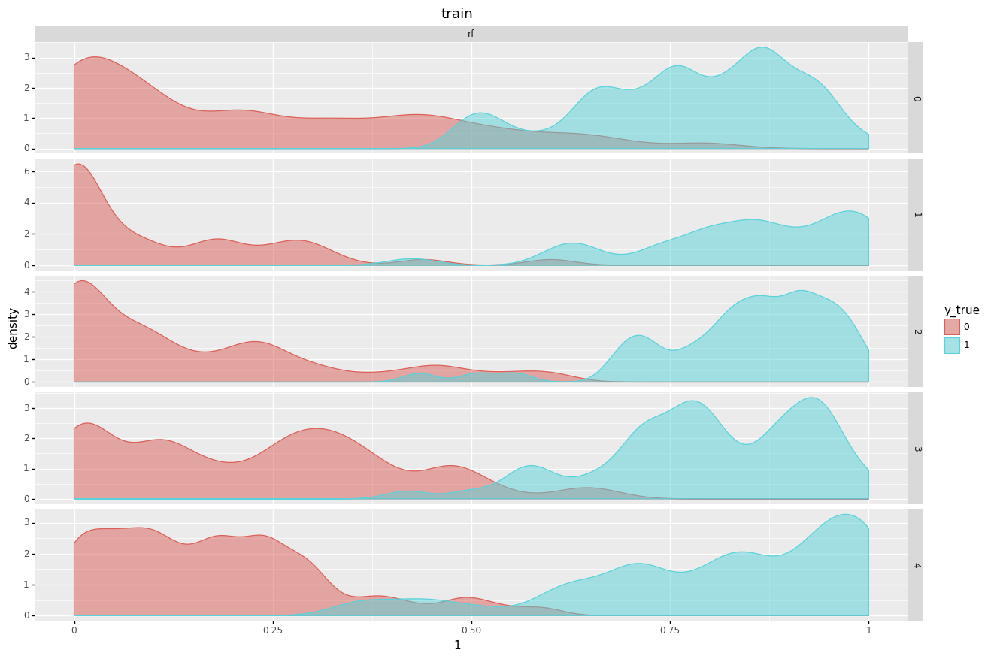

<ggplot: (-9223371917246057996)>

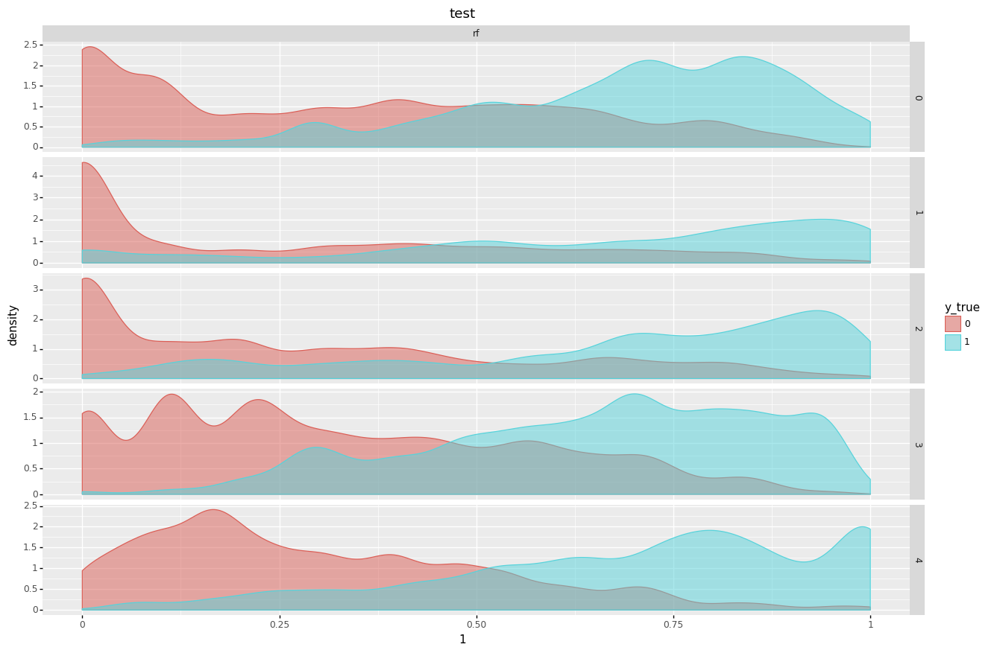

<ggplot: (-9223371917246060804)>

None

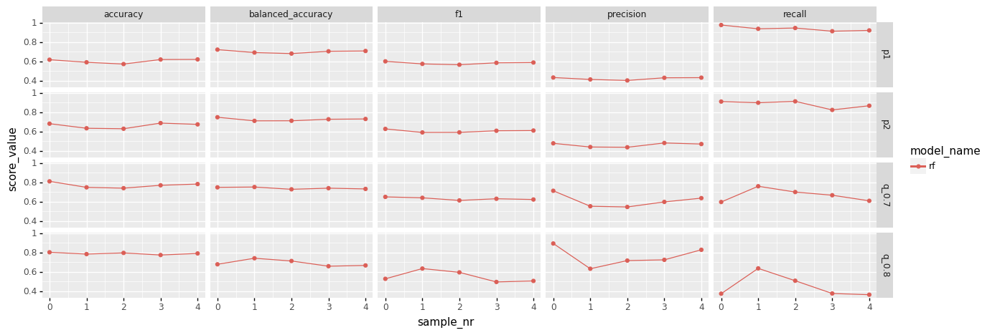

<ggplot: (-9223371917141510404)>

None

,model_name,set_type,sample_type,threshold_priori_id,score_name,max,min,mean,std
0,rf,test,cv,p1,accuracy,0.621,0.573,0.605,0.019
1,rf,test,cv,p1,balanced_accuracy,0.722,0.681,0.702,0.014
2,rf,test,cv,p1,f1,0.601,0.567,0.584,0.012
3,rf,test,cv,p1,precision,0.435,0.405,0.424,0.012
4,rf,test,cv,p1,recall,0.975,0.912,0.938,0.022
5,rf,test,cv,p2,accuracy,0.688,0.630,0.662,0.025
6,rf,test,cv,p2,balanced_accuracy,0.748,0.711,0.726,0.014
7,rf,test,cv,p2,f1,0.628,0.592,0.606,0.013
8,rf,test,cv,p2,precision,0.483,0.439,0.463,0.019
9,rf,test,cv,p2,recall,0.912,0.823,0.882,0.033


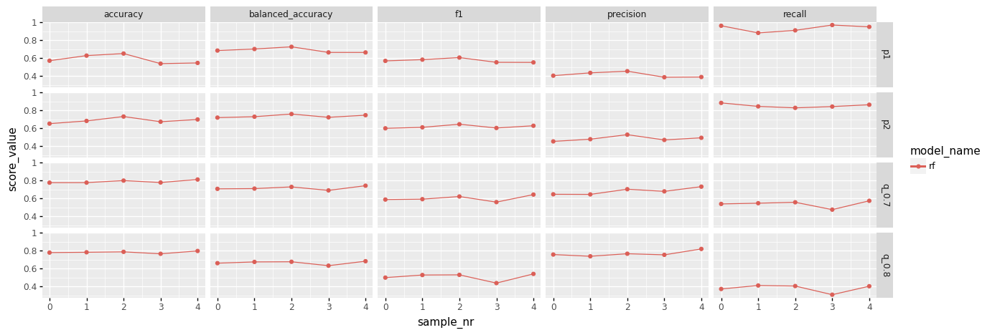

<ggplot: (-9223371917127540596)>

None

,model_name,set_type,sample_type,threshold_priori_id,score_name,max,min,mean,std
0,rf,test,hold,p1,accuracy,0.653,0.540,0.589,0.045
1,rf,test,hold,p1,balanced_accuracy,0.728,0.665,0.690,0.024
2,rf,test,hold,p1,f1,0.608,0.554,0.574,0.020
3,rf,test,hold,p1,precision,0.456,0.388,0.416,0.027
4,rf,test,hold,p1,recall,0.971,0.883,0.936,0.033
5,rf,test,hold,p2,accuracy,0.733,0.653,0.689,0.027
6,rf,test,hold,p2,balanced_accuracy,0.761,0.721,0.737,0.015
7,rf,test,hold,p2,f1,0.647,0.601,0.619,0.017
8,rf,test,hold,p2,precision,0.530,0.455,0.486,0.025
9,rf,test,hold,p2,recall,0.885,0.830,0.854,0.019


rf


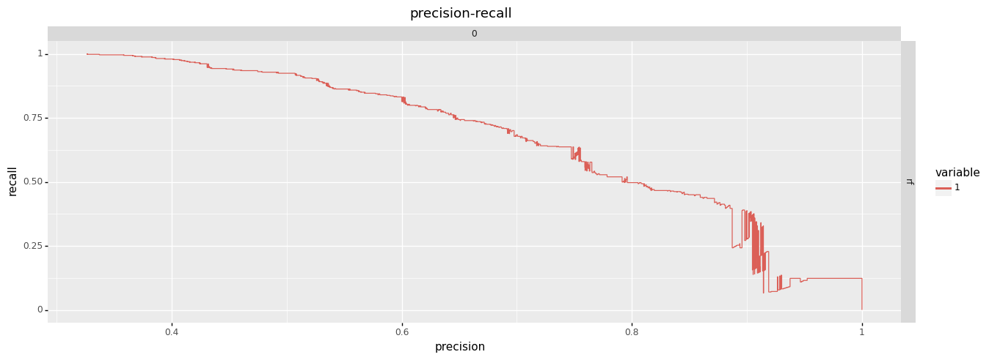

<ggplot: (-9223371917256201220)>

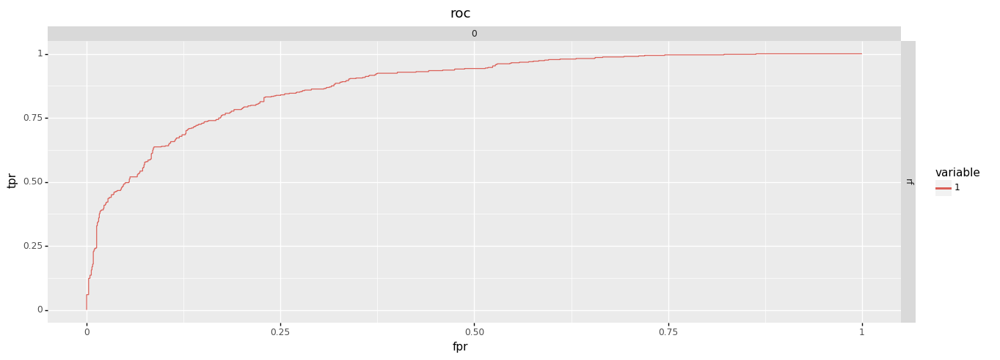

<ggplot: (-9223371917234156552)>

roc_auc
  model sample label  roc_auc
0   rf      0      1    0.880
average_precision
  model sample label  average_precision
0   rf      0      1              0.770
roc_auc stability
  model  mean  median   std
0   rf  0.880   0.880 0.000
average precision stability
  model  mean  median   std
0   rf  0.770   0.770 0.000


None

rf
price
x
y
z
color
cut


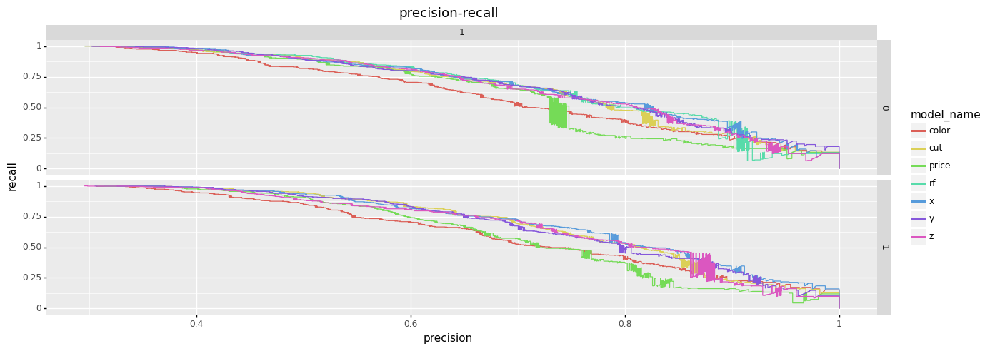

<ggplot: (-9223371917257350140)>

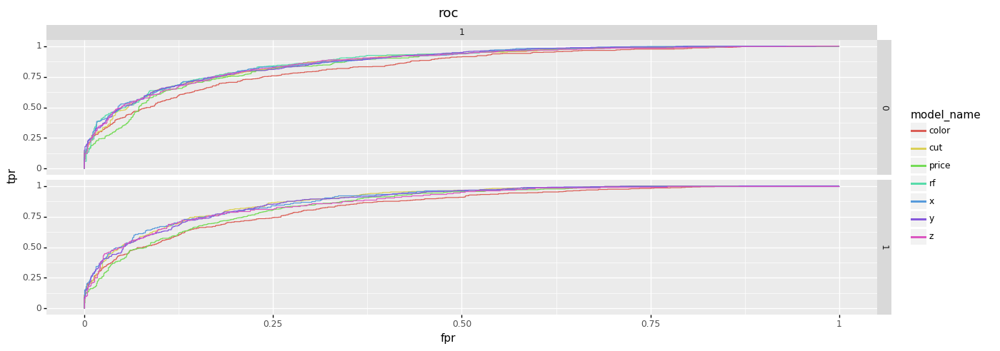

<ggplot: (-9223371917258697992)>

roc_auc
     model sample label  roc_auc
0      rf      0      1    0.880
1   price      0      1    0.858
2   price      1      1    0.859
3       x      0      1    0.877
4       x      1      1    0.889
5       y      0      1    0.875
6       y      1      1    0.884
7       z      0      1    0.871
8       z      1      1    0.876
9   color      0      1    0.834
10  color      1      1    0.840
11    cut      0      1    0.872
12    cut      1      1    0.888
average_precision
     model sample label  average_precision
0      rf      0      1              0.770
1   price      0      1              0.723
2   price      1      1              0.721
3       x      0      1              0.777
4       x      1      1              0.791
5       y      0      1              0.773
6       y      1      1              0.776
7       z      0      1              0.766
8       z      1      1              0.770
9   color      0      1              0.719
10  color      1      1              0.

None

rf


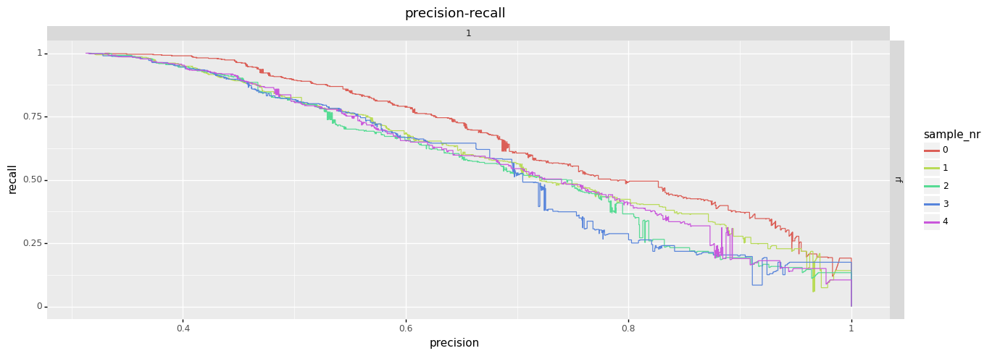

<ggplot: (-9223371917246972272)>

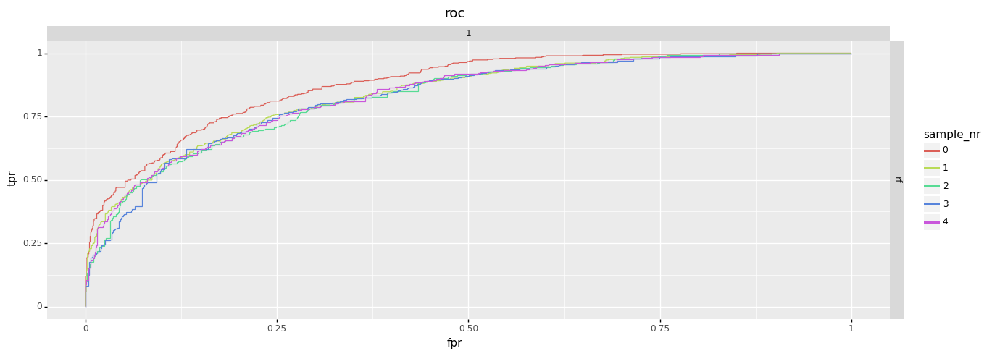

<ggplot: (-9223371917255928836)>

roc_auc
  model sample label  roc_auc
0   rf      0      1    0.875
1   rf      1      1    0.837
2   rf      2      1    0.829
3   rf      3      1    0.829
4   rf      4      1    0.834
average_precision
  model sample label  average_precision
0   rf      0      1              0.774
1   rf      1      1              0.725
2   rf      2      1              0.701
3   rf      3      1              0.693
4   rf      4      1              0.713
roc_auc stability
  model  mean  median   std
0   rf  0.841   0.834 0.017
average precision stability
  model  mean  median   std
0   rf  0.721   0.713 0.028


None

rf


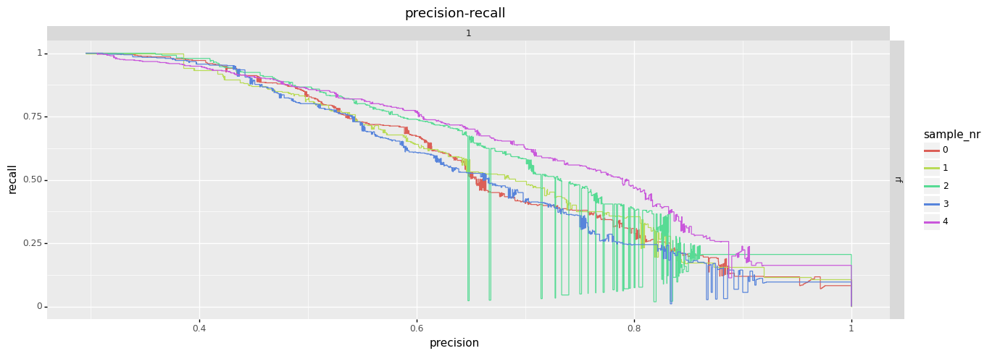

<ggplot: (-9223371917127345588)>

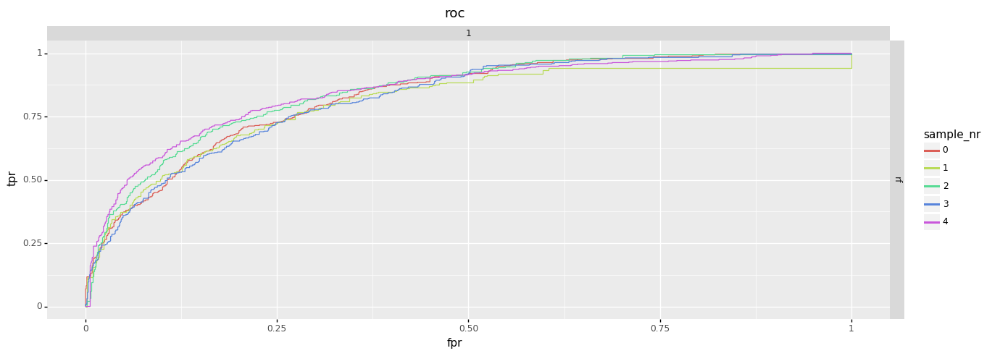

<ggplot: (-9223371917246968508)>

roc_auc
  model sample label  roc_auc
0   rf      0      1    0.829
1   rf      1      1    0.816
2   rf      2      1    0.850
3   rf      3      1    0.821
4   rf      4      1    0.849
average_precision
  model sample label  average_precision
0   rf      0      1              0.684
1   rf      1      1              0.677
2   rf      2      1              0.694
3   rf      3      1              0.663
4   rf      4      1              0.725
roc_auc stability
  model  mean  median   std
0   rf  0.833   0.829 0.014
average precision stability
  model  mean  median   std
0   rf  0.689   0.684 0.021


None

In [398]:
%run "modules/F_classification.py"
# PARAMETERS FOR 'LEARNING THE MODEL'
simulation_name        = 'symulacja_1' # unique simulation name
simulation_description = 'pierwszy model na wszyskich zmiennych' # simulation description
models_list            = {'rf':models_base['rf']} # dictionary with model we want to use. Elements selected from variable 'model_base'
cv_n                   = 5     # cross validation: number of k-folds ('None' if not to use)
hold_n                 = 5     # holdout validation: number of samples ('None' if not to use)
hold_train_sample_size = 0.1   # holdout validation: size of train set sample in percentage
hold_test_sample_size  = 0.1   # holdout validation: size of test set sample in percentage
fip_n                  = 2  # feature importatnce permutation validation:  number of samples ('None' if not to use. If we want to use it, it is recommended to provide value 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # feature importatnce permutation validation: prividing the model
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var ('None' if not to use ). Uwaga: ta zmienna nie będzie uwgdlęniona w statystykach (np. w korelacjach)
pos_label              = '1'   # which target lable use as a 'positive'
balancing_method       = 'under'  # class balancing method (currently available: 'over', 'under', 'None'). Warning: 'over' (over sampling) cause that we will loose data indicies information in train set.
calibration_method     = None # probability calibartion method (currently available: 'isotonic', 'None')
cat_encoding_method    = 'target' # features encoding algorithm (currently available: 'target', 'None')

# PARAMETERS FOR'PERFORMANCE'
thresholds_priori_list ={  'p1':[{'0':0.5, '1':0.5},{'0':0.2, '1':0.8}]
                         , 'p2':[{'0':0.3, '1':0.7},{'0':0.2, '1':0.8}]} # thresholds and priori probability for each target class (it we provide 'None' then instead of thresholds formula 'max(pd)' is used to assign the class)


# INITIALIZATION of new object for simulation (needed only in the first simulation - next simulation carry out with the same object to store all results in one place)
c1 = classification_model()

# MODEL LEARNING (determining only probabilities)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, fip_type = fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (obliczmy opcjolanie w oparciu o normalne thresholdy. Kwantyle się doliczą bo performenace jest naliczany narastająco dla danej symulacji)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )


# obecnie kwantyle są liczone tylko per model !!!!
quantiles_list = [0.7, 0.8]  # kwantyl jest liczony od dolu.
c1_1_q_map = c1.map_quantile_threshold(simulation_name = simulation_name, model_name = 'rf', label_to_map = '1', quantiles = quantiles_list, set_type = 'test', filter_test_indicies = None)
c1_1_q_map = [[{'0':1-i, pos_label:i}, None] for i in quantiles_list]
quantiles_list = ['q_' + str(i) for i in quantiles_list]
thresholds_priori_list = dict(zip(quantiles_list, c1_1_q_map))

c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )



# SAVING results on disk
# c1.save_results(path = r'C:\Users\memy\OneDrive\Pulpit\1_Programs_and_programing\DS_proj\classification_python\results\symulacja_1', override = True)

# LOADING results from disk (into empty object)
# c1.load_results(path = '...')

# RESULTS VISUALISATION
c1.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

# Grid search

'fd'

## Calculations

In [47]:
%run "modules/grid_search.py"

# variables
y_var = 'target'
x_var = ['price', 'x', 'y']


# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data[x_var], data[y_var], test_size=0.33)

# indicies reset
x_train    = x_train.reset_index(drop=True)
y_train    = y_train.reset_index(drop=True)
x_test    = x_test.reset_index(drop=True)
y_test    = y_test.reset_index(drop=True)

# converting target to 'str' type
y_train = y_train.astype(str)
y_test  = y_test.astype(str)

# thresholds list
thresholds_list = pd.DataFrame({'0':[0.2, 0.4]})
thresholds_list['1'] = 1 - thresholds_list['0']

# models list # Warning: list and range of parameters currently can be modified only in function code !!!!
methods_list = ['RF', 'AB'] # currently available: RF-random forest, AB-adata boost, GB-gradient boost, SVC-wektory nosne, NB-naive bayes, n_neighbors-KNN, XGB-xgboost, CAT-catboost, LGBM-lightgbm
priori = None
params_for_methods = {'RF':"""{
                'n_estimators': int(trial.suggest_uniform(name='n_estimators', low=5, high=1000))
                , 'max_depth': int(trial.suggest_uniform(name='max_depth', low=2, high=50))
                , 'criterion': trial.suggest_categorical('criterion', ['gini', 'entropy'])
                , 'bootstrap': trial.suggest_categorical('bootstrap', [True, False])
                , 'class_weight': trial.suggest_categorical('class_weight', ['balanced', 'balanced_subsample', None])
            }"""}

# number of iterations
n_trials = 2

# positive label (as 'int' !!! despite that the target is 'str' in data set)
pos_label = 1

# optimisation
direction    = "maximize"  # to minimize or to maximize objective function
opt_function = 'recall'    # objective function (dostepne: 'recall', 'precision', 'aps' (average_recall_precision), 'balanced_accuracy', 'accuracy')



# grid
trial_scores, trial_hyperparameters = grid_optuna_(methods_list    = methods_list
            ,direction       = direction
            ,opt_function    = opt_function
            ,thresholds_list = thresholds_list
            ,pos_label       = pos_label
            ,params_for_methods = None #  params_for_methods
            ,priori   = None
            ,n_trials = n_trials
            ,x_train  = x_train
            ,y_train  = y_train
            ,x_test   = x_test
            ,y_test   = y_test)


[I 2021-06-24 13:23:39,095] A new study created in memory with name: no-name-e9b978a2-857f-4cca-a149-ca45f006366d


['RF', 0]


[I 2021-06-24 13:23:40,980] Trial 0 finished with value: 0.467671366067088 and parameters: {'n_estimators': 240.19154841280493, 'max_depth': 28.652118532804913, 'criterion': 'gini', 'bootstrap': True, 'class_weight': None}. Best is trial 0 with value: 0.467671366067088.
[I 2021-06-24 13:23:42,402] Trial 1 finished with value: 0.4294279695349214 and parameters: {'n_estimators': 140.30801182939496, 'max_depth': 10.533135495982785, 'criterion': 'gini', 'bootstrap': False, 'class_weight': 'balanced_subsample'}. Best is trial 0 with value: 0.467671366067088.
[I 2021-06-24 13:23:42,499] A new study created in memory with name: no-name-d7d13a81-6dfd-4421-94c1-ff1e88778451


['RF', 1]


[I 2021-06-24 13:23:45,307] Trial 0 finished with value: 0.6233997731323935 and parameters: {'n_estimators': 276.26419955182035, 'max_depth': 49.32605478529284, 'criterion': 'entropy', 'bootstrap': False, 'class_weight': 'balanced_subsample'}. Best is trial 0 with value: 0.6233997731323935.
[I 2021-06-24 13:23:46,825] Trial 1 finished with value: 0.6031437368335764 and parameters: {'n_estimators': 59.61763879360121, 'max_depth': 32.78466835102366, 'criterion': 'entropy', 'bootstrap': True, 'class_weight': 'balanced_subsample'}. Best is trial 0 with value: 0.6233997731323935.
[I 2021-06-24 13:23:46,922] A new study created in memory with name: no-name-742d6b53-06c8-4147-907a-59be415bd808


['AB', 0]


[I 2021-06-24 13:23:54,120] Trial 0 finished with value: 0.0 and parameters: {'n_estimators': 132.45885345442426, 'learning_rate': 0.22733240009078742, 'algorithm': 'SAMME.R'}. Best is trial 0 with value: 0.0.
[I 2021-06-24 13:23:56,559] Trial 1 finished with value: 0.0 and parameters: {'n_estimators': 36.858083997685725, 'learning_rate': 0.12803313287457574, 'algorithm': 'SAMME.R'}. Best is trial 0 with value: 0.0.
[I 2021-06-24 13:23:56,656] A new study created in memory with name: no-name-5b23d9c9-b128-42b8-a1fc-40f59955dfa9


['AB', 1]


[I 2021-06-24 13:24:09,415] Trial 0 finished with value: 0.0 and parameters: {'n_estimators': 268.7129019533754, 'learning_rate': 0.0878564002115846, 'algorithm': 'SAMME'}. Best is trial 0 with value: 0.0.
[I 2021-06-24 13:24:22,265] Trial 1 finished with value: 0.0 and parameters: {'n_estimators': 243.17961863849234, 'learning_rate': 0.17745246353591532, 'algorithm': 'SAMME.R'}. Best is trial 0 with value: 0.0.


## Results visualisation

('AB', 0.2)


,duration,f1_overfit,params_algorithm,params_learning_rate,params_n_estimators,precision_overfit,recall_overfit,value
0,0 days 00:00:04.894655,NaN,SAMME.R,0.26,85.379,NaN,NaN,0.000
1,0 days 00:00:13.377603,NaN,SAMME,0.139,279.15,NaN,NaN,0.000
2,0 days 00:00:05.985876,NaN,SAMME,0.17,119.929,NaN,NaN,0.000
3,0 days 00:00:11.709260,NaN,SAMME.R,0.144,221.388,NaN,NaN,0.000
4,0 days 00:00:05.509237,NaN,SAMME.R,0.284,98.527,NaN,NaN,0.000
5,0 days 00:00:09.132533,NaN,SAMME,0.1,185.809,NaN,NaN,0.000
6,0 days 00:00:03.408725,NaN,SAMME.R,0.14,56.272,NaN,NaN,0.000
7,0 days 00:00:03.818903,NaN,SAMME.R,0.072,65.789,NaN,NaN,0.000
8,0 days 00:00:12.097273,NaN,SAMME,0.224,252.953,NaN,NaN,0.000
9,0 days 00:00:03.567822,NaN,SAMME.R,0.14,60.539,NaN,NaN,0.000


('AB', 0.4)


,duration,f1_overfit,params_algorithm,params_learning_rate,params_n_estimators,precision_overfit,recall_overfit,value
1,0 days 00:00:03.512307,-1.0,SAMME,0.255,64.393,-1.0,-1.0,0.000
3,0 days 00:00:05.466722,-1.0,SAMME,0.181,106.661,-1.0,-1.0,0.000
6,0 days 00:00:04.653082,-1.0,SAMME,0.295,89.083,-1.0,-1.0,0.000
0,0 days 00:00:15.580642,NaN,SAMME.R,0.24,296.53,NaN,NaN,0.000
2,0 days 00:00:04.037424,NaN,SAMME.R,0.181,69.192,NaN,NaN,0.000
4,0 days 00:00:04.790108,NaN,SAMME.R,0.19,83.693,NaN,NaN,0.000
5,0 days 00:00:11.638404,NaN,SAMME.R,0.292,216.701,NaN,NaN,0.000
7,0 days 00:00:10.299342,NaN,SAMME.R,0.277,192.541,NaN,NaN,0.000
8,0 days 00:00:02.872129,NaN,SAMME.R,0.28,46.121,NaN,NaN,0.000
9,0 days 00:00:03.433891,NaN,SAMME.R,0.083,57.729,NaN,NaN,0.000


('RF', 0.2)


,duration,f1_overfit,params_bootstrap,params_class_weight,params_criterion,params_max_depth,params_n_estimators,precision_overfit,recall_overfit,value
4,0 days 00:00:04.866969,0.64,False,balanced_subsample,gini,49.117,686.954,0.829,0.525,0.508
9,0 days 00:00:02.784693,0.638,False,balanced,gini,36.775,319.525,0.827,0.523,0.506
6,0 days 00:00:02.529614,0.752,True,balanced,gini,39.424,380.772,0.901,0.677,0.456
2,0 days 00:00:01.558398,0.747,True,balanced,gini,33.835,173.887,0.898,0.671,0.455
5,0 days 00:00:02.550640,0.748,True,balanced_subsample,gini,43.46,183.388,0.9,0.672,0.453
8,0 days 00:00:03.996553,0.873,False,balanced,gini,13.964,710.424,0.921,0.85,0.449
0,0 days 00:00:01.309105,0.829,False,None,entropy,16.492,95.578,0.928,0.785,0.408
3,0 days 00:00:01.920249,0.96,True,balanced,entropy,9.845,329.064,0.971,0.955,0.395
7,0 days 00:00:01.278405,0.959,False,None,gini,9.429,147.989,0.975,0.954,0.308
1,0 days 00:00:01.456363,0.969,False,balanced,entropy,4.379,273.861,0.976,0.969,0.052


('RF', 0.4)


,duration,f1_overfit,params_bootstrap,params_class_weight,params_criterion,params_max_depth,params_n_estimators,precision_overfit,recall_overfit,value
2,0 days 00:00:04.435051,0.98,True,balanced_subsample,gini,7.746,498.336,0.991,0.97,0.679
9,0 days 00:00:01.087592,0.98,False,balanced_subsample,entropy,7.816,77.063,0.991,0.969,0.678
1,0 days 00:00:01.948839,0.944,True,balanced,entropy,11.095,323.252,0.952,0.938,0.669
7,0 days 00:00:04.643917,0.945,True,balanced,entropy,11.625,973.172,0.952,0.938,0.667
4,0 days 00:00:01.182448,0.696,False,balanced_subsample,gini,21.952,45.358,0.773,0.632,0.618
6,0 days 00:00:02.590584,0.684,False,balanced,entropy,38.079,242.848,0.764,0.618,0.614
0,0 days 00:00:03.500117,0.768,True,balanced,gini,18.484,618.654,0.825,0.726,0.611
8,0 days 00:00:10.005661,0.692,True,balanced_subsample,gini,44.881,909.427,0.803,0.609,0.594
5,0 days 00:00:06.812074,0.692,True,balanced_subsample,gini,47.297,624.079,0.807,0.607,0.592
3,0 days 00:00:04.928726,0.888,False,None,entropy,13.358,834.389,0.902,0.88,0.530


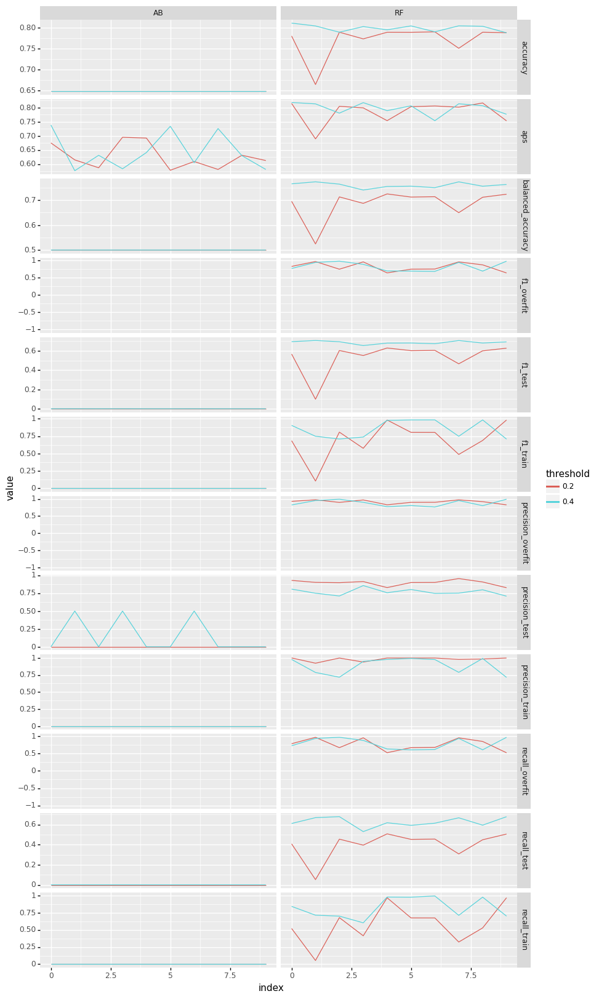

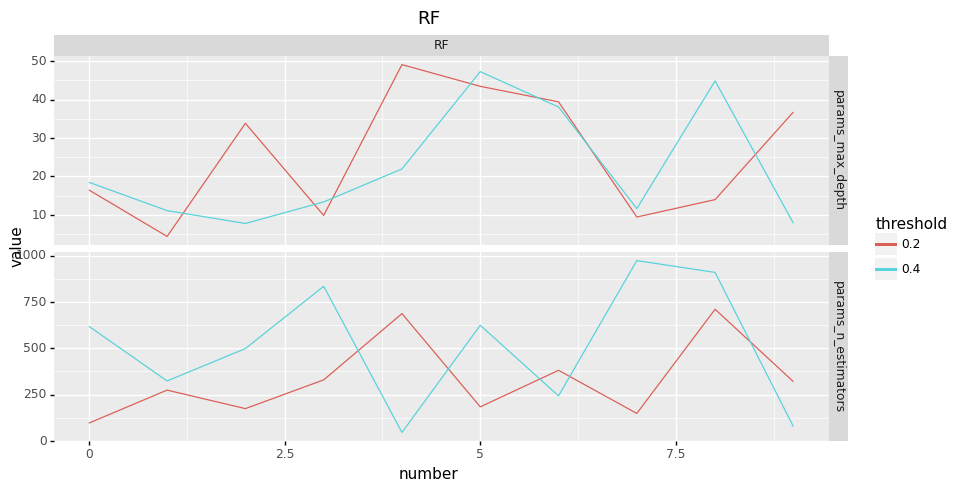

In [44]:
# tabele z wartosciami hiperparametrow (w kolumnie 'value' jest wartosc funkcji celu)    
grid_optuna_hyperparameters_tables(trial_hyperparameters)

# wykres parametrow oceniajacych dopasownaie po modelach i punktach odciecia
grid_optuna_scores_plot(trial_scores, fig_w = 10, fig_h = 20)

# wykres wartosci KONRETNYCH hiperparametrow dla KONRETNEGO modelu po roznych punktach odciecia
plotnine.options.figure_size = (20, 10) # width, hight
grid_optuna_hyperparameters_plot(trial_hyperparameters, params_to_print = ['n_estimators', 'max_depth'], method = 'RF')


# Code tests

In [494]:

# zmienne
y_var = ['target_multi_label']         # zmienna objasniana (wilostanowa)
x_var_num = ['price', 'x', 'y', 'z']  # zmienne objasniajace numeryczne
x_var_cat = ['color','clarity'] # zmienne objasniajace kategoryczne
x_var = x_var_num + x_var_cat         # wszystkie zmienne objasniajace

data1 = data.iloc[1:3000,:] 

#losowanie pomieszanie wierszy i reset indeksow (bez pomieszania mogę wystapic problemy przy walidacji krzyzowej jezeli target nie jest losow rorzucony)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# podzial na zbioru 'data' na train i test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# umieszczenie w jednym zbiorze zmiennych objasniajacych i zmiennej objasnianej
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# zamiana zmiennej objasnianej na typ 'str'
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [495]:
%run "draft/F_classification_draft.py"
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_1' # unikalna nazwa symulacji
simulation_description = 'pierwszy model na wszyskich zmiennych' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 3     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 2     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None#'clarity' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # dla modeli wieloklasowych niedostepne
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# PARAMETRY DLA 'PERFORMANCE' (dla zagadnienie wialostanowego nie ma thresholdow. Jest tylko wazenie priori gdzie wagu sumuja sie do wartosci 1)
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# INICJALIZACJA nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# ZAPISANIE wynikow na dysk
# c1.save_results(path = r'C:\Users\memy\OneDrive\Pulpit\1_Programs_and_programing\DS_proj\classification_python\results\symulacja_1', override = True)

# # LADOWANIE z dysku do zainicjowanego wczeniej pustego obiektu
# # c1.load_results(path = '...')

# # WIZUALIZACJA
# c1.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

(2009, 7)
(990, 7)
1339
670
1339
670
1340
669
1339
670
1339
670
1340
669


## Probabilities

In [496]:
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='test')].shape

h('cv')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='test')].shape

h('hold')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='test')].shape

h('by_var')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='test')].shape

h('fip')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='test')].shape






(2999, 13)

(2009, 7)

(990, 7)

(5998, 13)

(4018, 13)

(1980, 13)

(17994, 13)

(8036, 13)

(4018, 13)

(5940, 13)

(5564, 13)

(800, 13)

(804, 13)

(3960, 13)

(0, 13)

(0, 13)

(0, 13)

(0, 13)

(17994, 13)

(6024, 13)

(6030, 13)

(5940, 13)

In [481]:
simulation_name = 'symulacja_2'



h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='test')].shape

h('cv')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='test')].shape

h('hold')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='test')].shape

h('by_var')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='test')].shape

h('fip')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='test')].shape





(2999, 13)

(2009, 7)

(990, 7)

(5998, 13)

(4018, 13)

(1980, 13)

(11996, 13)

(4018, 13)

(4018, 13)

(3960, 13)

(5564, 13)

(800, 13)

(804, 13)

(3960, 13)

(21838, 13)

(4018, 13)

(1980, 13)

(15840, 13)

(14995, 13)

(5020, 13)

(5025, 13)

(4950, 13)

## Classification

In [388]:
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='test')].shape

h('cv')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='test')].shape

h('hold')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='test')].shape

h('by_var')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='test')].shape

h('fip')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='test')].shape

(4999, 13)

(3349, 7)

(1650, 7)

(29994, 11)

(20094, 11)

(9900, 11)

(39992, 11)

(13396, 11)

(13396, 11)

(13200, 11)

(18552, 11)

(2672, 11)

(2680, 11)

(13200, 11)

(72796, 11)

(13396, 11)

(6600, 11)

(52800, 11)

(74985, 11)

(25110, 11)

(25125, 11)

(24750, 11)

In [389]:
simulation_name = 'symulacja_2'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='test')].shape

h('cv')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='test')].shape

h('hold')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='test')].shape

h('by_var')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='test')].shape

h('fip')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='test')].shape

(4999, 13)

(3349, 7)

(1650, 7)

(29994, 11)

(20094, 11)

(9900, 11)

(39992, 11)

(13396, 11)

(13396, 11)

(13200, 11)

(18552, 11)

(2672, 11)

(2680, 11)

(13200, 11)

(72796, 11)

(13396, 11)

(6600, 11)

(52800, 11)

(74985, 11)

(25110, 11)

(25125, 11)

(24750, 11)

## Scores

In [430]:
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='test')].shape

h('cv')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='test')].shape

h('hold')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='test')].shape

h('by_var')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='test')].shape

h('fip')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='test')].shape

(999, 13)

(669, 7)

(330, 7)

(40, 10)

(20, 10)

(20, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(480, 10)

(160, 10)

(160, 10)

(160, 10)

(150, 10)

(50, 10)

(50, 10)

(50, 10)

In [443]:
simulation_name = 'symulacja_2'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='test')].shape

h('cv')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='test')].shape

h('hold')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='test')].shape

h('by_var')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='test')].shape

h('fip')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='test')].shape

(999, 13)

(669, 7)

(330, 7)

(40, 10)

(20, 10)

(20, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(480, 10)

(160, 10)

(160, 10)

(160, 10)

(150, 10)

(50, 10)

(50, 10)

(50, 10)

## Confusion matrix

In [497]:
    
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='test')].shape

h('cv')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='test')].shape

h('hold')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='test')].shape

h('by_var')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='test')].shape

h('fip')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='test')].shape


(2999, 13)

(2009, 7)

(990, 7)

(8, 33)

(4, 33)

(4, 33)

(36, 33)

(12, 33)

(12, 33)

(12, 33)

(24, 33)

(8, 33)

(8, 33)

(8, 33)

(0, 33)

(0, 33)

(0, 33)

(0, 33)

(36, 33)

(12, 33)

(12, 33)

(12, 33)

In [482]:
    
simulation_name = 'symulacja_2'


h('full')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='test')].shape

h('cv')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='test')].shape

h('hold')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='test')].shape

h('by_var')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='test')].shape

h('fip')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='test')].shape


(8, 33)

(4, 33)

(4, 33)

(24, 33)

(8, 33)

(8, 33)

(8, 33)

(24, 33)

(8, 33)

(8, 33)

(8, 33)

(96, 33)

(32, 33)

(32, 33)

(32, 33)

(30, 33)

(10, 33)

(10, 33)

(10, 33)

In [ ]:
# c1.scores[c1.scores['sample_type']=='fip']



# def scores_determining(self, y_true, y_pred, pos_label = 1):


y_true=c1.classification.loc[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train'), 'y_true']
y_pred=c1.classification.loc[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train'), 'y_pred']
    
pos_label = 1
    
"""
calculation scores for models predictions. Scores are not saved here. It is done in f:performance
"""

# accuracy
try:
    accuracy = skm.accuracy_score(y_true = y_true, y_pred = y_pred )
except:
    accuracy = np.nan


# balanced accuracy
try:
    balanced_accuracy = skm.balanced_accuracy_score(y_true = y_true, y_pred = y_pred)
except:
    balanced_accuracy = np.nan


# recall
try:
  if len(self.y_labels) < 3:
    recall  = skm.recall_score(y_true = y_true.astype(int), y_pred = y_pred.astype(int), average = 'binary', pos_label = int(pos_label))
  else:
    recall = skm.recall_score(y_true = y_true.astype(str), y_pred = y_pred.astype(str), average = 'weighted')
except:
    recall = np.nan



# precision
try:
  if len(self.y_labels) < 3:
    precision  = skm.precision_score(y_true = y_true.astype(int), y_pred = y_pred.astype(int), average = 'binary', pos_label = int(pos_label))
  else:
    precision = skm.precision_score(y_true = y_true.astype(str), y_pred = y_pred.astype(str), average = 'weighted')
except:
    precision = np.nan

# f1
try:
  if len(self.y_labels) < 3:
    f1 = skm.f1_score(y_true = y_true, y_pred = y_pred, average = 'binary', pos_label = str(pos_label))
  else:
    f1 = skm.f1_score(y_true = y_true, y_pred = y_pred, average = 'weighted')
except:
  f1 = np.nan

# putting all scores into Dataframe
scores = pd.DataFrame({'score_name' :['accuracy','balanced_accuracy', 'recall', 'precision', 'f1'], 
                       'score_value':[ accuracy , balanced_accuracy ,  recall ,  precision ,  f1]})



## performance

In [440]:


simulation_name='symulacja_2'
threshold_priori_id = 'p1'

cls = c1.classification.loc[(c1.classification['simulation_name']==simulation_name) & (c1.classification['threshold_priori_id']==threshold_priori_id), : ]


# indicies filter for test set
if filter_test_indicies is not None:
  cls_other = cls[cls['set_type']!='test']
  cls_test  = cls[cls['set_type']=='test'] 
  cls_test = cls_test[cls_test['index'].isin(filter_test_indicies)]

  cls = pd.concat([cls_other, cls_test], axis = 0)

cls = cls.drop(columns='index') # nie potrzebujemy indeksu

# data grouping with classification decision
group_structure = ['simulation_name', 'model_name', 'set_type', 'sample_type', 'sample_nr', 'sample_name',  'if_automatic', 'threshold_priori_id']
gr = cls.groupby(group_structure)

# empty matrices to collect results
scores = pd.DataFrame()
confusion_matrix = pd.DataFrame()

# loop over groups
for name, group in gr:

    # printing progress of the loop
    print(name)

('symulacja_2', 'ab', 'test', 'by_var', 0, 'I1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 1, 'IF', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 2, 'SI1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 3, 'SI2', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 4, 'VS1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 5, 'VS2', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 6, 'VVS1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 7, 'VVS2', 0, 'p1')
('symulacja_2', 'ab', 'test', 'cv', 0, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'cv', 1, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'full', 0, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'hold', 0, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'hold', 1, '_', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 0, 'I1', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 1, 'IF', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 2, 'SI1', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 3, 'SI2', 0, 'p1')
('symulacja_2', 'ab

In [1]:
import pandas as pd
import plotly.graph_objects as go

df = pd.read_csv('https://raw.githubusercontent.com/vyaduvanshi/helper-files/master/parallel_coordinates.csv')
group_vars = df['country'].unique()
dfg = pd.DataFrame({'country':df['country'].unique()})
dfg['dummy'] = dfg.index
df = pd.merge(df, dfg, on = 'country', how='left')


dimensions = list([dict(range=[df['gm_Retail & Recreation'].min(),df['gm_Retail & Recreation'].max()],
                        label='Retail & Recreation', values=df['gm_Retail & Recreation']),
                  dict(range=[df['gm_Grocery & Pharmacy'].min(),df['gm_Grocery & Pharmacy'].max()],
                       label='Grocery & Pharmacy', values=df['gm_Grocery & Pharmacy']),
                  dict(range=[df['gm_Parks'].min(),df['gm_Parks'].max()],
                       label='Parks', values=df['gm_Parks']),
                  dict(range=[df['gm_Transit Stations'].min(),df['gm_Transit Stations'].max()],
                       label='Transit Stations', values=df['gm_Transit Stations']),
                  dict(range=[df['gm_Workplaces'].min(),df['gm_Workplaces'].max()],
                       label='Workplaces', values=df['gm_Workplaces']),
                  dict(range=[df['gm_Residential'].min(),df['gm_Residential'].max()],
                       label='Residential', values=df['gm_Residential']),
                   
                  dict(range=[0,df['dummy'].max()],
                       tickvals = dfg['dummy'], ticktext = dfg['country'],
                       label='Country', values=df['dummy']),
                  
                  ])

fig = go.Figure(data=go.Parcoords(line = dict(color = df['dummy'],
                   colorscale = [[0,'rgba(200,0,0,0.1)'],[0.5,'rgba(0,200,0,0.1)'],[1,'rgba(0,0,200,0.1)']]), dimensions=dimensions))
fig.show()

# Dustbin

,feature,VIF
0,x,9752.247
1,y,8611.514
2,price,2.772
3,z,982.514


In [354]:
cat_vars = ['cut','color']

encode = ce.TargetEncoder(cols = cat_vars  )  
    
encode.fit(X=data[cat_vars], y=data['target'])
# transforming train data set with encoded values
data_encoded_train = encode.transform(X=data[cat_vars], y=data['target'])

data_encoded_train

TargetEncoder(cols=['cut', 'color'])

,cut,color
0,0.439,0.315
1,0.269,0.315
2,0.243,0.315
3,0.269,0.337
4,0.243,0.284
...,...,...
53935,0.439,0.234
53936,0.243,0.234
53937,0.337,0.234
53938,0.269,0.320
